In [1]:
import os
import pickle
import warnings
warnings.filterwarnings('ignore')

In [2]:
!pip install scikit-optimize
!pip install plotly


In [3]:

import itertools
import time
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.figure_factory as ff
import plotly.offline as pyo
pyo.init_notebook_mode()
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.preprocessing import StandardScaler, MinMaxScaler, PolynomialFeatures
from sklearn.experimental import enable_halving_search_cv 
from sklearn.model_selection import train_test_split, learning_curve, GridSearchCV, \
KFold, RandomizedSearchCV, HalvingGridSearchCV, HalvingRandomSearchCV 


from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from pandas.api.types import is_numeric_dtype
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.metrics import accuracy_score, recall_score, precision_score, \
f1_score, classification_report, confusion_matrix, roc_curve

from sklearn import tree
from sklearn.tree import DecisionTreeClassifier

from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier, \
RandomForestClassifier, ExtraTreesClassifier
from sklearn.inspection import permutation_importance

from sklearn.pipeline import Pipeline
from sklearn.base import clone
from itertools import product
from collections import OrderedDict



In [4]:
!pip install mlxtend
from mlxtend.plotting import plot_decision_regions

In [5]:
!pip install shap
import shap

In [6]:
# Analyisng Data

oasis2_demo = pd.read_csv('oasis_longitudinal_demographics.csv')

oasis2_demo.head()

,Subject ID,MRI ID,Group,Visit,MR Delay,M/F,Hand,Age,EDUC,SES,MMSE,CDR,eTIV,nWBV,ASF
0,OAS2_0001,OAS2_0001_MR1,Nondemented,1,0,M,R,87,14,2.0,27.0,0.0,1987,0.696,0.883
1,OAS2_0001,OAS2_0001_MR2,Nondemented,2,457,M,R,88,14,2.0,30.0,0.0,2004,0.681,0.876
2,OAS2_0002,OAS2_0002_MR1,Demented,1,0,M,R,75,12,NaN,23.0,0.5,1678,0.736,1.046
3,OAS2_0002,OAS2_0002_MR2,Demented,2,560,M,R,76,12,NaN,28.0,0.5,1738,0.713,1.010
4,OAS2_0002,OAS2_0002_MR3,Demented,3,1895,M,R,80,12,NaN,22.0,0.5,1698,0.701,1.034


In [7]:
# Checking for null values

null_df = pd.DataFrame({'column' : (oasis2_demo.isna().sum()*100/oasis2_demo.shape[0]).index, 'percent_null' : (oasis2_demo.isna().sum()*100/oasis2_demo.shape[0]).values})
null_df


,column,percent_null
0,Subject ID,0.000000
1,MRI ID,0.000000
2,Group,0.000000
3,Visit,0.000000
4,MR Delay,0.000000
5,M/F,0.000000
6,Hand,0.000000
7,Age,0.000000
8,EDUC,0.000000
9,SES,5.093834


* Ses column has 5% missing data
* MMSE column has 0.5% missing data

In [8]:
print(f'Unique value(s) in "SES": {oasis2_demo["SES"].unique()}')

Unique value(s) in "SES": [ 2. nan  3.  4.  1.  5.]


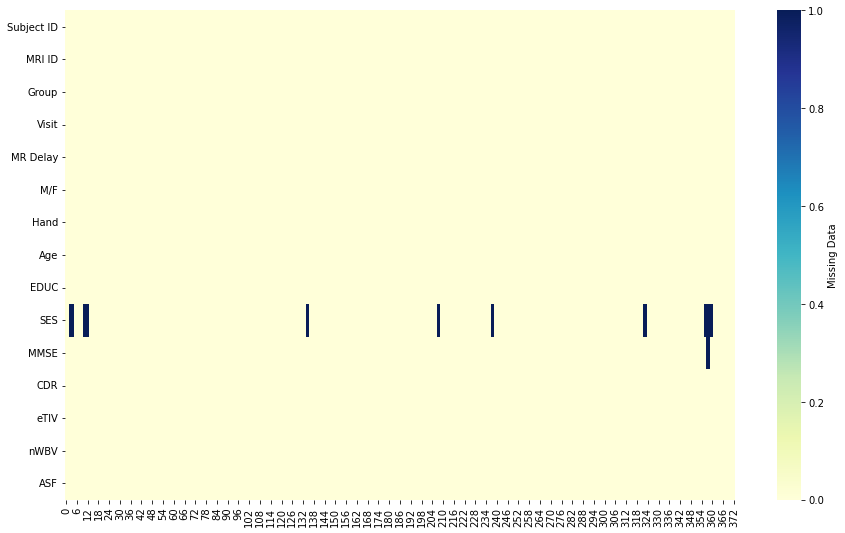

In [9]:
# plot a heatmap of missing values
fig, ax = plt.subplots(figsize=(15,9)) #increase figsize to make searching pattern easier 
sns.heatmap(oasis2_demo.isna().transpose(),
            cmap="YlGnBu",
            cbar_kws={'label': 'Missing Data'},
            ax = ax)
plt.show()


In [10]:
oasis2_demo['SES'].fillna(round(oasis2_demo['SES'].mean()), inplace=True)
oasis2_demo['MMSE'].fillna(round(oasis2_demo['MMSE'].mean()), inplace=True)
oasis2_demo.isna().sum()


oasis_cols = [c for c in oasis2_demo.columns]
target_col = 'Group'
for i, c in enumerate(oasis_cols):
    if is_numeric_dtype(oasis2_demo[c]) and (oasis2_demo[c].nunique() > 5):
        pass
    else:
        oasis2_demo[c] = oasis2_demo[c].astype('category')
    
            
    


fig = make_subplots(rows=len(oasis_cols), cols=2, specs = \
    list([[{"type":"table"}, {"type":"bar"}] if \
    oasis2_demo[oasis_cols[n]].dtype.name == 'category' else [{"type":"table"}, \
    {"type":"scatter"}] for n in range(len(oasis_cols))]), subplot_titles = \
    list(itertools.chain(*zip(oasis_cols, ['plot']*len(oasis_cols)))))
for i, c in enumerate(oasis_cols):
    if is_numeric_dtype(oasis2_demo[c]) and (oasis2_demo[c].nunique() > 5):
        col_table = oasis2_demo[c].describe()
        desc_df = pd.DataFrame({ 'stats' : col_table.index, 'value' : col_table.values})
        fig = fig.add_trace(go.Table(cells={"values":desc_df.T.values}, header={"values":desc_df.columns}), row=i+1,col=1)
        fig.add_trace(px.scatter(oasis2_demo, y= c, x=target_col).data[0], row=i+1, col=2)


    elif c != target_col:
        oasis2_demo[c] = oasis2_demo[c].astype('category')
        col_table = oasis2_demo[c].describe()
        desc_df = pd.DataFrame({ 'stats' : col_table.index, 'value' : col_table.values})
        df = oasis2_demo.groupby([c, target_col]).size().reset_index(name="counts")
        fig = fig.add_trace(go.Table(cells={"values":desc_df.T.values}, header={"values":desc_df.columns}), row=i+1,col=1)
        fig.add_trace(px.bar(df, y= "counts", x=c).data[0], row=i+1, col=2)
        fig.update_layout(title_text='Your title', title_x=0.5)
    
    else:
        oasis2_demo[c] = oasis2_demo[c].astype('category')
        col_table = oasis2_demo[c].describe()
        desc_df = pd.DataFrame({ 'stats' : col_table.index, 'value' : col_table.values})
        df = oasis2_demo.groupby(c).size().reset_index(name="counts")
        fig = fig.add_trace(go.Table(cells={"values":desc_df.T.values}, header={"values":desc_df.columns}), row=i+1,col=1)
        fig.add_trace(px.bar(df, y= "counts", x=c).data[0], row=i+1, col=2)
        
fig.update_layout(
    title_text='Analyising Oasis2 dataset',
    title_x=0.5,
    autosize=False,
    width=1000,
    height=4500)
pyo.iplot(fig, filename = 'col_plot')

## Observations

* Column "Subject ID" and "MRI ID" contains random lables which will increase the noise in the data so the must be discarded
* Column "Hand" contains only one unique value hence should be removed
* Target variable group contains class imbalemnce 
* We could remove this imbalence by converting it into binary classification problem (by grouping converted with demented)

In [11]:
# Removing "MRI ID", "Subject ID", "Hand"
oasis2_demo.drop(columns = ["MRI ID", "Subject ID", "Hand"], inplace = True)
print(f"First few rows of the dataframe: \n{oasis2_demo.head()}", '\n')
print(f"shape of the dataframe: {oasis2_demo.shape}")

First few rows of the dataframe: 
         Group Visit  MR Delay M/F  Age  EDUC  SES  MMSE  CDR  eTIV   nWBV  \
0  Nondemented     1         0   M   87    14  2.0  27.0  0.0  1987  0.696   
1  Nondemented     2       457   M   88    14  2.0  30.0  0.0  2004  0.681   
2     Demented     1         0   M   75    12  2.0  23.0  0.5  1678  0.736   
3     Demented     2       560   M   76    12  2.0  28.0  0.5  1738  0.713   
4     Demented     3      1895   M   80    12  2.0  22.0  0.5  1698  0.701   

     ASF  
0  0.883  
1  0.876  
2  1.046  
3  1.010  
4  1.034   

shape of the dataframe: (373, 12)


In [12]:
# checking correlation between variables

corr = oasis2_demo.corr().round(3)
mask = np.triu(np.ones_like(corr, dtype=bool))
corr_mask = corr.mask(mask)

fig = ff.create_annotated_heatmap(z=corr_mask.to_numpy(), 
                                  x=corr_mask.columns.tolist(),
                                  y=corr_mask.columns.tolist(),
                                  colorscale="Viridis",
                                  hoverinfo="none", #Shows hoverinfo for null values
                                  showscale=True, ygap=1, xgap=1
                                 )

fig.update_xaxes(side="bottom")

fig.update_layout(
    title_text='Heatmap',
    title_x=0.5, 
    width=1000, 
    height=1000,
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_zeroline=False,
    yaxis_zeroline=False,
    yaxis_autorange='reversed',
    template='plotly_white'
)

fig['layout']['title']['font'] = dict(size=30)

for i in range(len(fig.layout.annotations)):
    if fig.layout.annotations[i].text == 'nan':
        fig.layout.annotations[i].text = ""

fig.show()

* "eTiv" and "ASF" are highly correlated (negatively) so dropping one of them would work
* "nWBV" and "Age" have considarable correlation (negative) between them

In [13]:
# Dropping "eTIV" from our dataset
oasis2_demo.drop(columns = ["eTIV"], inplace = True)
print(f"Dataset shape: {oasis2_demo.shape}")

Dataset shape: (373, 11)


# Preprocessing

In [14]:
#check the dataframe columns:
oasis2_demo.info()

cat_df = oasis2_demo.select_dtypes(include = "category")
cat_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 373 entries, 0 to 372
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   Group     373 non-null    category
 1   Visit     373 non-null    category
 2   MR Delay  373 non-null    int64   
 3   M/F       373 non-null    category
 4   Age       373 non-null    int64   
 5   EDUC      373 non-null    int64   
 6   SES       373 non-null    category
 7   MMSE      373 non-null    float64 
 8   CDR       373 non-null    category
 9   nWBV      373 non-null    float64 
 10  ASF       373 non-null    float64 
dtypes: category(5), float64(3), int64(3)
memory usage: 20.3 KB


,Group,Visit,M/F,SES,CDR
0,Nondemented,1,M,2.0,0.0
1,Nondemented,2,M,2.0,0.0
2,Demented,1,M,2.0,0.5
3,Demented,2,M,2.0,0.5
4,Demented,3,M,2.0,0.5




* "M/F" needs to be dropped
* class 'converted' of column "Group" needs to be changed to demented
* "Group" should then be binary encoded

In [15]:
# Encode "Group" and "M/F"
oasis2_demo = pd.get_dummies(oasis2_demo, columns = ["M/F"], prefix = "Sex", drop_first = True)
oasis2_demo["Group"] = oasis2_demo["Group"].apply(lambda x: 0 if x == "Nondemented" else 1)

In [16]:
#Print the first few rows
print(oasis2_demo.head())

   Group Visit  MR Delay  Age  EDUC  SES  MMSE  CDR   nWBV    ASF  Sex_M
0      0     1         0   87    14  2.0  27.0  0.0  0.696  0.883      1
1      0     2       457   88    14  2.0  30.0  0.0  0.681  0.876      1
2      1     1         0   75    12  2.0  23.0  0.5  0.736  1.046      1
3      1     2       560   76    12  2.0  28.0  0.5  0.713  1.010      1
4      1     3      1895   80    12  2.0  22.0  0.5  0.701  1.034      1


In [17]:
# Define a random state 
rs = 42

In [18]:
# Split target and predictor variables
X_arr = oasis2_demo.drop(columns = ["Group"])
y_arr = oasis2_demo["Group"]

In [19]:
# Print shape of the arrays
print(f"Shape of predictor array: {X_arr.shape}")
print(f"Shape of target array: {y_arr.shape}", "\n"*3)

Shape of predictor array: (373, 10)
Shape of target array: (373,) 





In [20]:
# Split the array into train and test
X_train, X_test, y_train, y_test = train_test_split(X_arr, y_arr, train_size = 0.75, random_state = rs)

In [21]:
# Print shape of the arrays
print(f"Shape of X_train: {X_train.shape}")
print(f"Shape of y_train array: {y_train.shape}")
print(f"Shape of X_test array: {X_test.shape}")
print(f"Shape of y_test array: {y_test.shape}")

Shape of X_train: (279, 10)
Shape of y_train array: (279,)
Shape of X_test array: (94, 10)
Shape of y_test array: (94,)


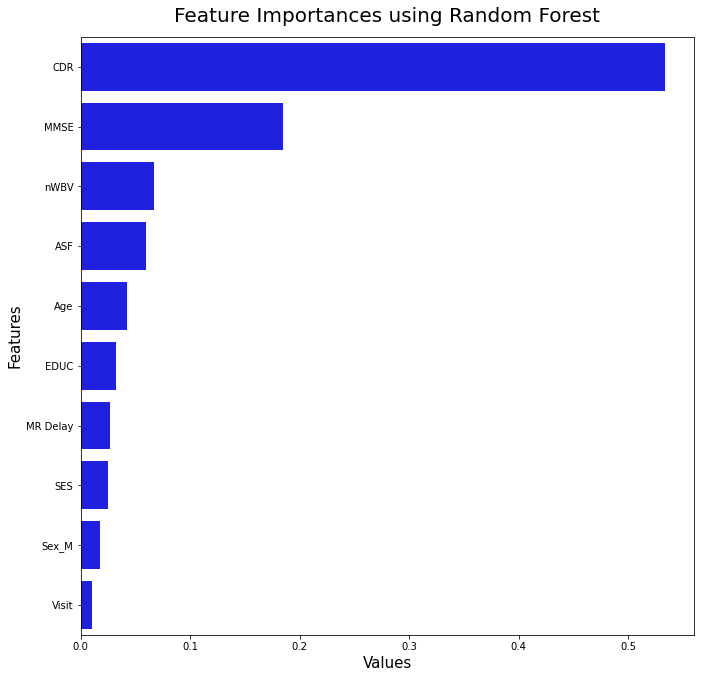

In [22]:
#Lets check the feature importance using random forest

#variable to store feature names
names = X_arr.columns

# Initailize RandomForestClassifier
rf = RandomForestClassifier()

#fit the variables
rf.fit(X_arr, y_arr)

#create importance variable
imp_df = pd.DataFrame()
imp_df["features"] = names
imp_df["values"] = rf.feature_importances_

#sort the data
imp_df.sort_values("values", ascending = False, inplace = True)

# Plot the feature importance
fig, ax = plt.subplots(figsize=(11,11))
sns.set_color_codes("pastel")
sns.barplot(x = 'values',y = 'features', data=imp_df, color="Blue", ax = ax)
ax.set_xlabel("Values", fontsize = 15)
ax.set_ylabel("Features", fontsize = 15)
ax.set_title("Feature Importances using Random Forest", fontsize = 20, pad = 15)
plt.show()

* CDR has a vary high feature importance value
* Thus we can use CDR for simplified visualization of the results

# Feature Engineering

### Normal data

In [23]:
data_list = {}

In [24]:
X_train, X_test, y_train, y_test = train_test_split(X_arr, y_arr, train_size = 0.75, random_state = rs)
data_list['notrans'] = (X_train, X_test, y_train, y_test)

### Min Max Scaler

In [25]:
minmax_scaler = MinMaxScaler() 
X_mms = pd.DataFrame(minmax_scaler.fit_transform(X_arr, y_arr))
X_train_mms, X_test_mms, y_train_mms, y_test_mms = train_test_split(X_mms, y_arr, train_size = 0.75, random_state = rs)
data_list['minmax_scaler'] = (X_train_mms, X_test_mms, y_train_mms, y_test_mms)

### Z-score normalization  (StandardScaler)

In [26]:
std_scaler = StandardScaler()
X_std = pd.DataFrame(std_scaler.fit_transform(X_arr, y_arr))
X_train_std, X_test_std, y_train_std, y_test_std = train_test_split(X_std, y_arr, train_size = 0.75, random_state = rs)
data_list['standard_scaler'] = (X_train_std, X_test_std, y_train_std, y_test_std)

### Polynomial Interaction terms on normal data(PolynomialFeatures: normal)

In [27]:
poly = PolynomialFeatures(degree = 3)
X_poly = pd.DataFrame(poly.fit_transform(X_arr, y_arr))
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(X_poly, y_arr, train_size = 0.75, random_state = rs)
data_list['poly_normal'] = (X_train_poly, X_test_poly, y_train_poly, y_test_poly)

### Polynomial Interaction terms on minmax scaled data(PolynomialFeatures : MinMaxScaler)

In [28]:
poly = PolynomialFeatures(degree = 3)
X_poly_mm = pd.DataFrame(poly.fit_transform(X_mms, y_arr))
X_train_poly_mm, X_test_poly_mm, y_train_poly_mm, y_test_poly_mm = train_test_split(X_poly_mm, y_arr, train_size = 0.75, random_state = rs)
data_list['poly_minmax'] = (X_train_poly_mm, X_test_poly_mm, y_train_poly_mm, y_test_poly_mm)

### Polynomial Interaction terms on standardscaler scaled data(PolynomialFeatures : StandardScaler)

In [29]:
poly = PolynomialFeatures(degree = 3)
X_poly_ss = pd.DataFrame(poly.fit_transform(X_std, y_arr))
X_train_poly_ss, X_test_poly_ss, y_train_poly_ss, y_test_poly_ss = train_test_split(X_poly_ss, y_arr, train_size = 0.75, random_state = rs)
data_list['poly_standard'] = (X_train_poly_ss, X_test_poly_ss, y_train_poly_ss, y_test_poly_ss)

# Model creation and Hyperparameter tuning

## Baseline model

### Logistic Regression

In [30]:
# Creating a Baseline model

# Initialize the logisticRegression model with default values
lr = LogisticRegression()

# Fit the model on training data
lr.fit(X_train, y_train)

y_pred_lr = lr.predict(X_test)
lr_score = accuracy_score(y_test, y_pred_lr)
print(f"Accuracy score for logistic regression : {round(lr_score, 2)}")

Accuracy score for logistic regression : 0.85


### Visualizing results

### Creating modular function for visualization

In [31]:
def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None, \
                          n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))
        axes[0].set_title(title)
    
    if ylim is not None:
        axes[0].set_ylim(*ylim)
        axes[0].set_xlabel("Training examples")
        axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
    learning_curve(lr, X, y, cv=cv, n_jobs=n_jobs, \
    train_sizes=train_sizes, return_times=True)

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores,axis=1)
    
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, \
    train_scores_mean - train_scores_std,\
    train_scores_mean + train_scores_std, \
    alpha=0.1, color="r")
    axes[0].fill_between(train_sizes, \
    test_scores_mean - test_scores_std,\
    test_scores_mean + test_scores_std, \
    alpha=0.1, color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', \
    color="r", label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', \
    color="g", label="Cross-validation score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, \
    fit_times_mean - fit_times_std,\
    fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, \
    test_scores_mean - test_scores_std,\
    test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")
    
    return plt


In [32]:
def plot_real_pred_val(Y_test, ypred, name):
    plt.figure()
    acc=accuracy_score(Y_test,ypred)
    plt.scatter(range(len(ypred)),ypred,color="blue",\
    lw=5,label="Predicted")
    plt.scatter(range(len(Y_test)), \
    Y_test,color="red",label="Actual")
    plt.title("Predicted Values vs True Values of " + name, \
    fontsize=10)
    plt.xlabel("Accuracy: " + str(round((acc*100),3)) + "%")
    plt.legend()
    plt.grid(True, alpha=0.75, lw=1, ls='-.')
    plt.show()

In [33]:
def plot_cm(Y_test, ypred, name):
    plt.figure()
    cm = confusion_matrix(Y_test, ypred)
    sns.heatmap(cm, annot=True, linewidth=0.7, \
    linecolor='red', fmt='g', cmap="YlGnBu")
    plt.title(name + ' Confusion Matrix')
    plt.xlabel('Y predict')
    plt.ylabel('Y test')
    plt.show()
    return cm


In [34]:
def plot_roc(model,X_test, y_test, title):
    Y_pred_prob = model.predict_proba(X_test)
    Y_pred_prob = Y_pred_prob[:, 1]

    fpr, tpr, thresholds = roc_curve(y_test, Y_pred_prob)
    plt.figure(figsize=(10,10))
    plt.plot([0,1],[0,1], color='navy', lw=5, linestyle='--')
    plt.plot(fpr,tpr, label='ANN')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve of ' + title)
    plt.grid(True)
    plt.show()


In [35]:
def plot_decision_boundary(model,xtest, ytest, name):
    #Trains model with two features
    model_copy = clone(model)
    model_copy.fit(xtest, ytest)
    plt.figure()

    plot_decision_regions(xtest.values, ytest.ravel(), \
    clf=model_copy, legend=2)
    plt.title("Decision boundary for " + name + " (Test)")
    plt.xlabel('MMSE')
    plt.ylabel('ASF')
    plt.show()

In [36]:
def train_model(model, X, y):
    model.fit(X, y)
    return model



In [37]:
def predict_model(model, X, proba=False):
    if ~proba:
        y_pred = model.predict(X)
    else:
        y_pred_proba = model.predict_proba(X)
        y_pred = np.argmax(y_pred_proba, axis=1)
        
    return y_pred



In [38]:
def run_model(name, model, X_train, X_test, y_train, y_test, fc, list_scores, proba=False):
    print(name)
    print(fc)
    
    start = time.time()
    model = train_model(model, X_train, y_train)
    train_time = ((time.time() - start))*pow(10, 3)
    main_dir = os.getcwd()
    with open(main_dir + '/models/' + name + ' ' + fc + '.pkl', 'wb') as fid:
        pickle.dump(model, fid) 
    y_pred = predict_model(model, X_test, proba)
    accuracy = accuracy_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    print(classification_report(y_test, y_pred))


    plot_cm(y_test, y_pred, name)
    plot_real_pred_val(y_test, y_pred, name)
    plot_roc(model, X_test, y_test, name)

    #plot_decision_boundary(model,X_test_feat, y_test_feat, name)
    plot_learning_curve(model, name, X_train, y_train, cv=3); 
    plt.show()

    list_scores.append({'Model Name': name, \
    'Feature Scaling':fc, 'Accuracy': accuracy, \
    'Recall': recall, 'Precision': precision, 'F1':f1, \
    'training time (ms)': train_time                   
                       })

In [39]:
list_scores = []

LogisticRegression
None
              precision    recall  f1-score   support

           0       0.80      0.91      0.85        43
           1       0.91      0.80      0.85        51

    accuracy                           0.85        94
   macro avg       0.85      0.86      0.85        94
weighted avg       0.86      0.85      0.85        94



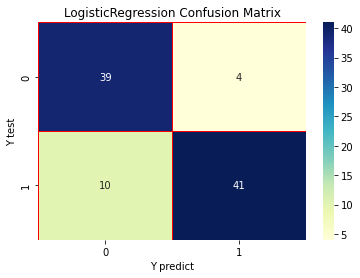

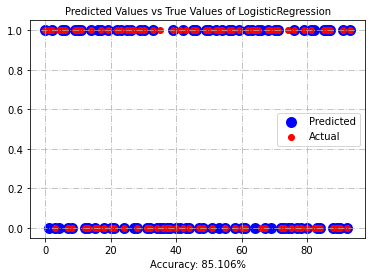

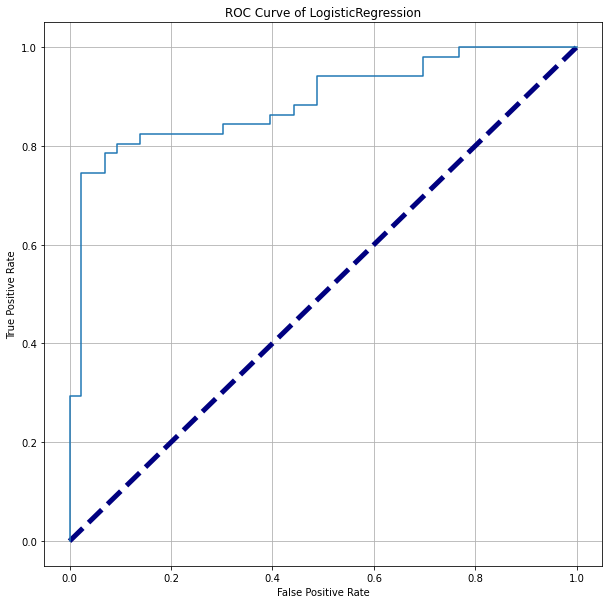

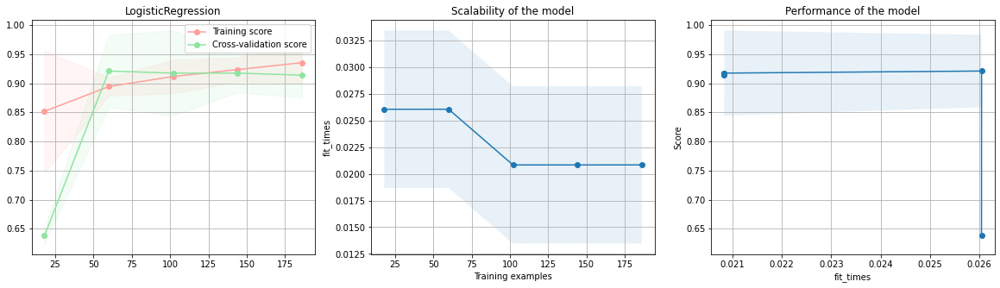

In [40]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

Conclusion

#### Hyperparameter tuning 

#### Grid search

In [41]:
tune_list = []

In [42]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['notrans'][0], data_list['notrans'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [43]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457}]

In [44]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l1
The optimal value of C is: 0.2
The optimal value of solver is: liblinear
The optimal value of max_iter is: 100


LogisticRegression tuned: Gridsearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



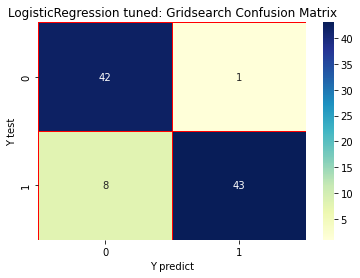

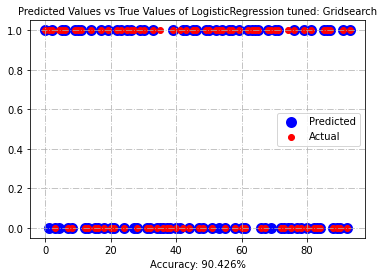

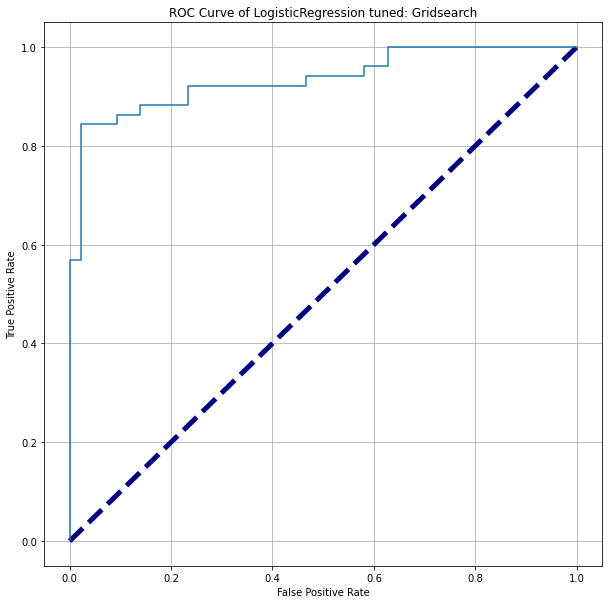

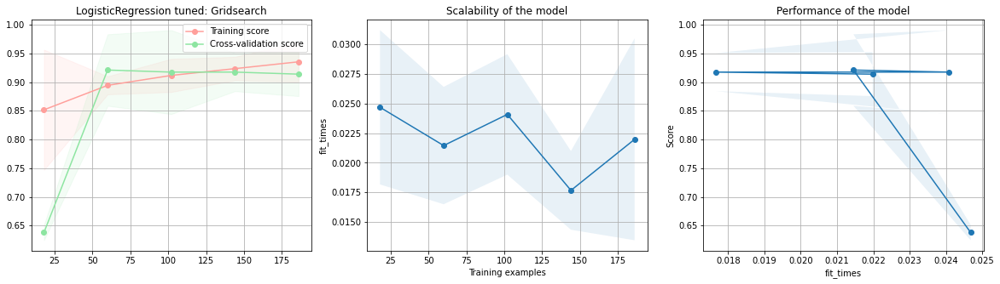

In [45]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Gridsearch", lr_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Random search

In [46]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['notrans'][0], data_list['notrans'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [47]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902}]

In [48]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: none
The optimal value of C is: 0.1
The optimal value of solver is: lbfgs
The optimal value of max_iter is: 100


LogisticRegression tuned: RandomizedSearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



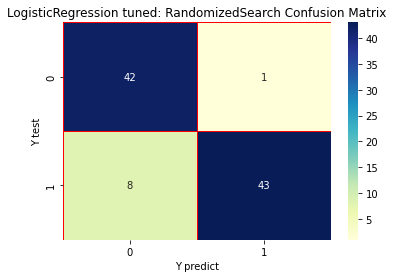

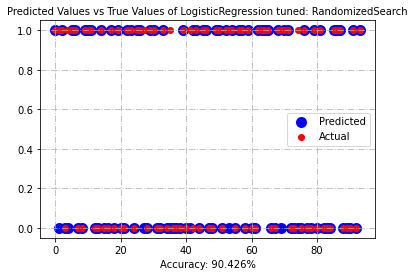

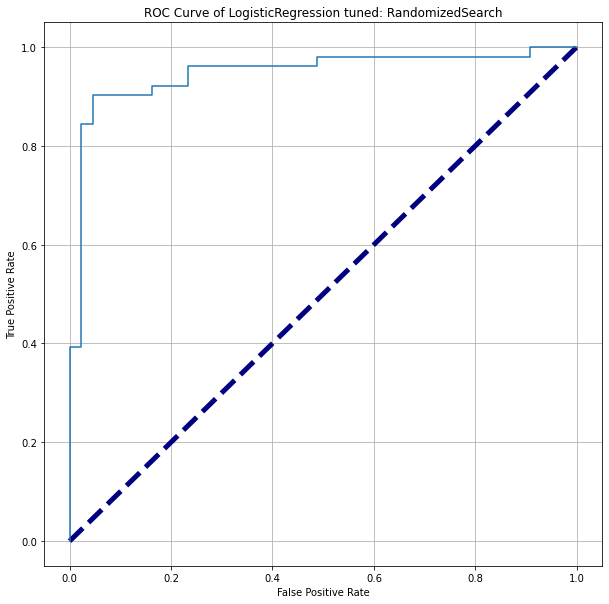

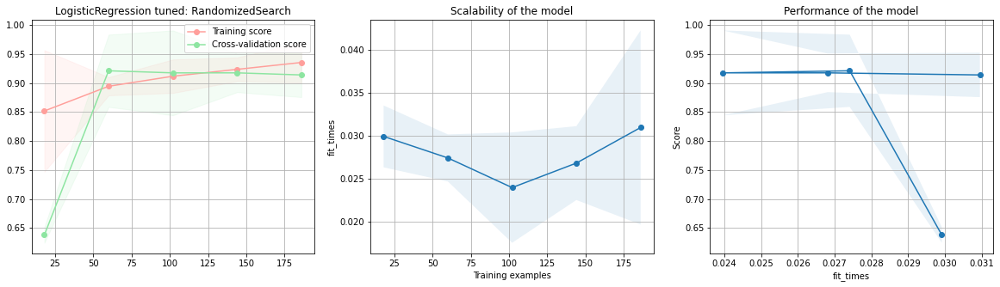

In [49]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Halving Grid Search

In [50]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['notrans'][0], data_list['notrans'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [51]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607}]

In [52]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 2
The optimal value of solver is: lbfgs
The optimal value of max_iter is: 500


LogisticRegression tuned: Halving Grid Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



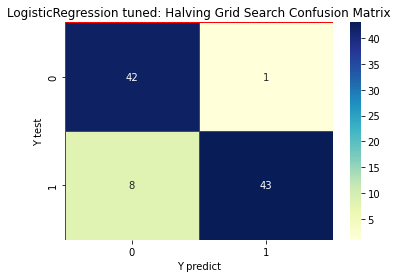

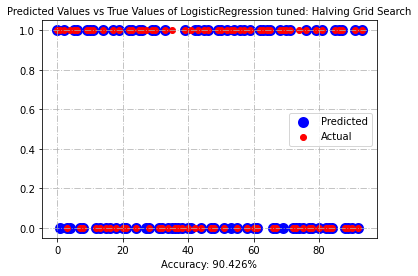

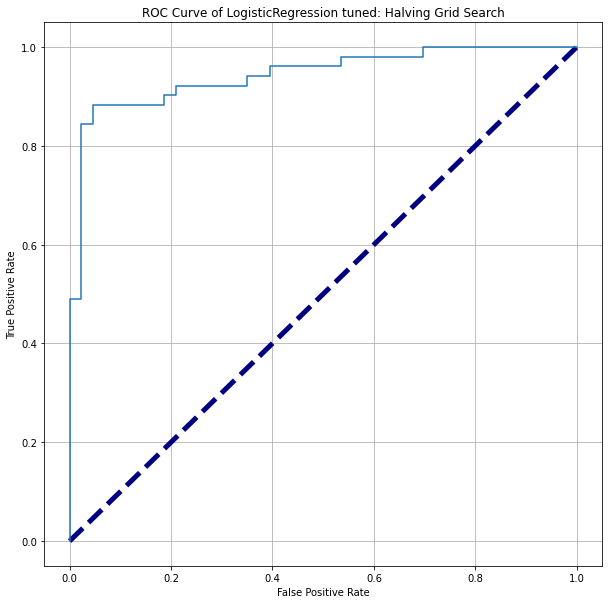

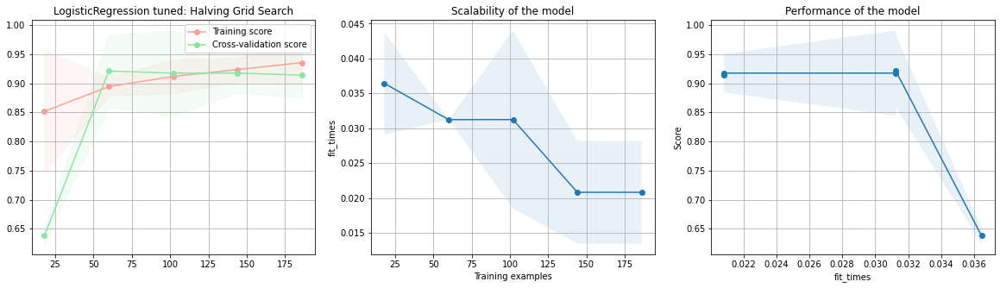

In [53]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

In [54]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random search

In [55]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['notrans'][0], data_list['notrans'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [56]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547}]

In [57]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 2
The optimal value of solver is: liblinear
The optimal value of max_iter is: 200


LogisticRegression tuned: Halving Random Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



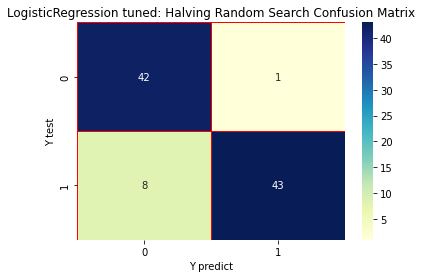

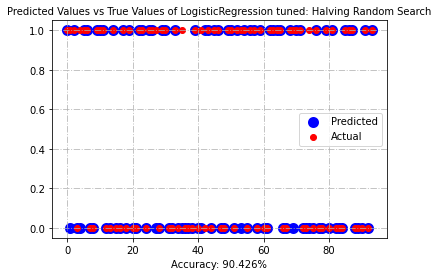

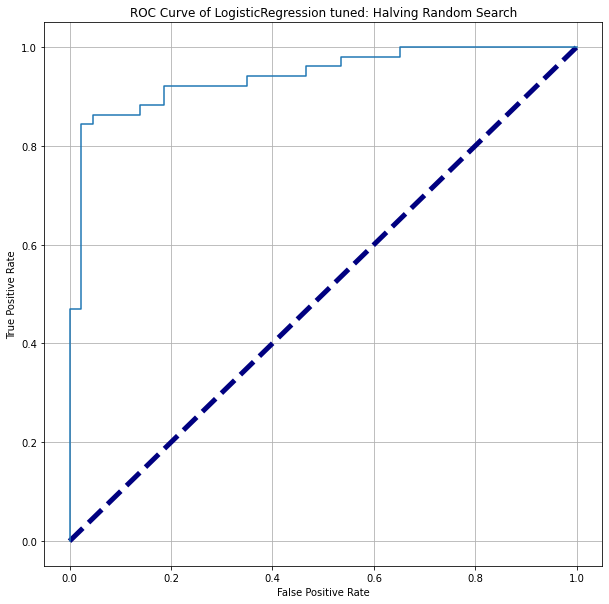

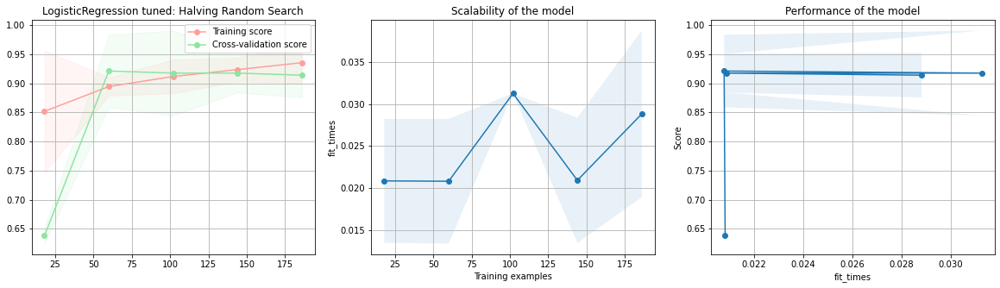

In [58]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

In [59]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Logistic Regression with min-max scaling 

LogisticRegression
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.80      0.95      0.87        43
           1       0.95      0.80      0.87        51

    accuracy                           0.87        94
   macro avg       0.88      0.88      0.87        94
weighted avg       0.89      0.87      0.87        94



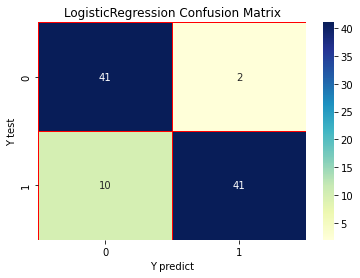

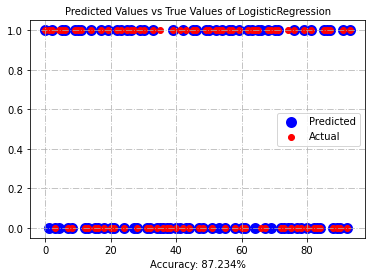

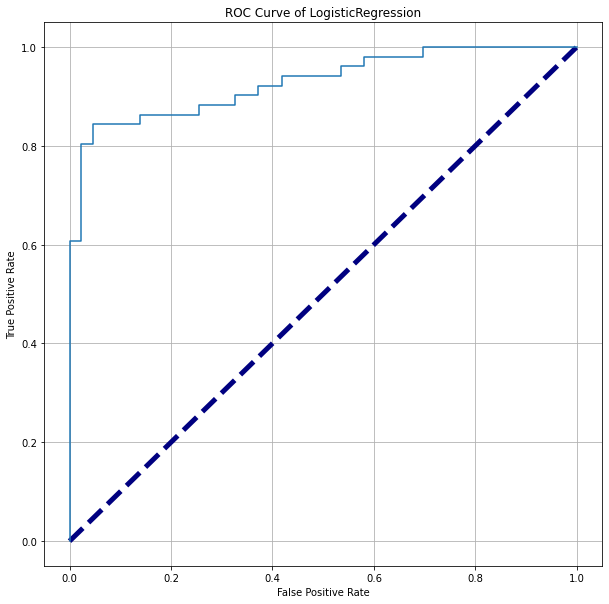

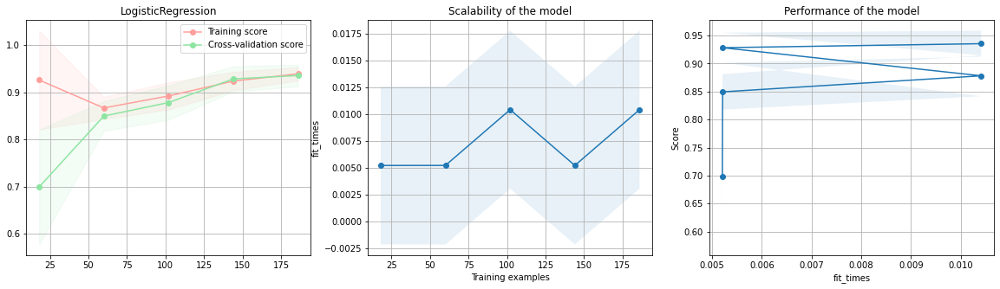

In [60]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

Conclusion

#### Hyperparameter tuning 

#### Grid search

In [61]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [62]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: none
The optimal value of C is: 0.1
The optimal value of solver is: sag
The optimal value of max_iter is: 100


LogisticRegression tuned : Gridsearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



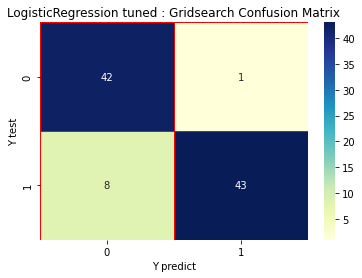

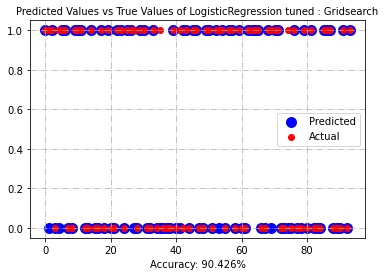

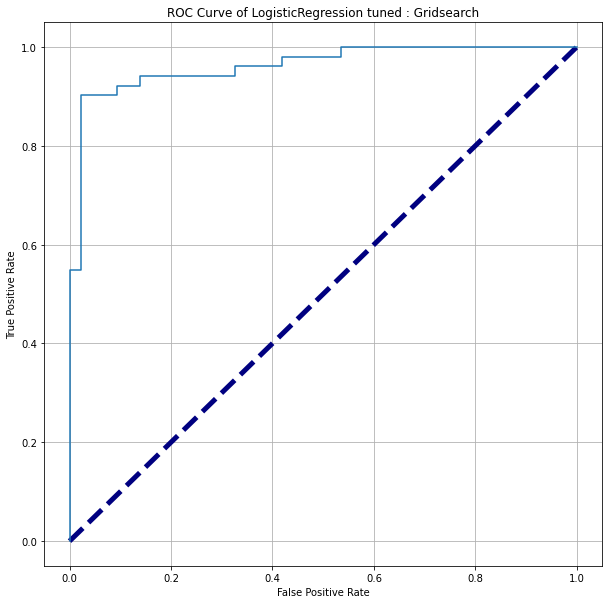

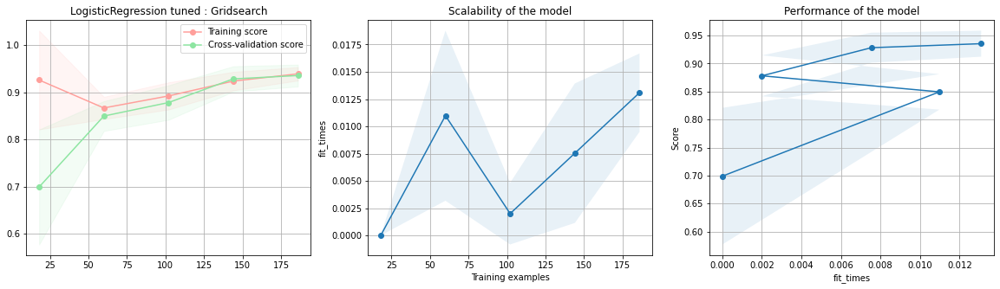

In [63]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned : Gridsearch", lr_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Random search

In [64]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [65]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184}]

In [66]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: none
The optimal value of C is: 1.3
The optimal value of solver is: saga
The optimal value of max_iter is: 200


LogisticRegression tuned: RandomizedSearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



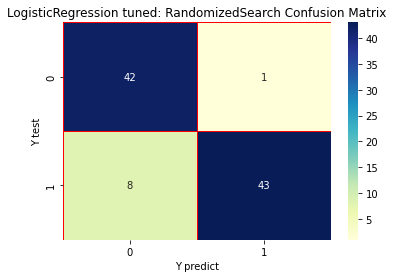

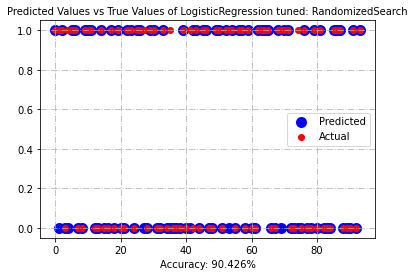

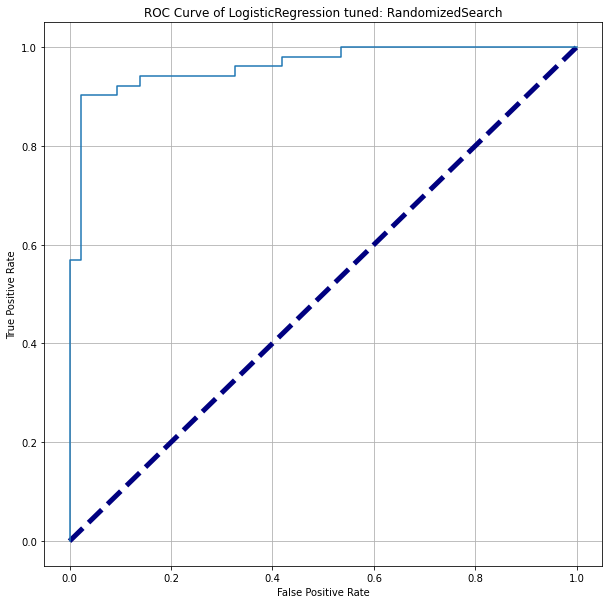

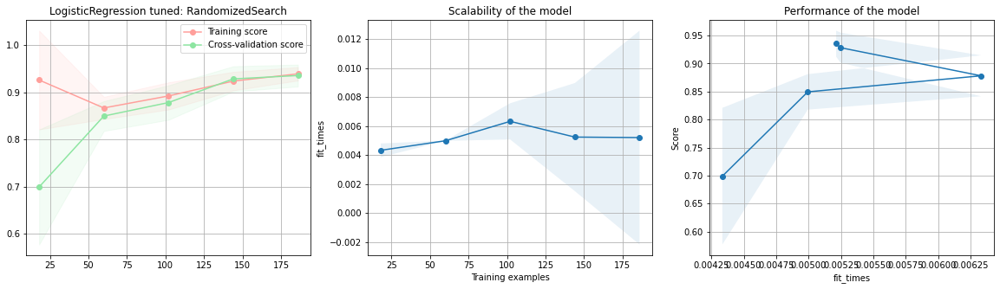

In [67]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Halving Grid Search

In [68]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [69]:
tune_list 

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746}]

In [70]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 2
The optimal value of solver is: saga
The optimal value of max_iter is: 500


LogisticRegression tuned: Halving Grid Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



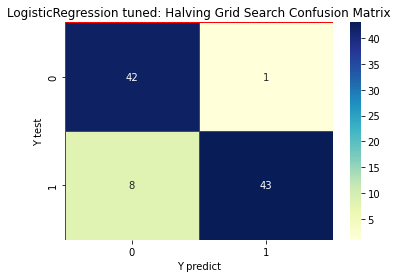

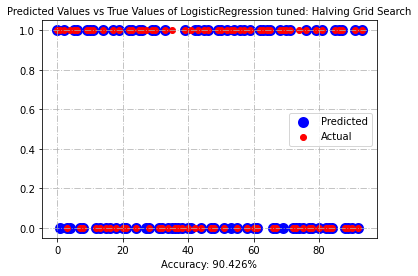

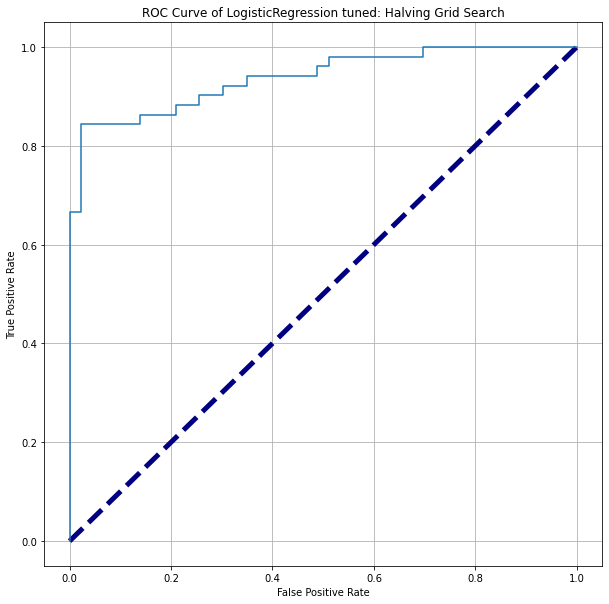

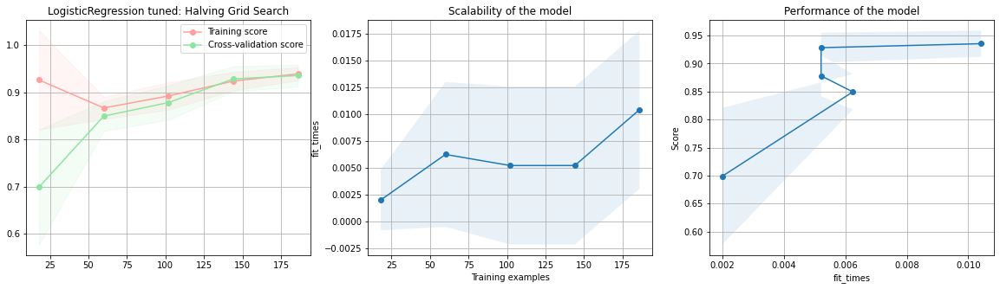

In [71]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

In [72]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random search

In [73]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [74]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234}]

In [75]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 1.3
The optimal value of solver is: saga
The optimal value of max_iter is: 300


LogisticRegression tuned: Halving Random Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



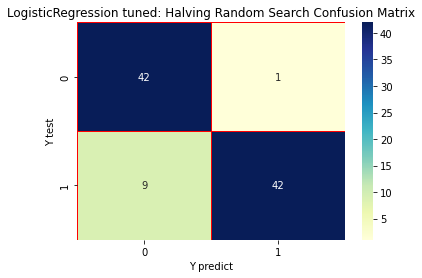

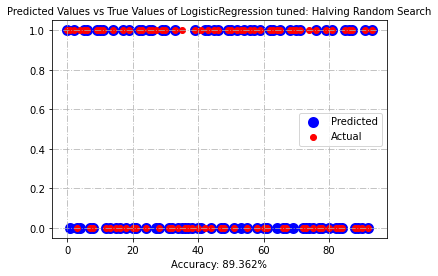

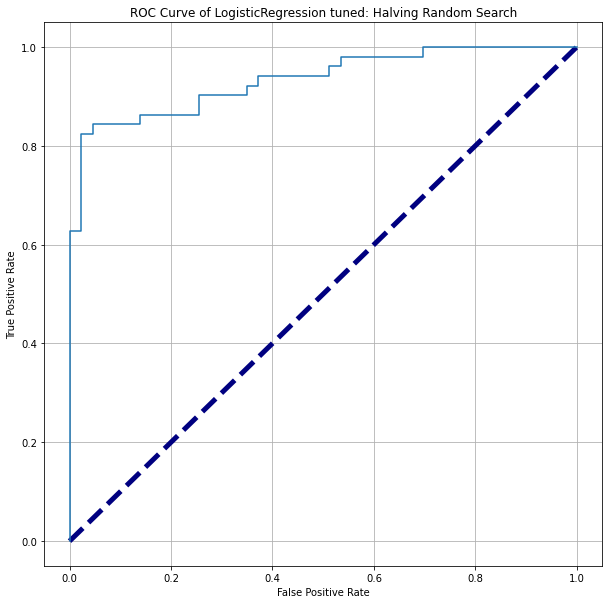

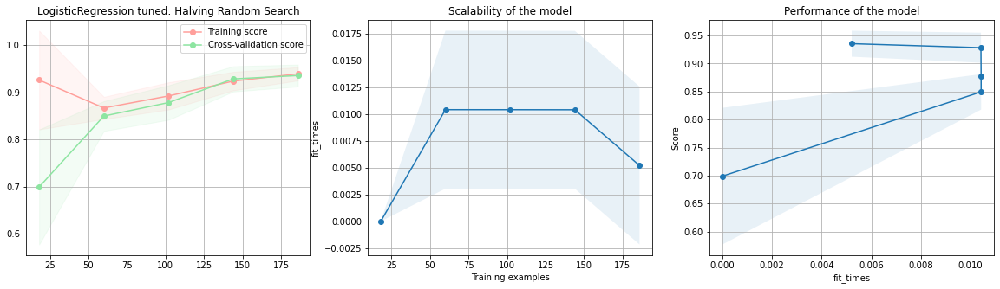

In [76]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

In [77]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Logistic Regression with standard scaling 

In [78]:
data_list.keys()

dict_keys(['notrans', 'minmax_scaler', 'standard_scaler', 'poly_normal', 'poly_minmax', 'poly_standard'])

LogisticRegression
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



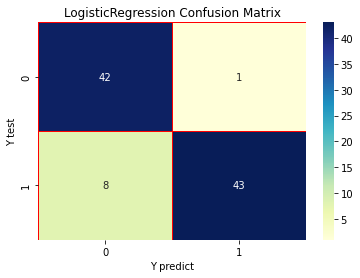

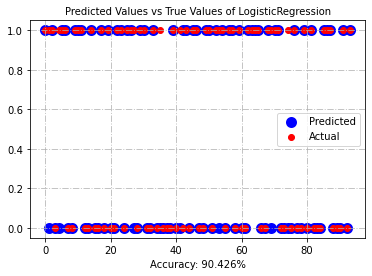

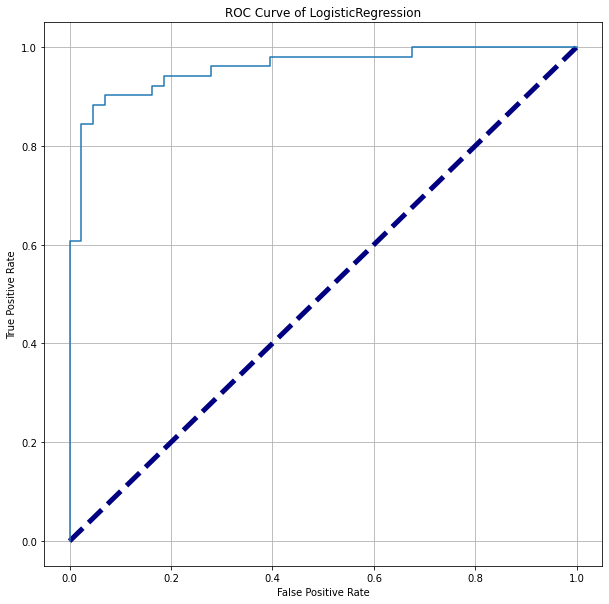

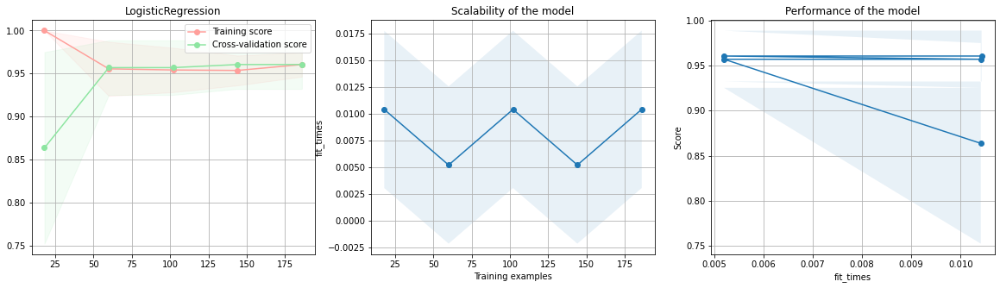

In [79]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

Conclusion

#### Hyperparameter tuning 

#### Grid search

In [80]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [81]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l1
The optimal value of C is: 0.1
The optimal value of solver is: liblinear
The optimal value of max_iter is: 100


LogisticRegression tuned : Gridsearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



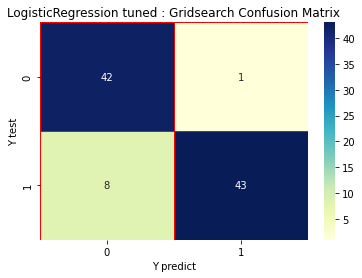

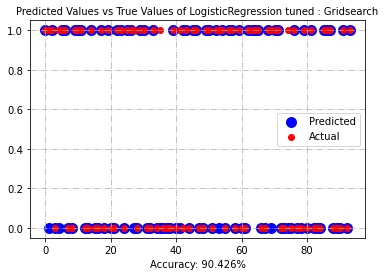

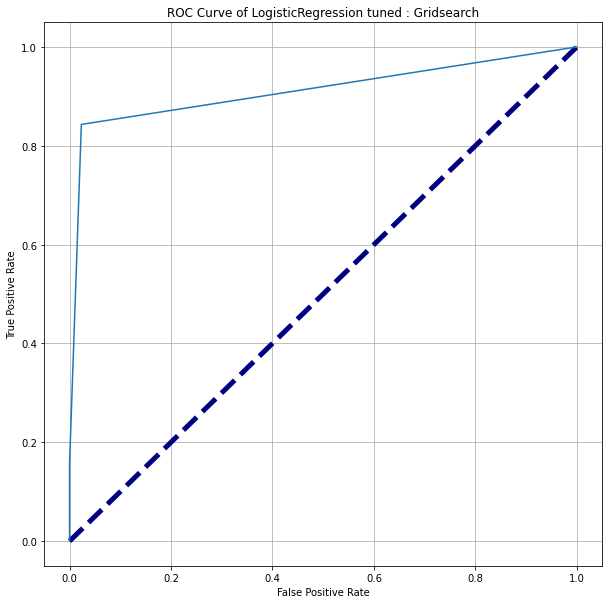

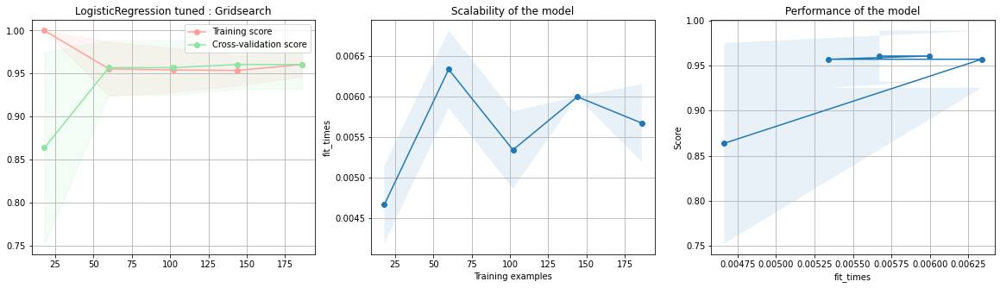

In [82]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned : Gridsearch", lr_best,  data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Random search

In [83]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [84]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [85]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l2
The optimal value of C is: 0.5
The optimal value of solver is: liblinear
The optimal value of max_iter is: 100


LogisticRegression tuned: RandomizedSearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



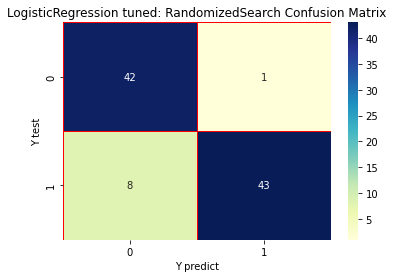

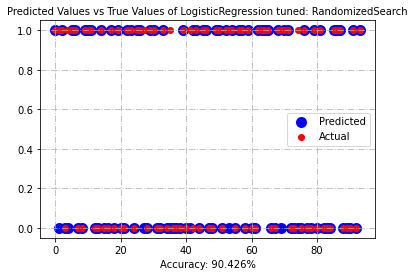

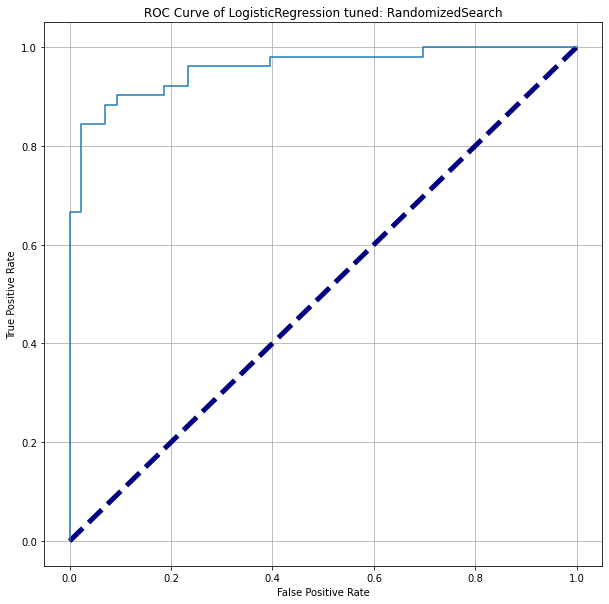

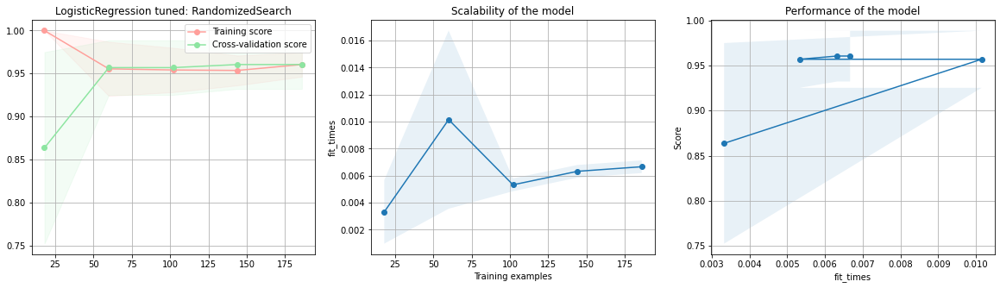

In [86]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best,  data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Halving Grid Search

In [87]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [88]:
tune_list 

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [89]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 2
The optimal value of solver is: liblinear
The optimal value of max_iter is: 500


LogisticRegression tuned: Halving Grid Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



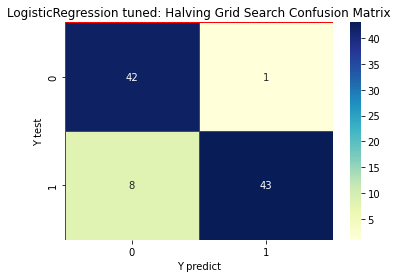

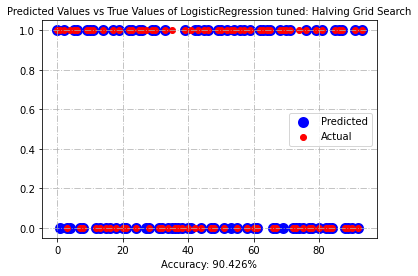

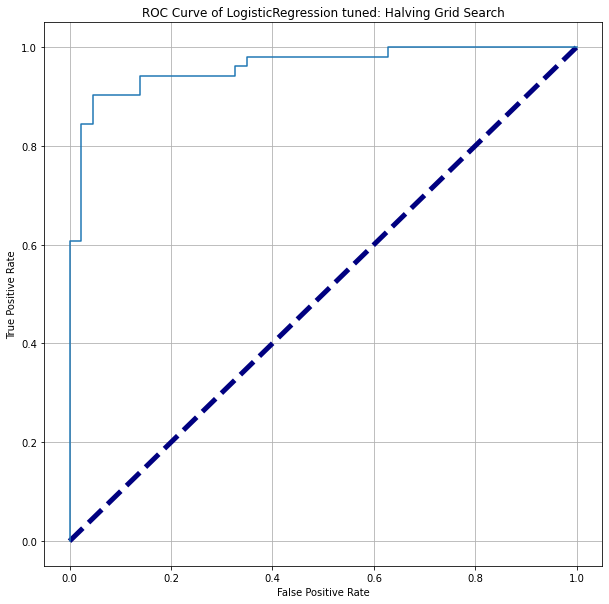

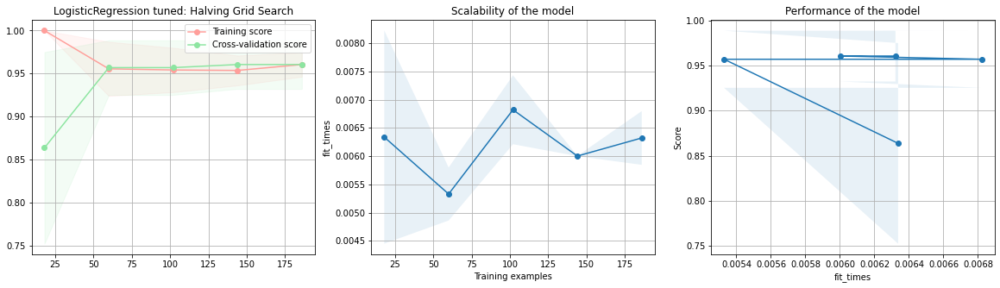

In [90]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best,  data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

In [91]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random search

In [92]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [93]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [94]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.7
The optimal value of solver is: saga
The optimal value of max_iter is: 200


LogisticRegression tuned: Halving Random Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



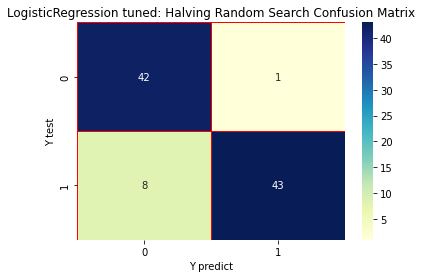

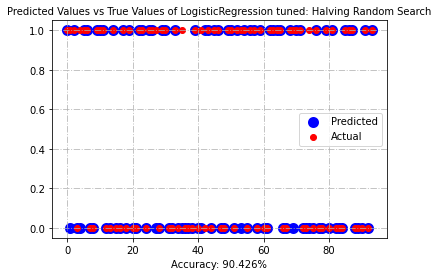

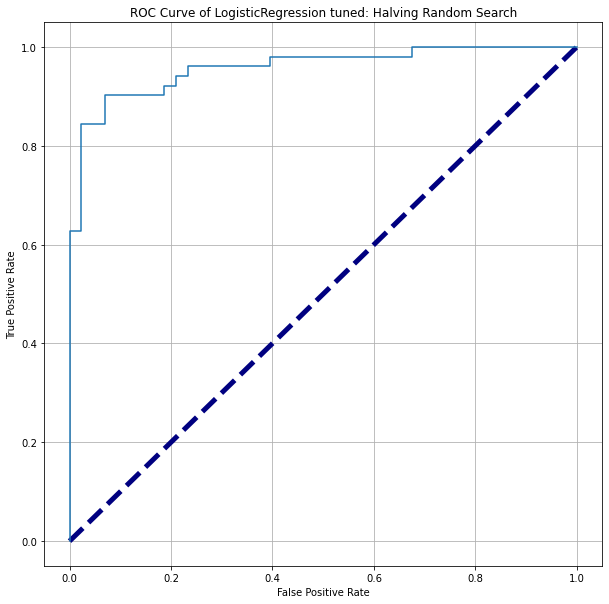

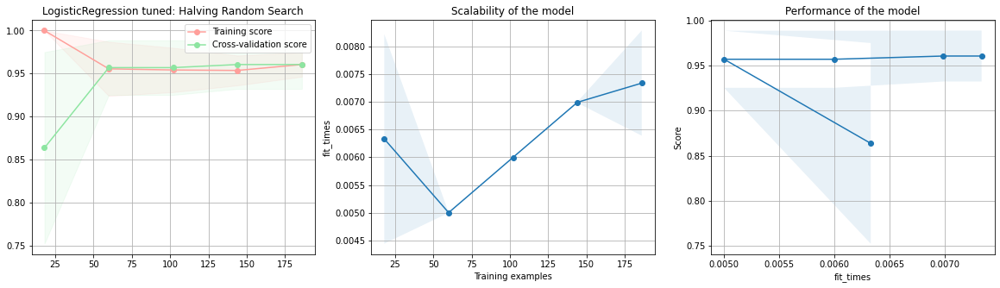

In [95]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

In [96]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Logistic Regression with polynomial transformation

LogisticRegression
Polynomial
              precision    recall  f1-score   support

           0       0.62      0.98      0.76        43
           1       0.96      0.49      0.65        51

    accuracy                           0.71        94
   macro avg       0.79      0.73      0.70        94
weighted avg       0.80      0.71      0.70        94



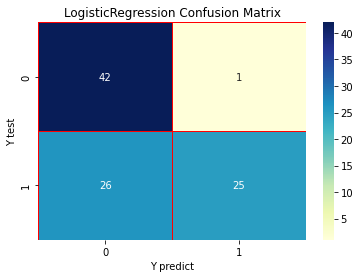

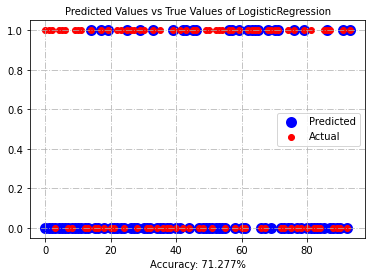

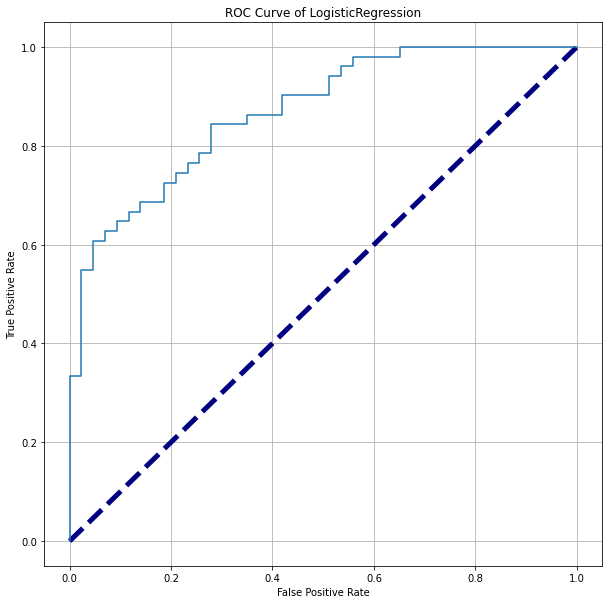

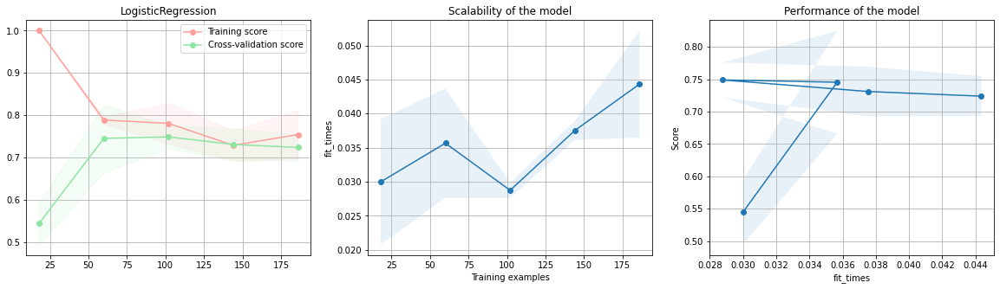

In [97]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

Conclusion

#### Hyperparameter tuning 

#### Grid search

In [98]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [99]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l1
The optimal value of C is: 0.1
The optimal value of solver is: liblinear
The optimal value of max_iter is: 100


LogisticRegression tuned : Gridsearch
Polynomial
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



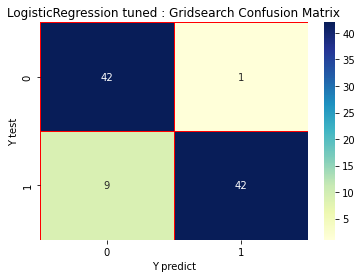

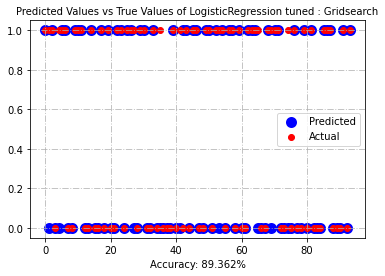

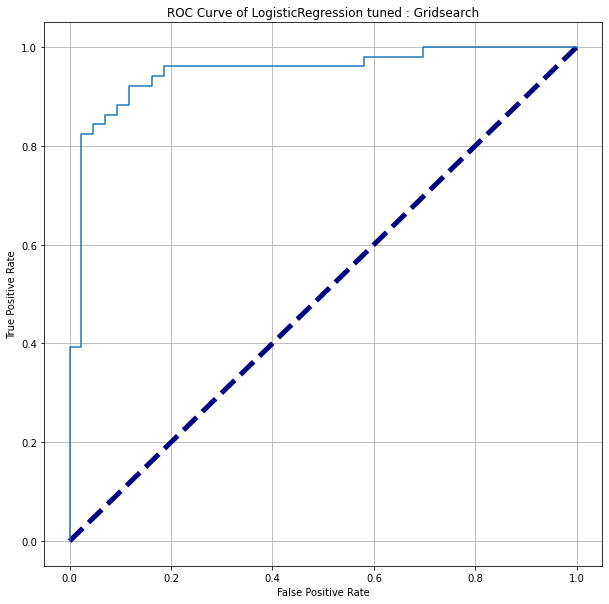

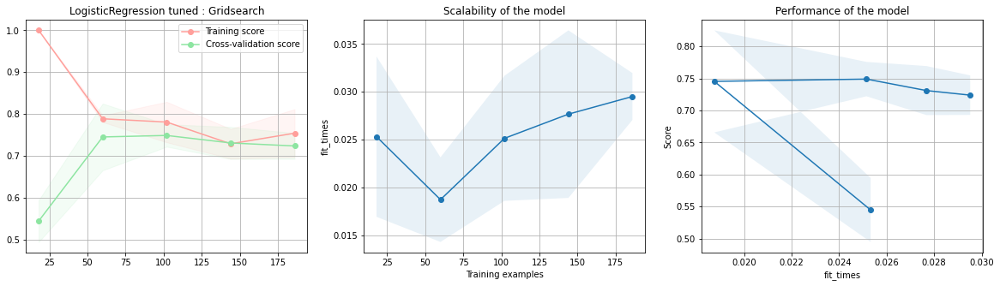

In [100]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned : Gridsearch", lr_best,  data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Random search

In [101]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [102]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [103]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l2
The optimal value of C is: 0.5
The optimal value of solver is: newton-cg
The optimal value of max_iter is: 100


LogisticRegression tuned: RandomizedSearch
Polynomial
              precision    recall  f1-score   support

           0       0.82      0.93      0.87        43
           1       0.93      0.82      0.87        51

    accuracy                           0.87        94
   macro avg       0.87      0.88      0.87        94
weighted avg       0.88      0.87      0.87        94



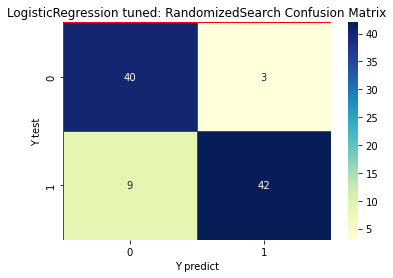

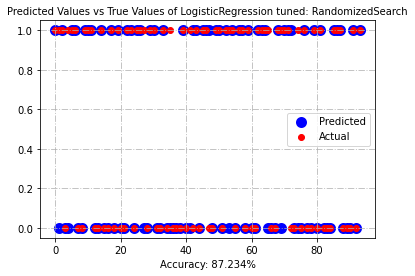

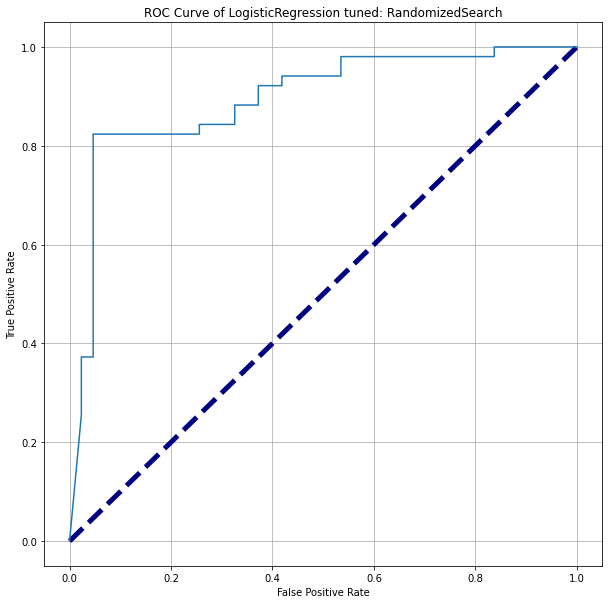

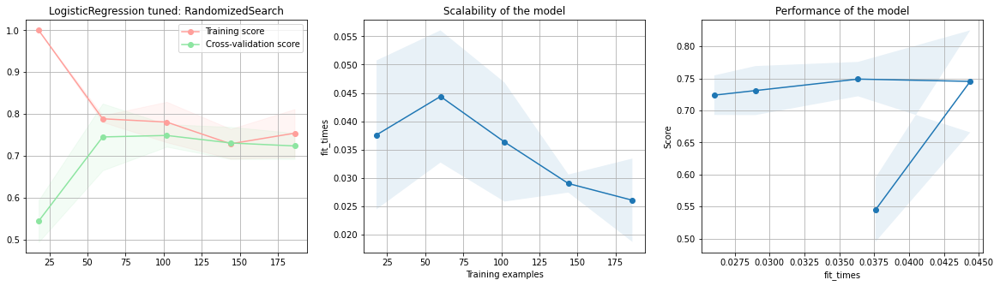

In [104]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Halving Grid Search

In [105]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [106]:
tune_list 

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [107]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.5
The optimal value of solver is: newton-cg
The optimal value of max_iter is: 100


LogisticRegression tuned: Halving Grid Search
Polynomial
              precision    recall  f1-score   support

           0       0.82      0.93      0.87        43
           1       0.93      0.82      0.87        51

    accuracy                           0.87        94
   macro avg       0.87      0.88      0.87        94
weighted avg       0.88      0.87      0.87        94



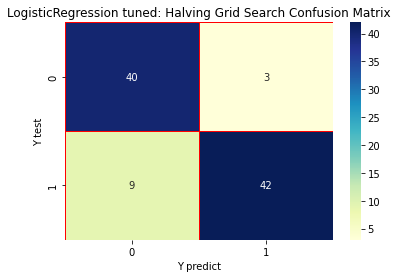

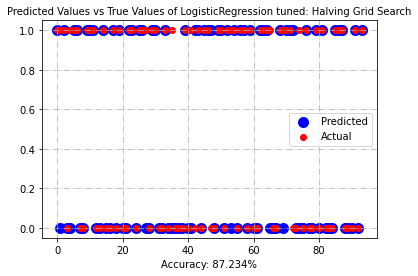

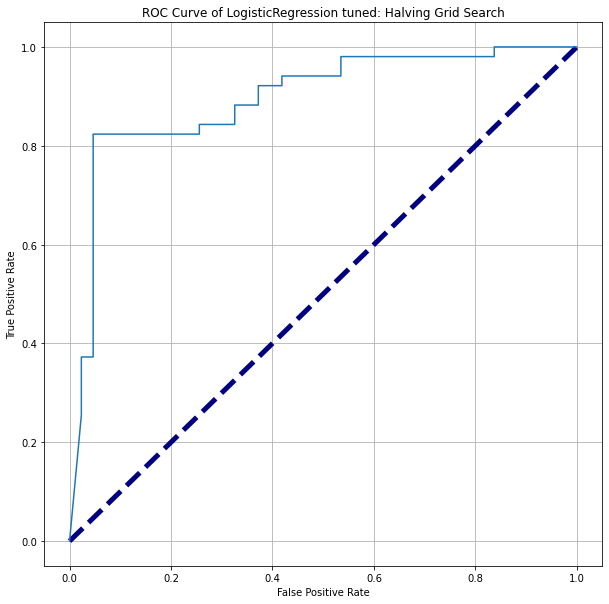

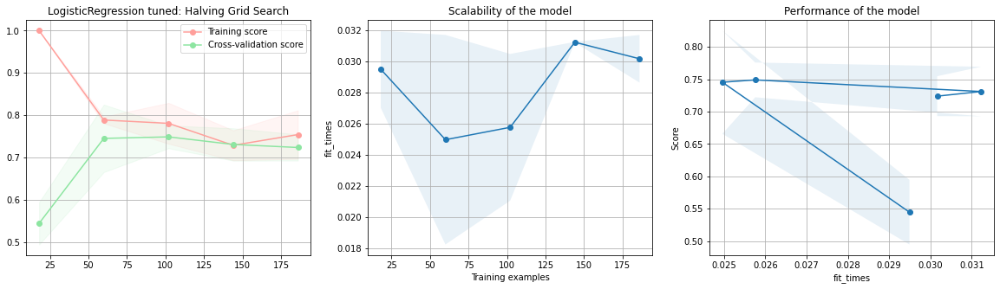

In [108]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best,  data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

In [109]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random Search

In [110]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [111]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [112]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 1.5
The optimal value of solver is: newton-cg
The optimal value of max_iter is: 300


LogisticRegression tuned: Halving Random Search
Polynomial
              precision    recall  f1-score   support

           0       0.80      0.93      0.86        43
           1       0.93      0.80      0.86        51

    accuracy                           0.86        94
   macro avg       0.87      0.87      0.86        94
weighted avg       0.87      0.86      0.86        94



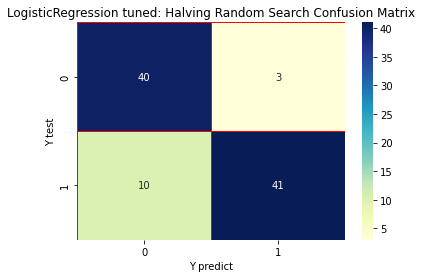

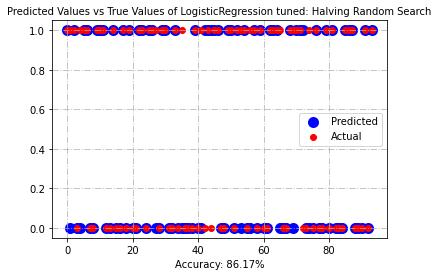

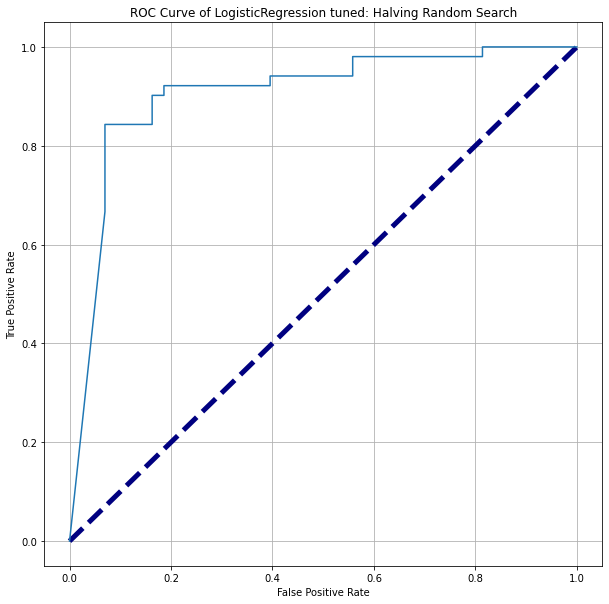

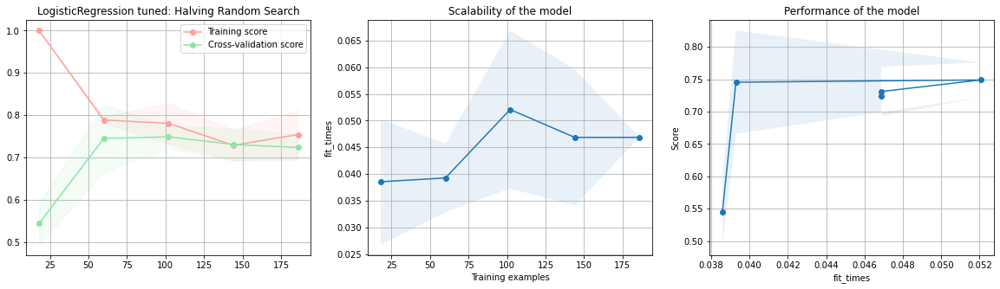

In [113]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best,data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

In [114]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Logistic Regression with Min Max polynomial transformation

LogisticRegression
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



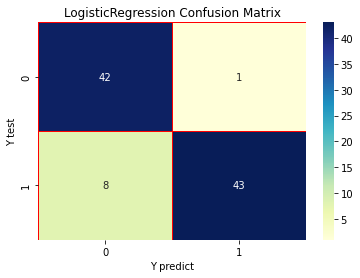

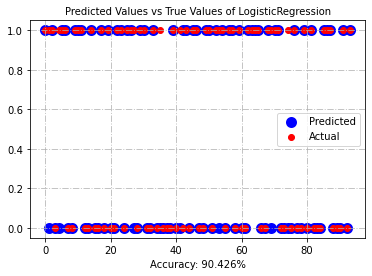

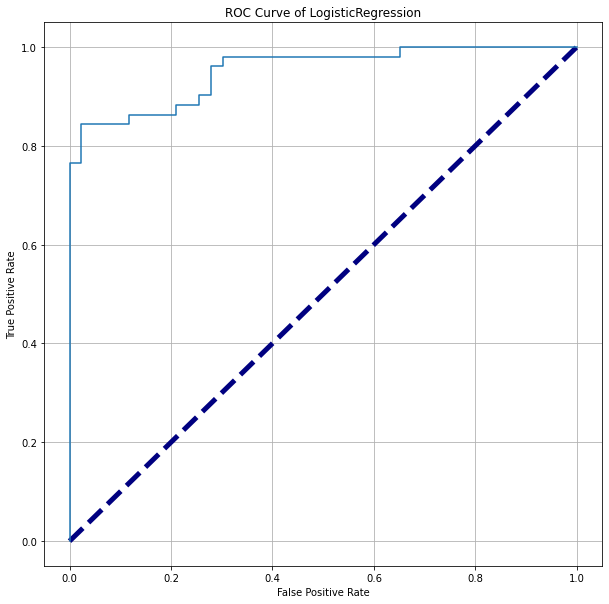

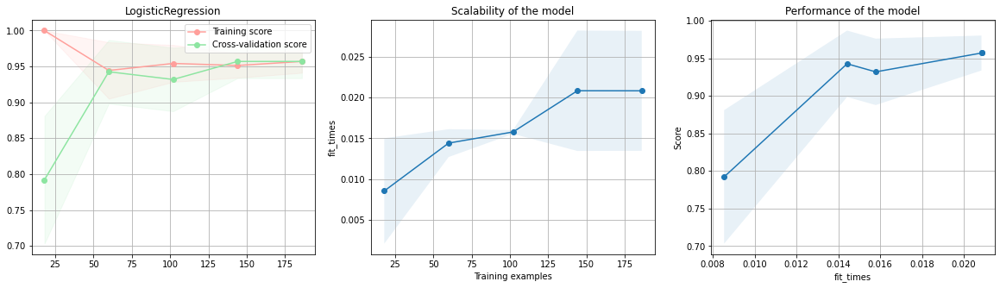

In [115]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

Conclusion

#### Hyperparameter tuning 

#### Grid search

In [116]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [117]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: none
The optimal value of C is: 0.1
The optimal value of solver is: saga
The optimal value of max_iter is: 100


LogisticRegression tuned : Gridsearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



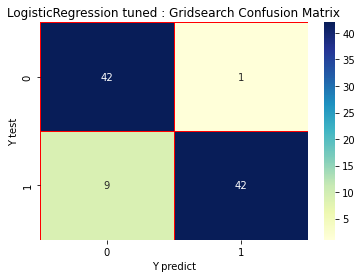

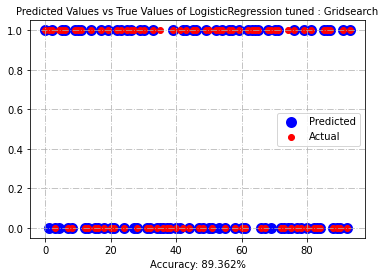

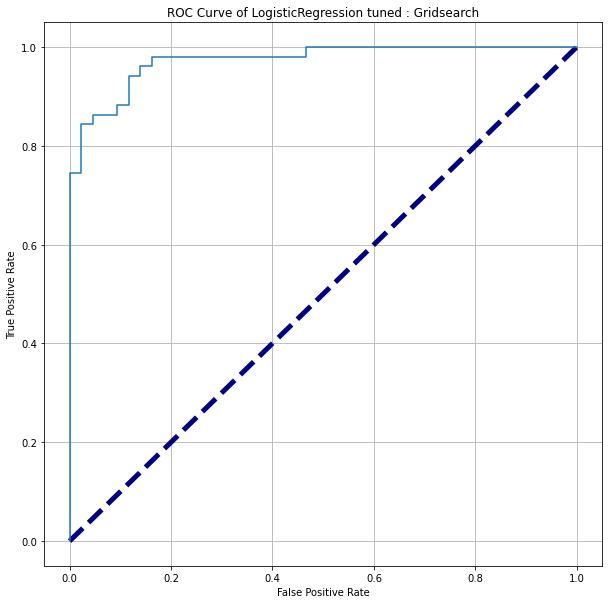

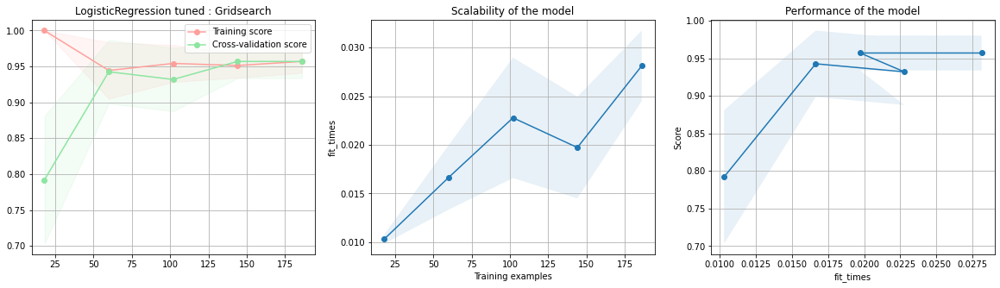

In [118]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned : Gridsearch", lr_best,  data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Random search

In [119]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [120]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [121]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l2
The optimal value of C is: 0.8
The optimal value of solver is: liblinear
The optimal value of max_iter is: 500


LogisticRegression tuned: RandomizedSearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



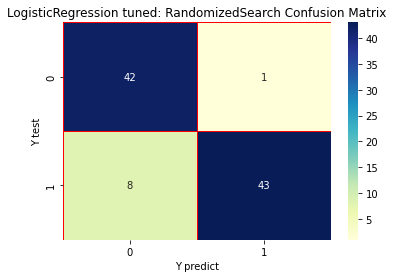

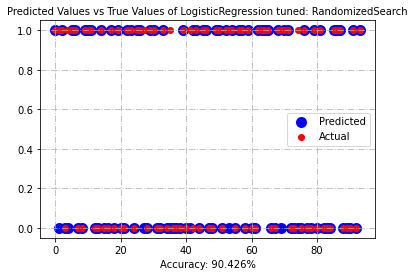

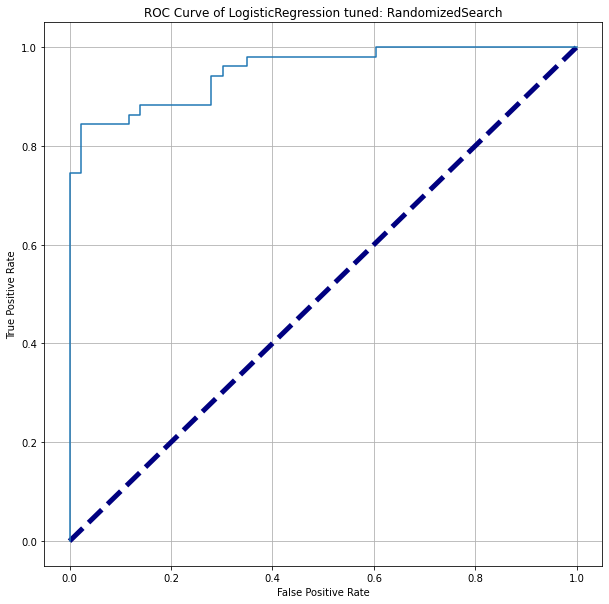

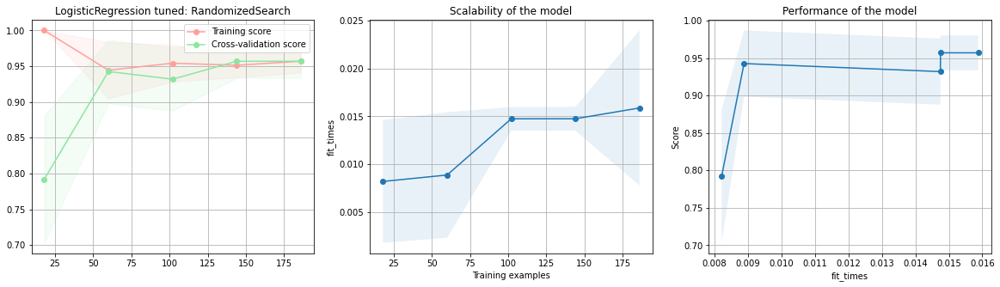

In [122]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Halving Grid Search

In [123]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [124]:
tune_list 

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [125]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.7
The optimal value of solver is: lbfgs
The optimal value of max_iter is: 100


LogisticRegression tuned: Halving Grid Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



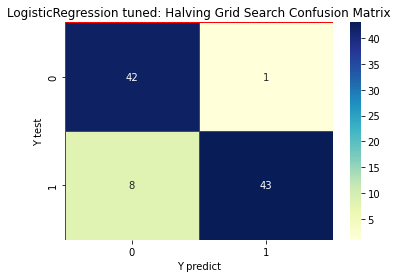

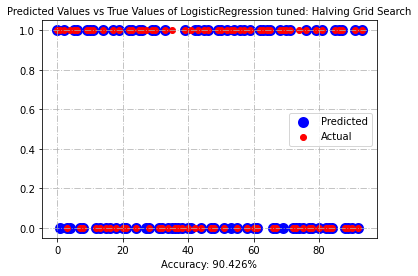

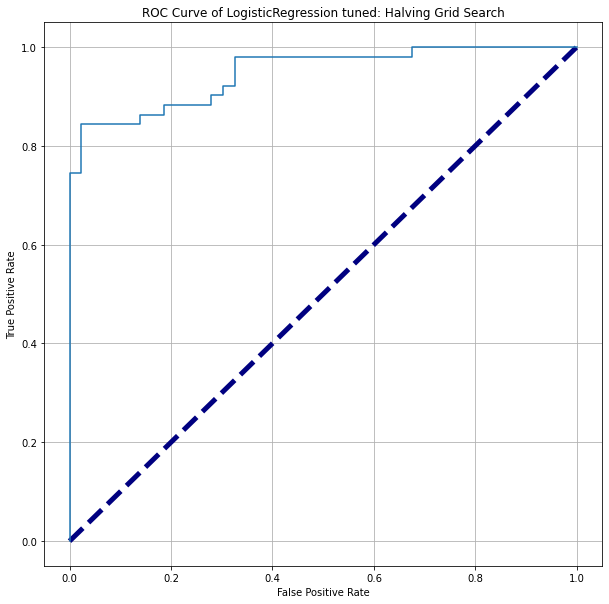

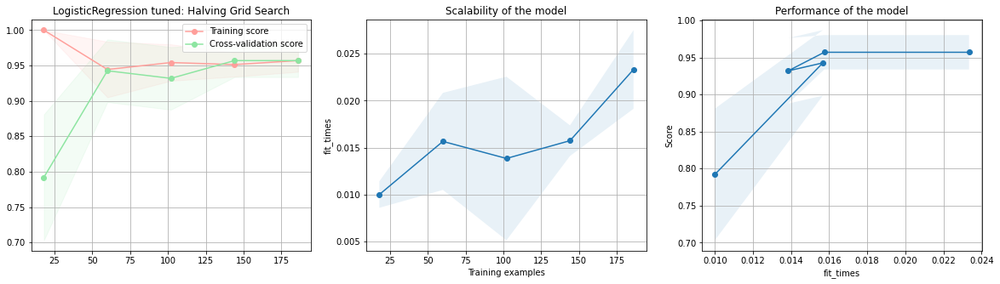

In [126]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

In [127]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random search

In [128]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [129]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [130]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.4
The optimal value of solver is: lbfgs
The optimal value of max_iter is: 100


LogisticRegression tuned: Halving Random Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



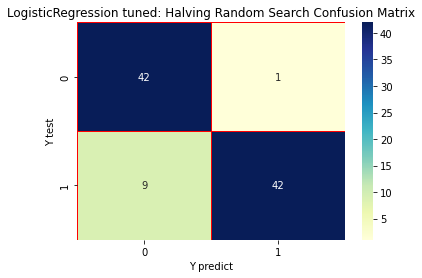

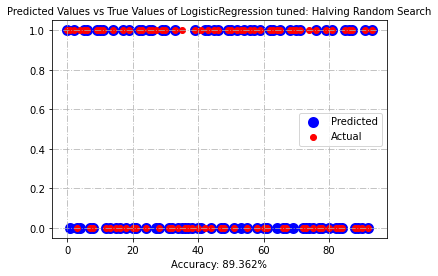

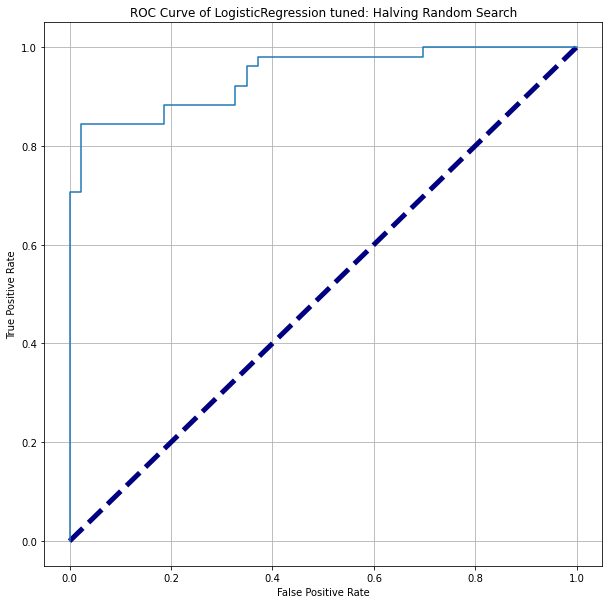

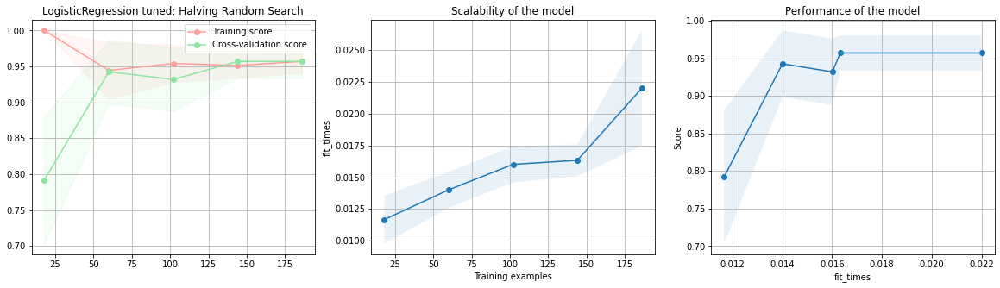

In [131]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best,data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

In [132]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Logistic Regression with Standard Scaler polynomial transformation

LogisticRegression
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.95      0.89        43
           1       0.96      0.84      0.90        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.90      0.89      0.89        94



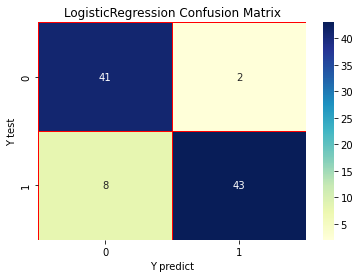

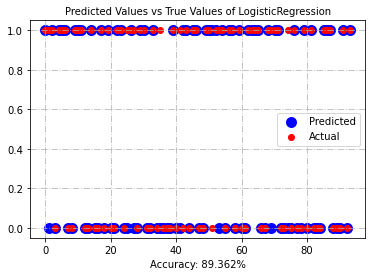

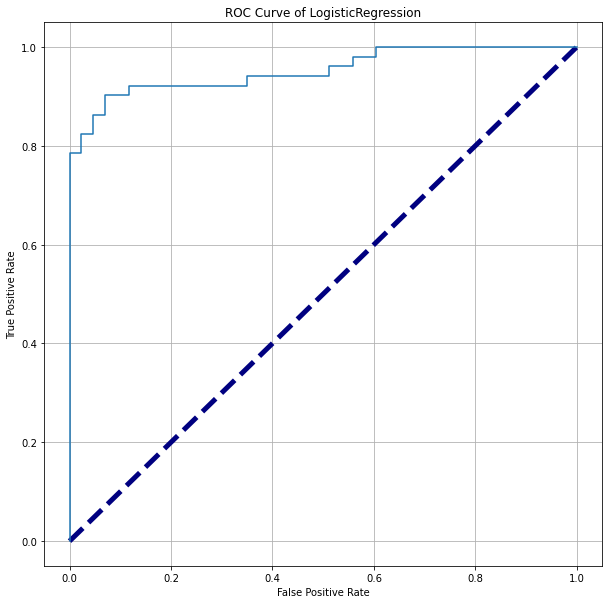

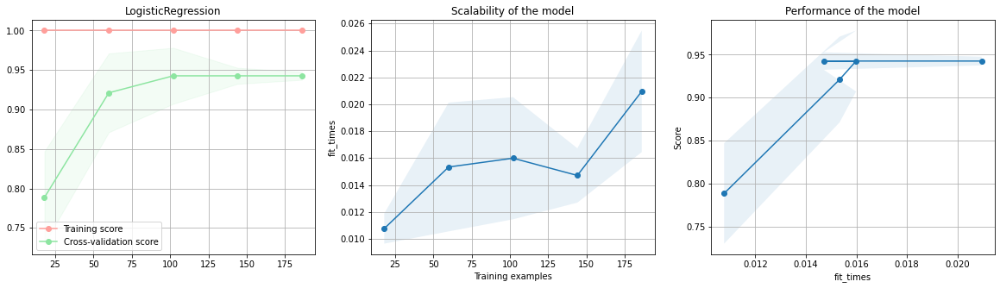

In [133]:
# Initialize the model 
lr = LogisticRegression(random_state = rs)

# Run the training script
run_model("LogisticRegression", lr, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

Conclusion

#### Hyperparameter Tuning 

#### Grid Search

In [134]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = GridSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

tuning_time["model"] = "logistic Regression: Gridsearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [135]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: l1
The optimal value of C is: 0.1
The optimal value of solver is: liblinear
The optimal value of max_iter is: 100


LogisticRegression tuned : Gridsearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



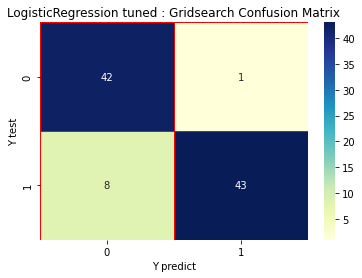

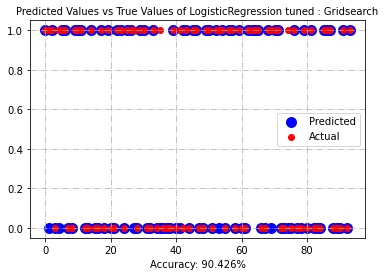

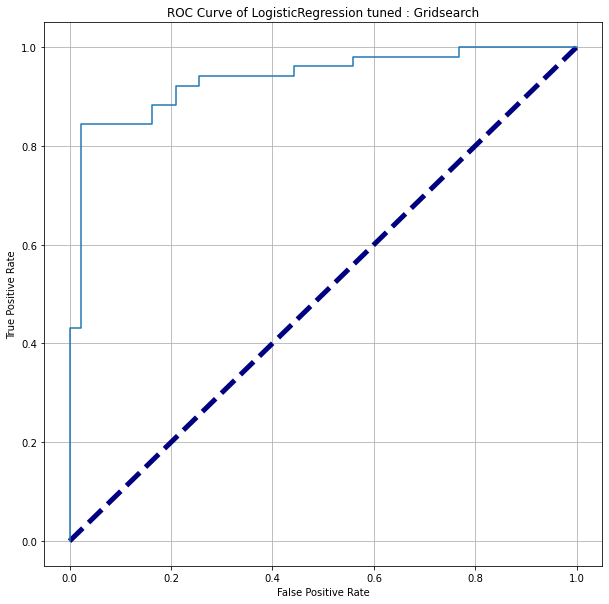

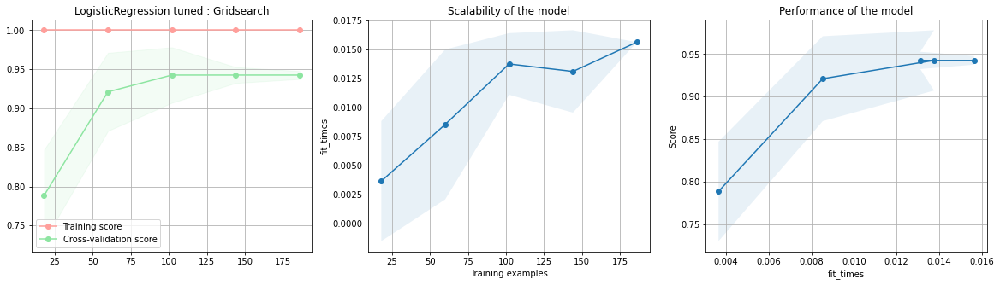

In [136]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned : Gridsearch", lr_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Random Search

In [137]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'penalty' : ['none', 'l1', 'l2', 'elasticnet'], 'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = RandomizedSearchCV(lr, parameters, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

tuning_time["model"] = "logistic Regression: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [138]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [139]:
# Get the best parameters
lr_best_penalty = cv.best_params_["penalty"]
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of penalty is: {lr_best_penalty}')
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of penalty is: none
The optimal value of C is: 0.4
The optimal value of solver is: saga
The optimal value of max_iter is: 500


LogisticRegression tuned: RandomizedSearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



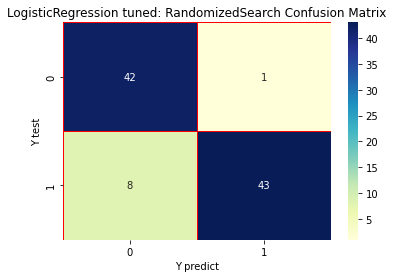

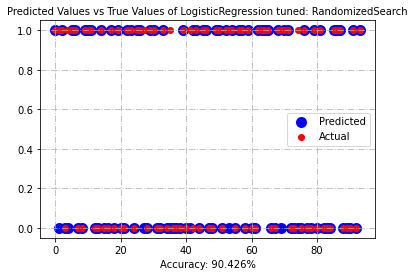

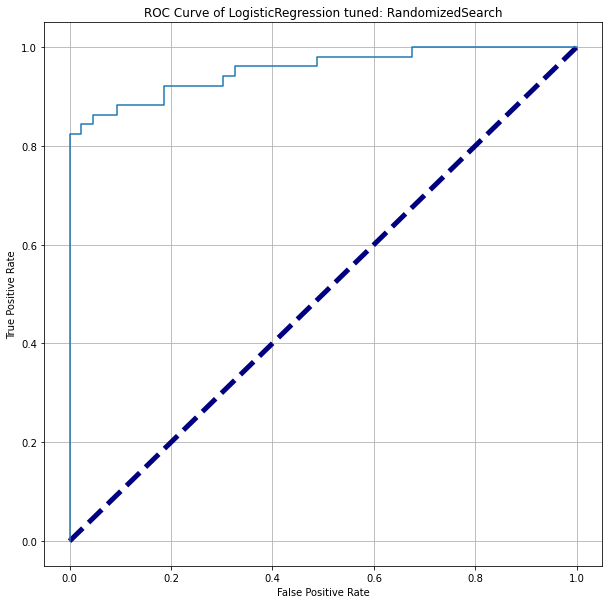

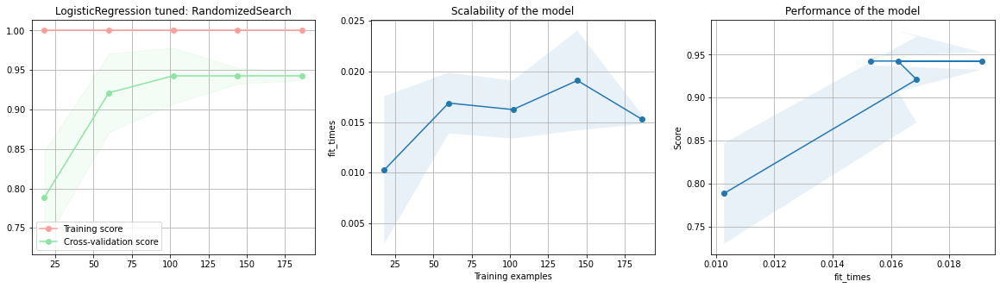

In [140]:
lr_best = LogisticRegression(penalty = lr_best_penalty, C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: RandomizedSearch", lr_best,data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Halving Grid Search

In [141]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingGridSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

tuning_time["model"] = "logistic Regression: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [142]:
tune_list 

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [143]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.4
The optimal value of solver is: saga
The optimal value of max_iter is: 500


LogisticRegression tuned: Halving Grid Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



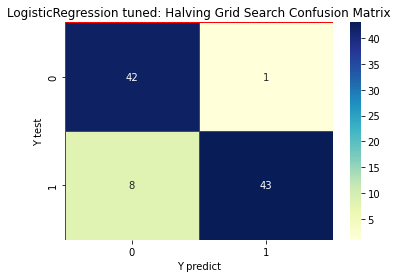

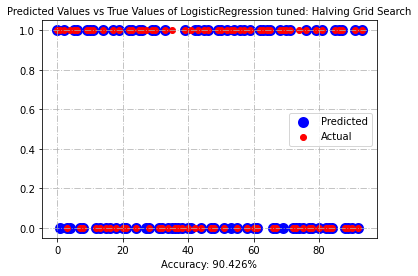

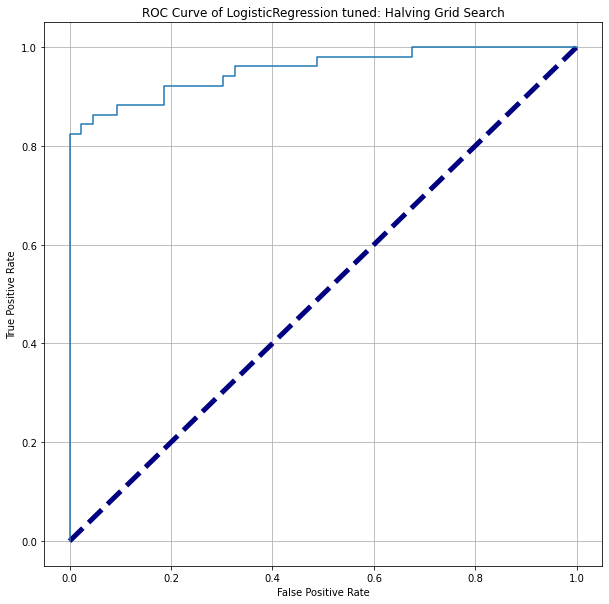

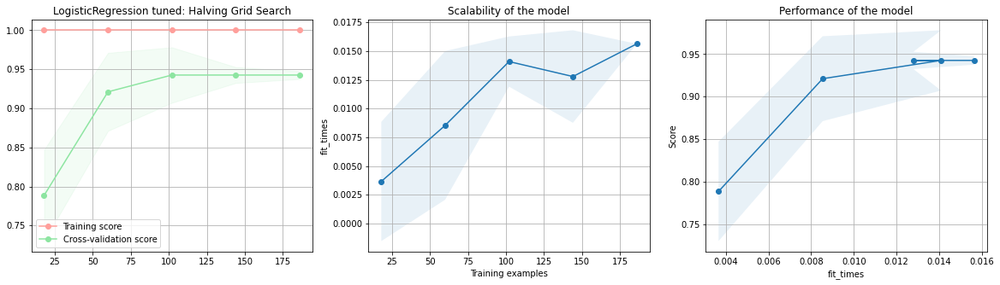

In [144]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Grid Search", lr_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

In [145]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

#### Halving Random Search

In [146]:
tuning_time = {}
lr = LogisticRegression(random_state = rs)
# Hyper-parameters tuning 
parameters = {'C' : [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0, 1.3, 1.5, 2], 'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 'max_iter' : [100, 200, 300, 500]}
cv = HalvingRandomSearchCV(lr, parameters, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
cv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

tuning_time["model"] = "logistic Regression: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = time.time() - start
tune_list.append(tuning_time)

In [147]:
tune_list

[{'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'None',
  'time': 22.34446907043457},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'None',
  'time': 0.24202322959899902},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'None',
  'time': 15.356570720672607},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'None',
  'time': 0.8638134002685547},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 5.260493278503418},
 {'model': 'logistic Regression: RandomizedSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.12917113304138184},
 {'model': 'logistic Regression: HalvingGridSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 3.424818992614746},
 {'model': 'logistic Regression: HalvingRandomSearch CV',
  'scaling': 'Min-Max Scaler',
  'time': 0.31249141693115234},
 {'model': 'logistic Regression: Gridsearch CV',
  'scaling': 'Standard Scaler',
  'time': 4.803036689758301

In [148]:
# Get the best parameters
lr_best_C = cv.best_params_["C"]
lr_best_solver = cv.best_params_["solver"]
lr_best_max_iter = cv.best_params_["max_iter"]
print(f'The optimal value of C is: {lr_best_C}')
print(f'The optimal value of solver is: {lr_best_solver}')
print(f'The optimal value of max_iter is: {lr_best_max_iter}')

The optimal value of C is: 0.2
The optimal value of solver is: lbfgs
The optimal value of max_iter is: 500


LogisticRegression tuned: Halving Random Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



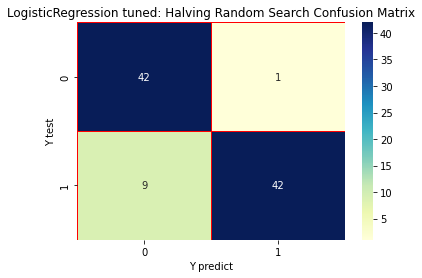

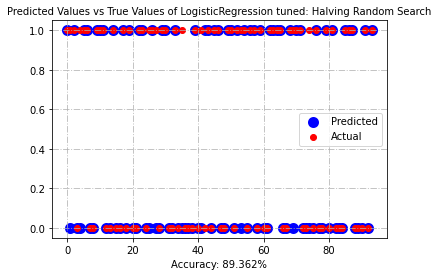

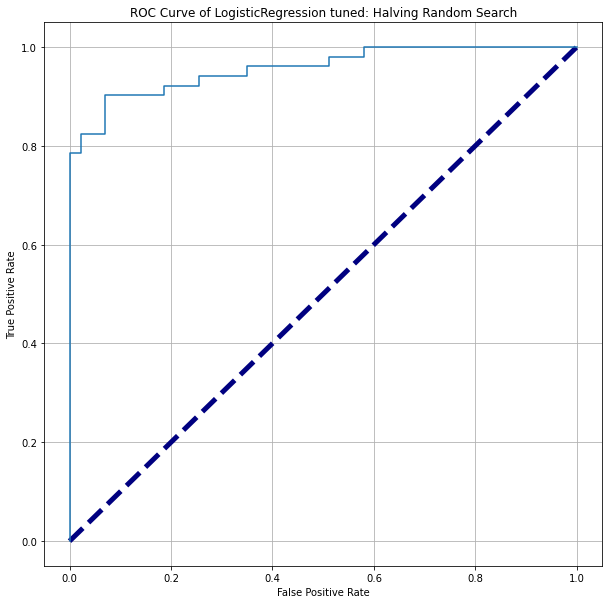

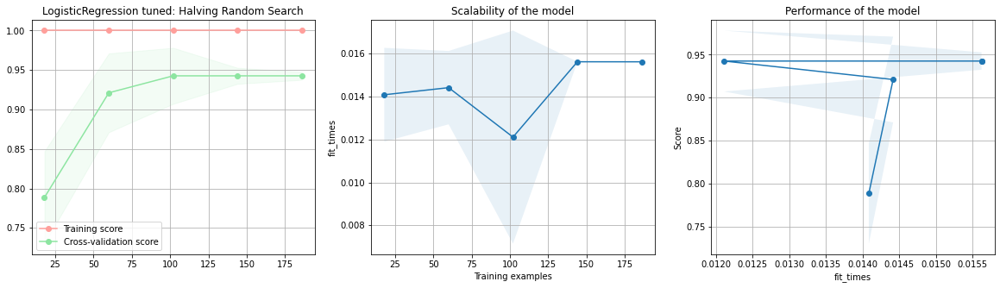

In [149]:
lr_best = LogisticRegression(C = lr_best_C, solver = lr_best_solver, max_iter = lr_best_max_iter, random_state = rs)
run_model("LogisticRegression tuned: Halving Random Search", lr_best,data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

In [150]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

## Tree based models

### Decision Tree 

DecisionTree
None
              precision    recall  f1-score   support

           0       0.86      0.88      0.87        43
           1       0.90      0.88      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.88      0.88        94
weighted avg       0.88      0.88      0.88        94



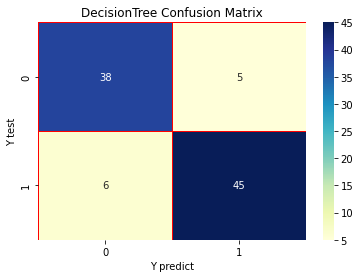

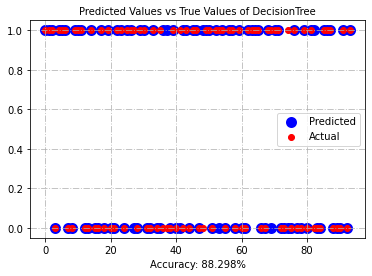

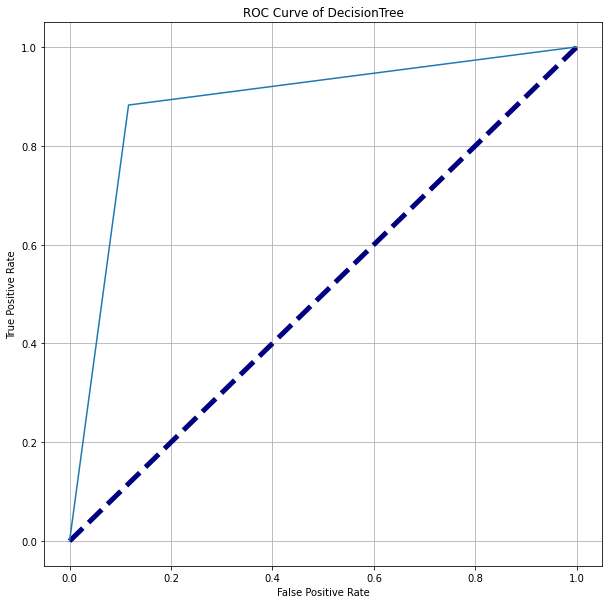

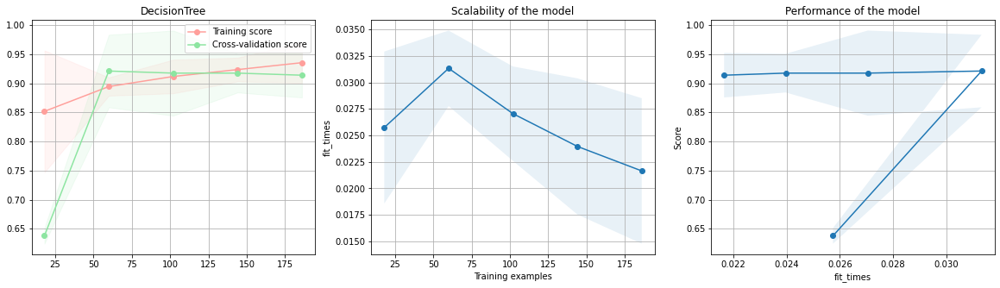

In [151]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### max_depth tuning

In [152]:
# # Find optimal depth of trees
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['notrans'][0].iloc[train_idx], data_list['notrans'][0].iloc[test_idx], data_list['notrans'][2].iloc[train_idx], data_list['notrans'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree depth tuning"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

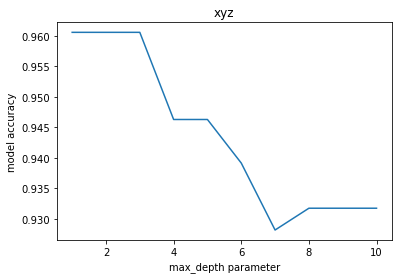

In [153]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [154]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

3


In [155]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['notrans'][0], data_list['notrans'][2])

DecisionTreeClassifier(max_depth=3, random_state=42)

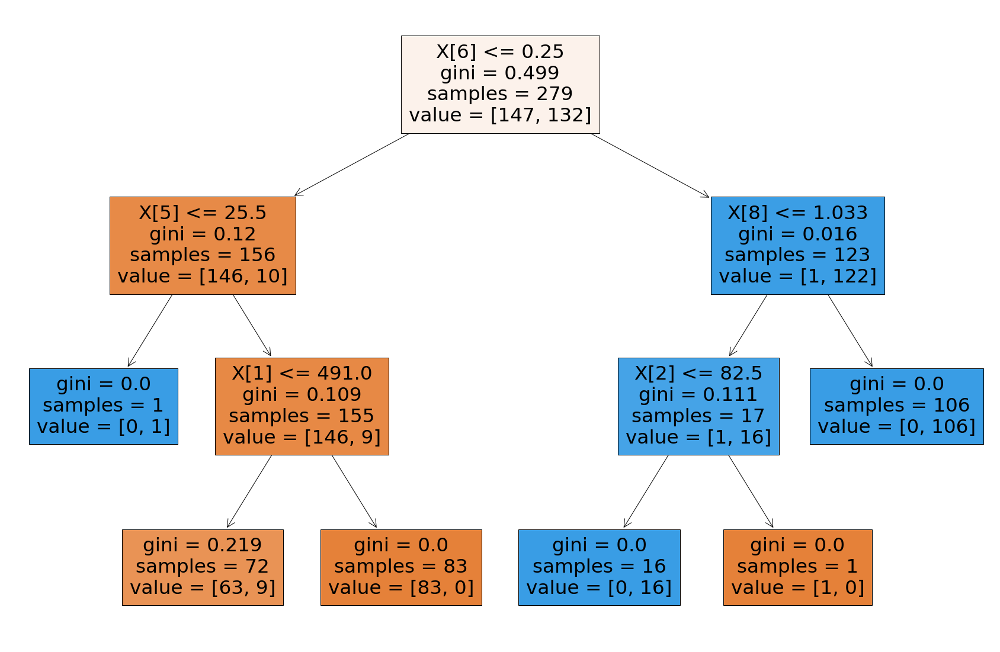

In [156]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



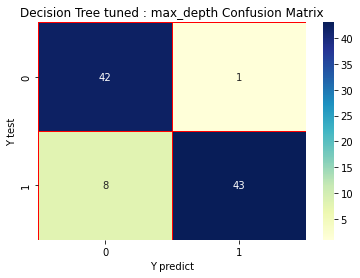

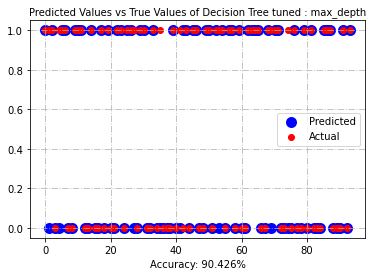

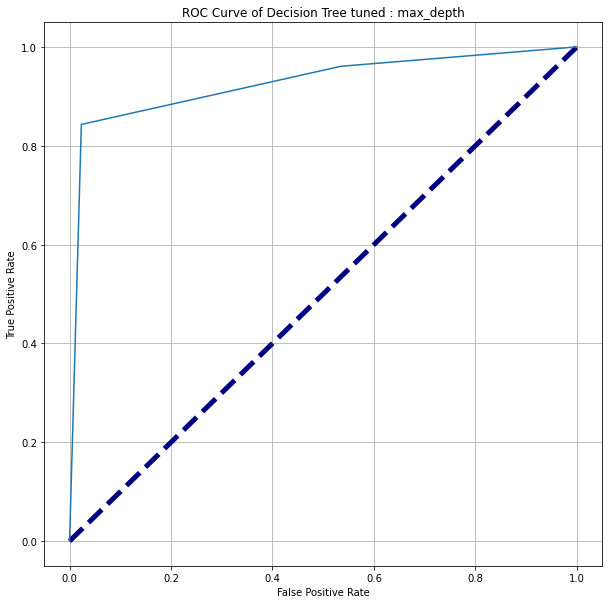

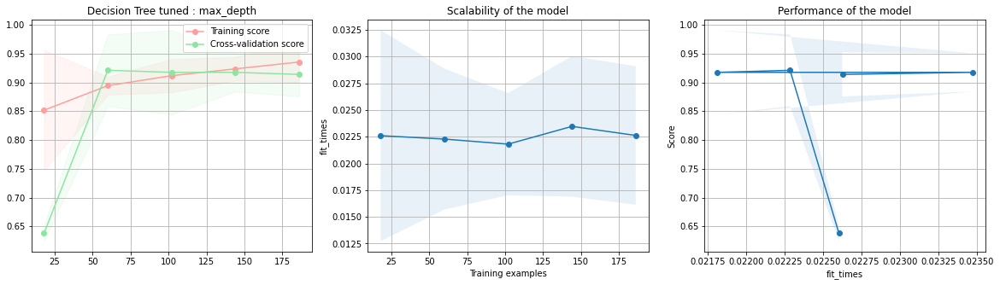

In [157]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Tuning using  pruning

In [158]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['notrans'][0], data_list['notrans'][2])

DecisionTreeClassifier(random_state=42)

In [159]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['notrans'][0], data_list['notrans'][2])
ccp_alphas = path.ccp_alphas

In [160]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['notrans'][0], data_list['notrans'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



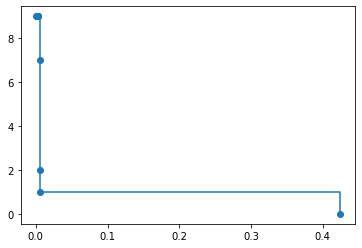

In [161]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [162]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['notrans'][0].iloc[train_idx], \
        data_list['notrans'][0].iloc[test_idx], data_list['notrans'][2].iloc[train_idx], \
        data_list['notrans'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree alpha tuning"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [163]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.006319390710649797


In [164]:
# Fit the new model
dtree_bestalpha = DecisionTreeClassifier(ccp_alpha = best_ccp_alpha, random_state = rs)
dtree_bestalpha.fit(data_list['notrans'][0], data_list['notrans'][2])

DecisionTreeClassifier(ccp_alpha=0.006319390710649797, random_state=42)

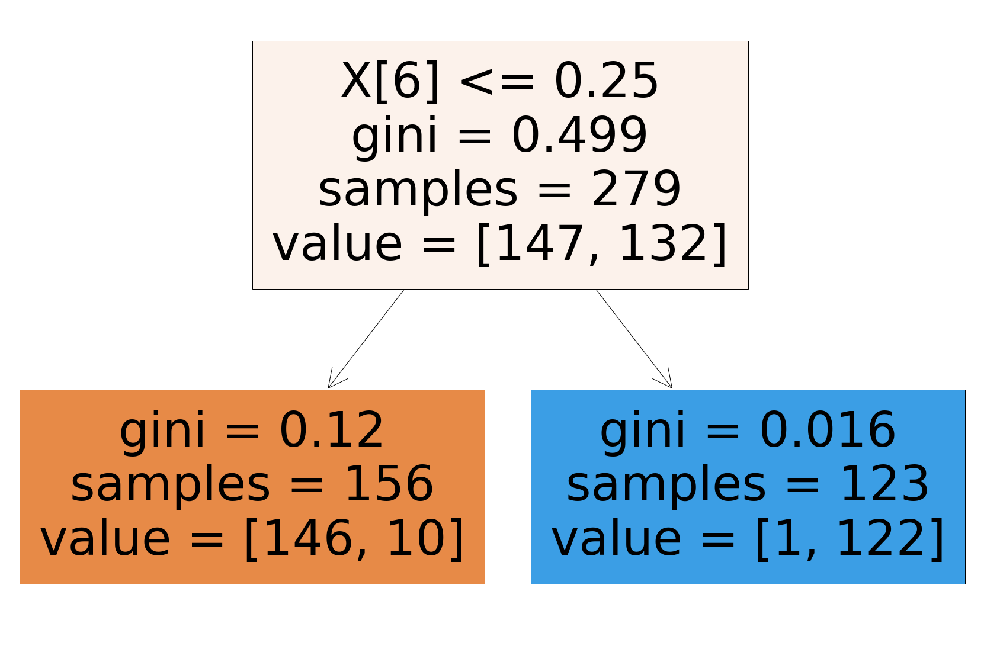

In [165]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



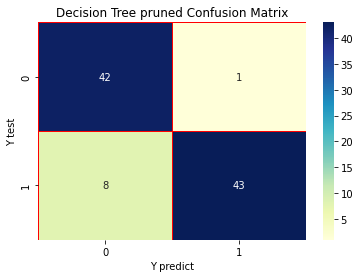

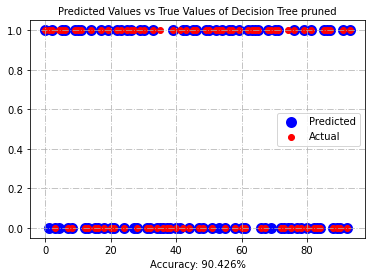

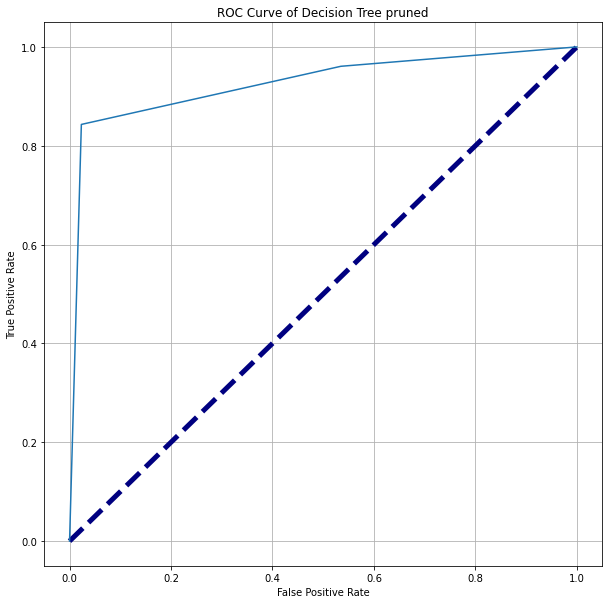

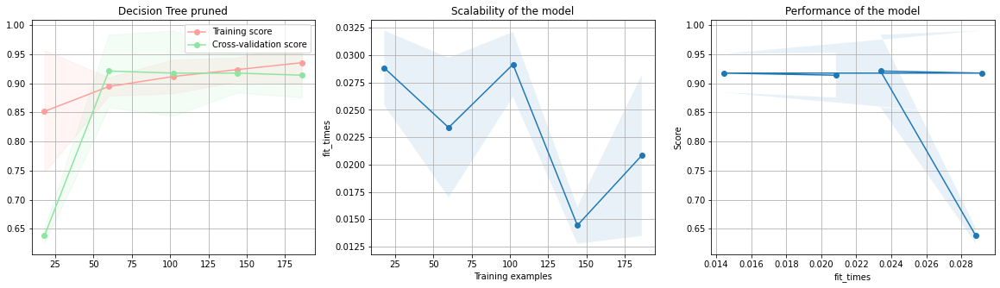

In [166]:
run_model("Decision Tree pruned", dtree_bestdepth, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

In [167]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Decision Tree with min max scaler

DecisionTree
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.86      0.88      0.87        43
           1       0.90      0.88      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.88      0.88        94
weighted avg       0.88      0.88      0.88        94



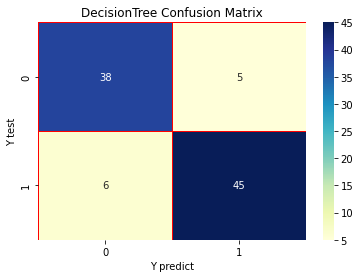

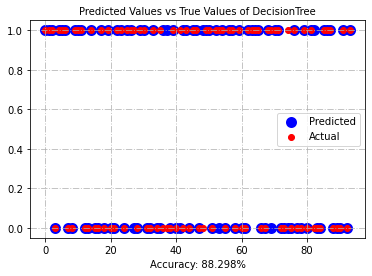

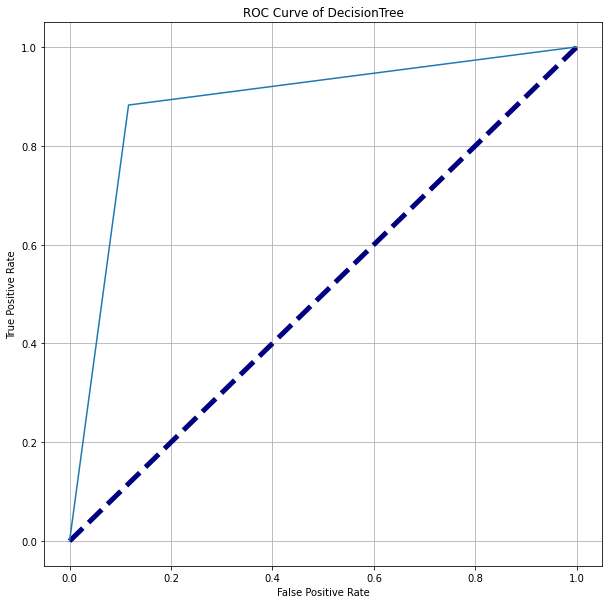

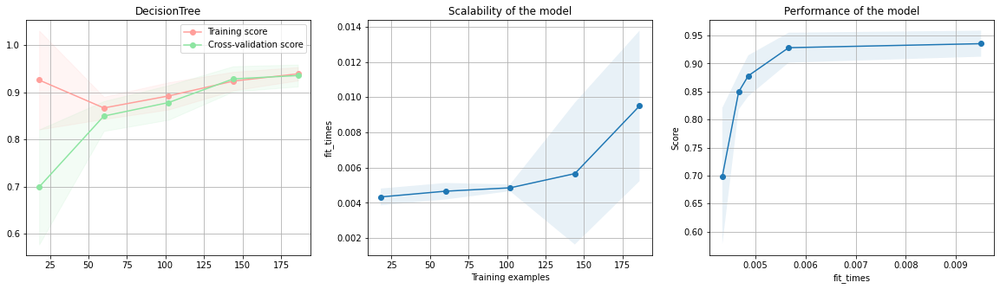

In [168]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

In [169]:
# # Find optimal depth of trees
tuning_time = {}
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['minmax_scaler'][0].iloc[train_idx], \
        data_list['minmax_scaler'][0].iloc[test_idx], data_list['minmax_scaler'][2].iloc[train_idx], \
        data_list['minmax_scaler'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree depth tuning"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

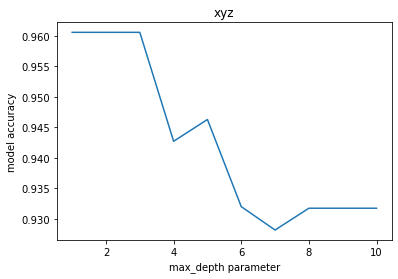

In [170]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [171]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

3


In [172]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

DecisionTreeClassifier(max_depth=3, random_state=42)

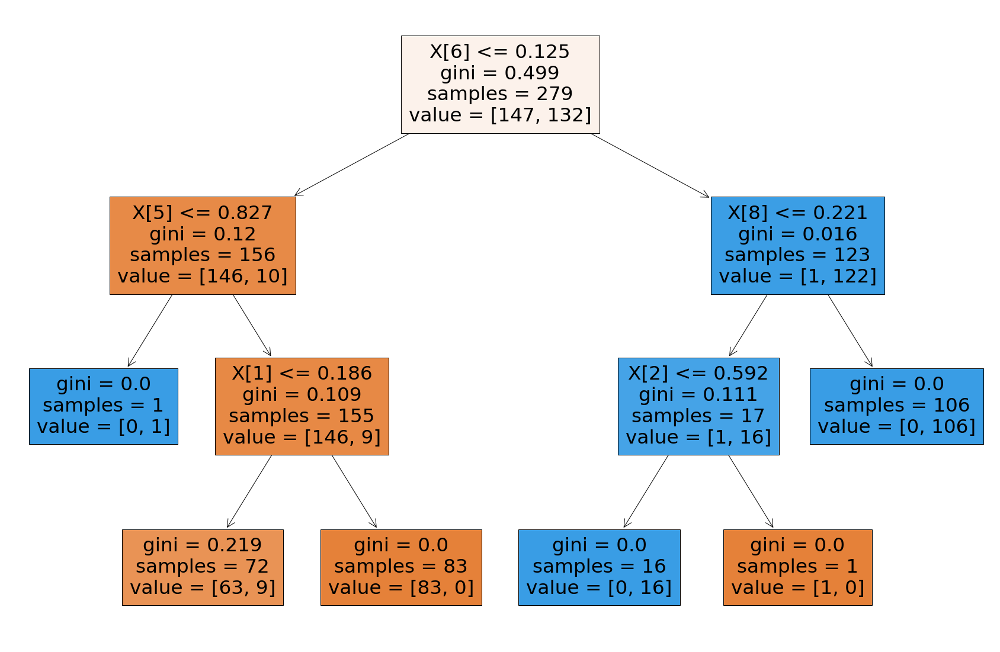

In [173]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



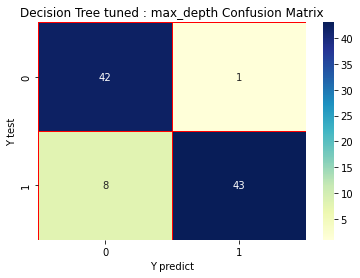

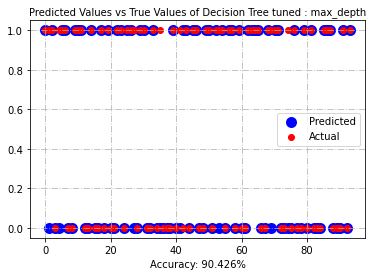

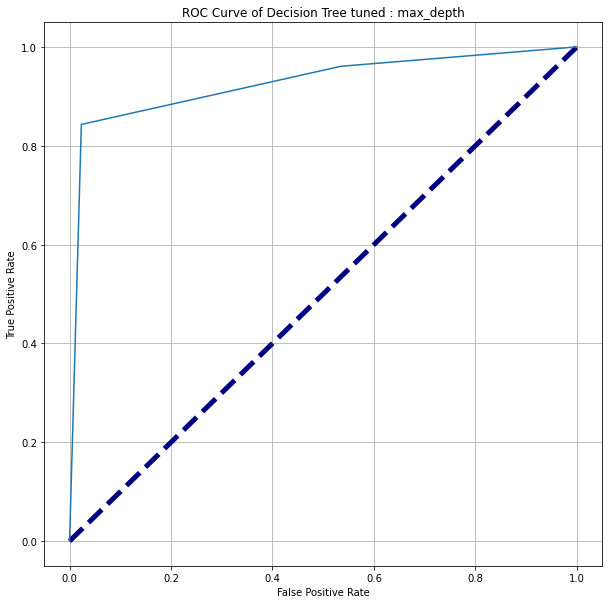

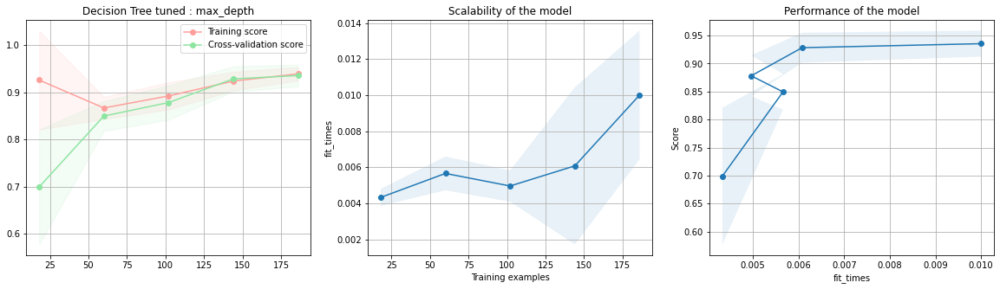

In [174]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Tuning using  pruning

In [175]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

DecisionTreeClassifier(random_state=42)

In [176]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
ccp_alphas = path.ccp_alphas

In [177]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



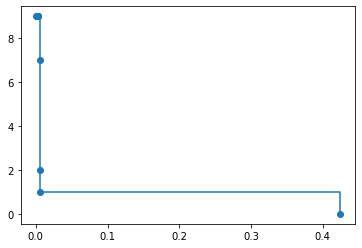

In [178]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [179]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['minmax_scaler'][0].iloc[train_idx], \
        data_list['minmax_scaler'][0].iloc[test_idx], data_list['minmax_scaler'][2].iloc[train_idx], \
        data_list['minmax_scaler'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree alpha tuning"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [180]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.006319390710649797


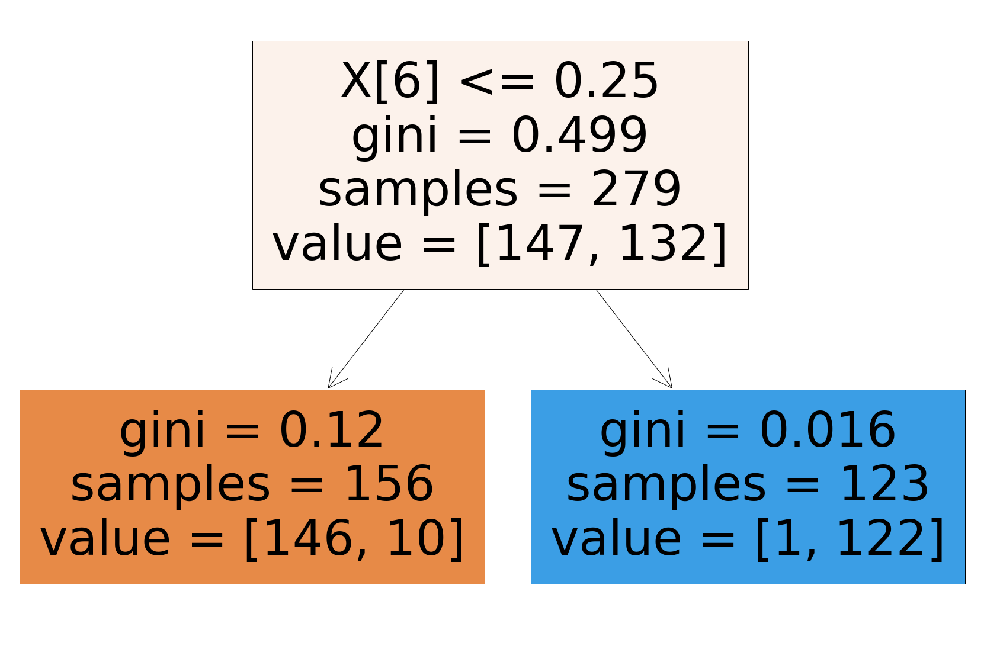

In [181]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



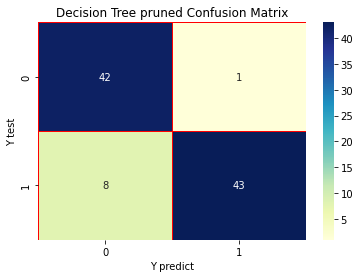

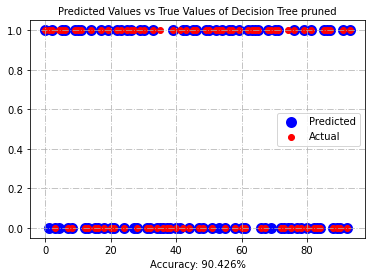

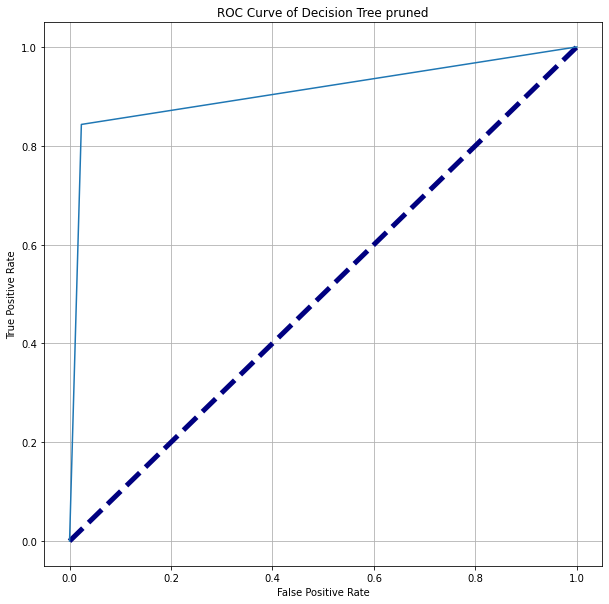

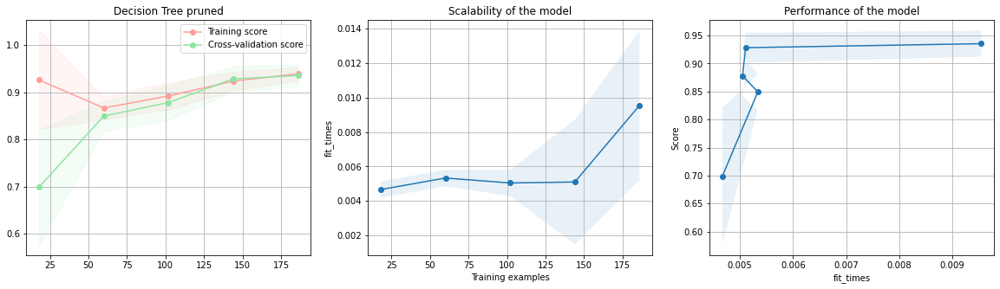

In [182]:
run_model("Decision Tree pruned", dtree_bestalpha, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

In [183]:
list_scores

[{'Model Name': 'LogisticRegression',
  'Feature Scaling': 'None',
  'Accuracy': 0.851063829787234,
  'Recall': 0.803921568627451,
  'Precision': 0.9111111111111111,
  'F1': 0.8541666666666666,
  'training time (ms)': 31.24833106994629},
 {'Model Name': 'LogisticRegression tuned: Gridsearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 6.004810333251953},
 {'Model Name': 'LogisticRegression tuned: RandomizedSearch',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time (ms)': 39.99590873718262},
 {'Model Name': 'LogisticRegression tuned: Halving Grid Search',
  'Feature Scaling': 'None',
  'Accuracy': 0.9042553191489362,
  'Recall': 0.8431372549019608,
  'Precision': 0.9772727272727273,
  'F1': 0.9052631578947369,
  'training time 

### Decision Tree with standard scaler

DecisionTree
Standard Scaler
              precision    recall  f1-score   support

           0       0.86      0.88      0.87        43
           1       0.90      0.88      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.88      0.88        94
weighted avg       0.88      0.88      0.88        94



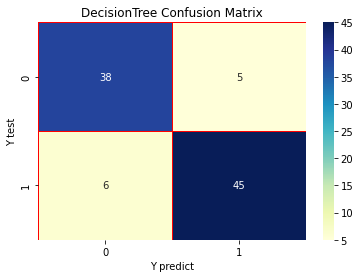

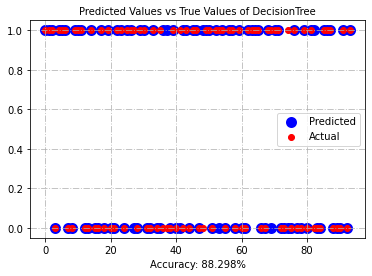

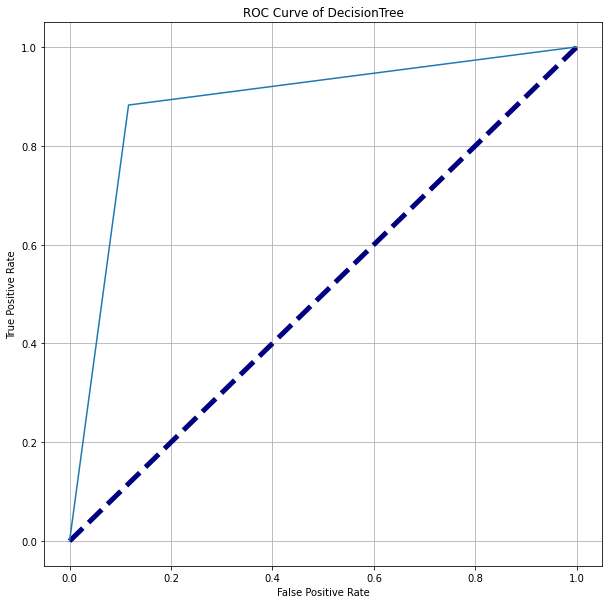

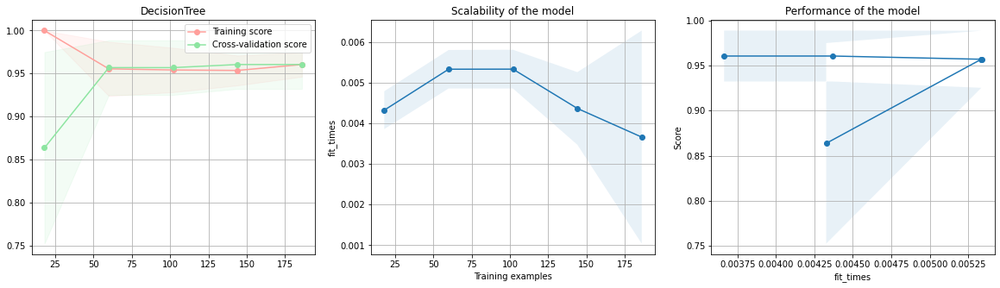

In [184]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

In [185]:
# # Find optimal depth of trees
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['standard_scaler'][0], data_list['standard_scaler'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['standard_scaler'][0].iloc[train_idx], \
        data_list['standard_scaler'][0].iloc[test_idx], data_list['standard_scaler'][2].iloc[train_idx], \
        data_list['standard_scaler'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree: depth tuning"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

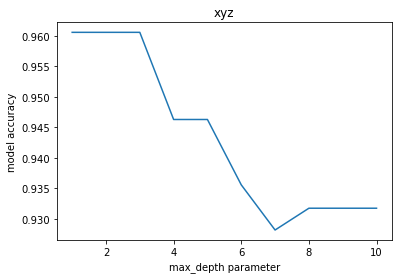

In [186]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [187]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

3


In [188]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

DecisionTreeClassifier(max_depth=3, random_state=42)

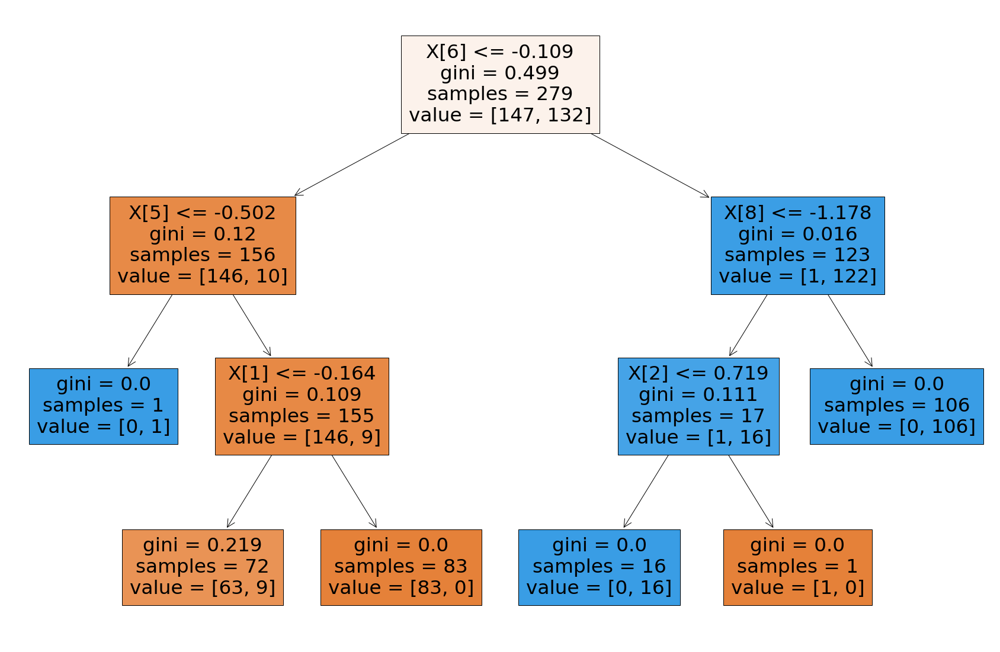

In [189]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



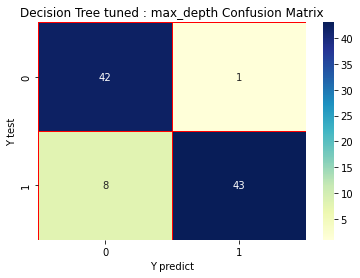

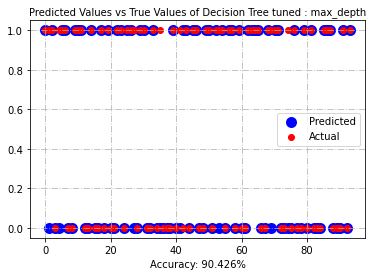

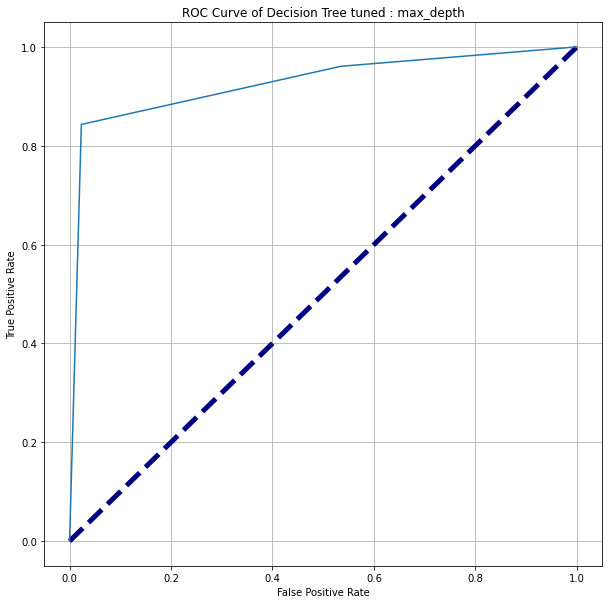

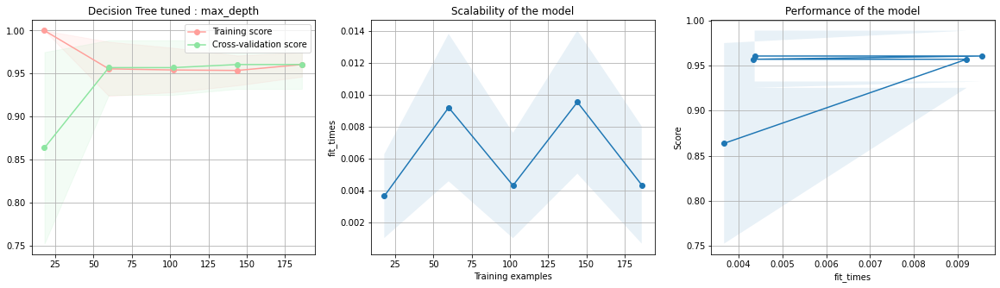

In [190]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Tuning using  pruning

In [191]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

DecisionTreeClassifier(random_state=42)

In [192]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
ccp_alphas = path.ccp_alphas

In [193]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



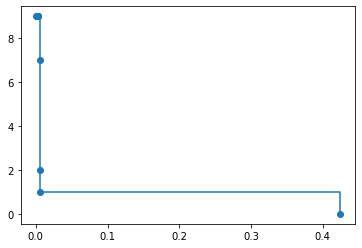

In [194]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [195]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['standard_scaler'][0].iloc[train_idx], \
        data_list['standard_scaler'][0].iloc[test_idx], data_list['standard_scaler'][2].iloc[train_idx], \
        data_list['standard_scaler'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree: alpha tuning"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [196]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.006319390710649797


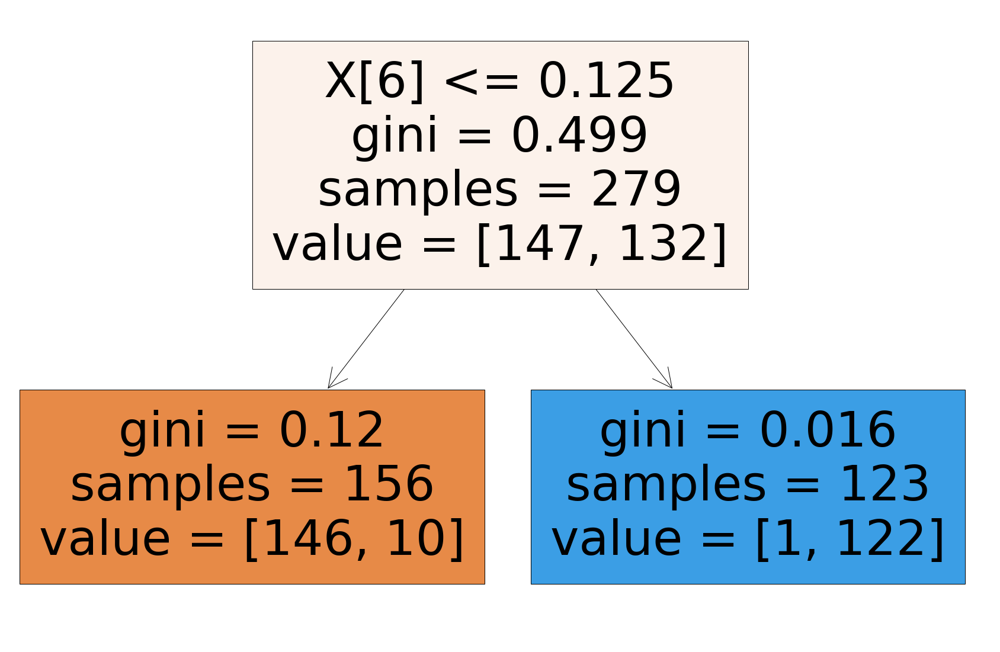

In [197]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



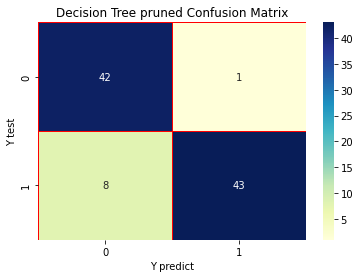

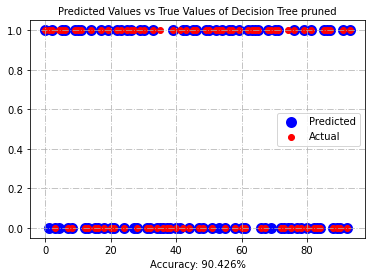

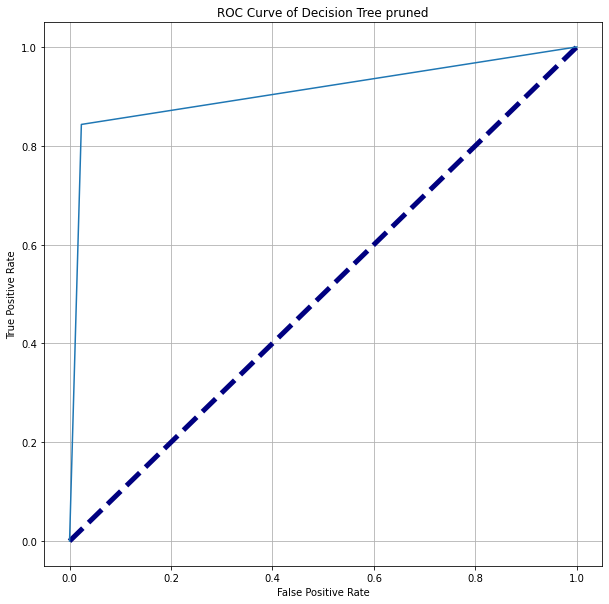

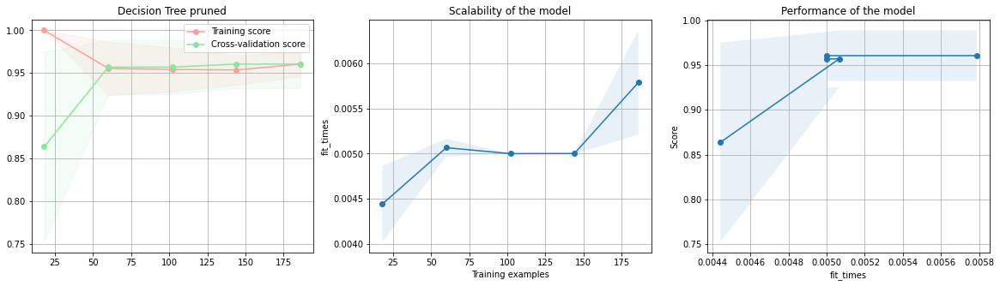

In [198]:
run_model("Decision Tree pruned", dtree_bestalpha, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler"
, list_scores = list_scores)

### Decision Tree with polynomial transformation

DecisionTree
Polynomial
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



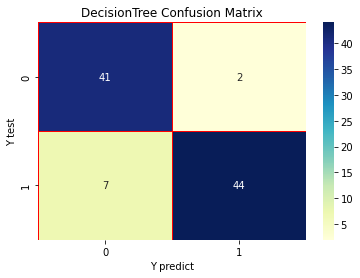

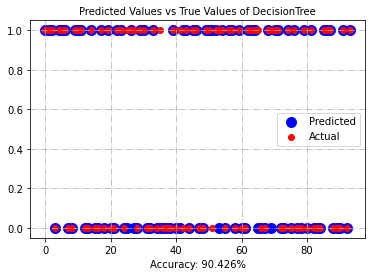

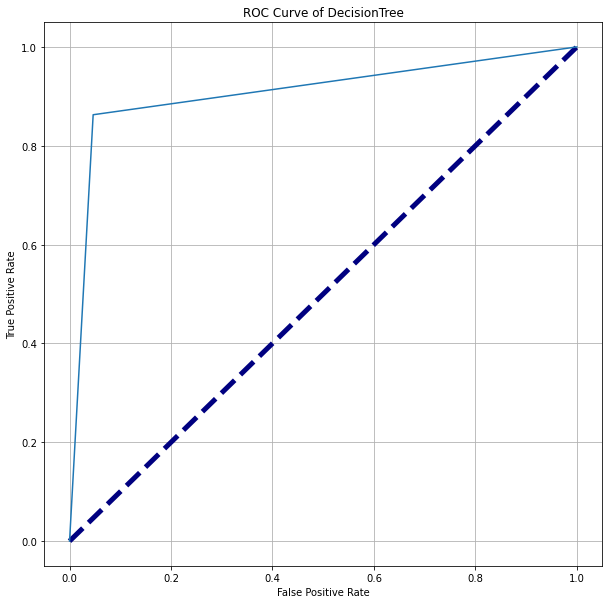

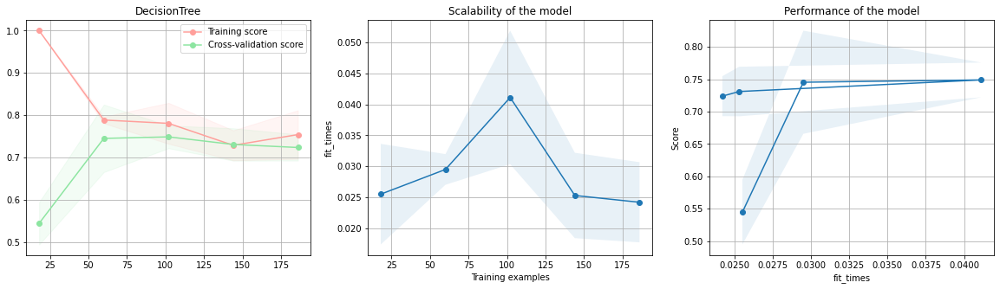

In [199]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

In [200]:
# # Find optimal depth of trees
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['poly_normal'][0], data_list['poly_normal'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_normal'][0].iloc[train_idx], \
        data_list['poly_normal'][0].iloc[test_idx], data_list['poly_normal'][2].iloc[train_idx], \
        data_list['poly_normal'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree: depth tuning"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

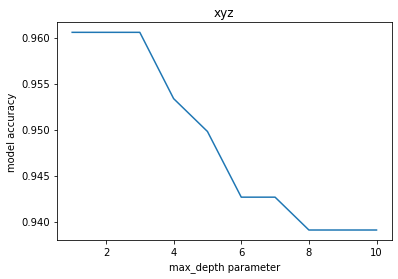

In [201]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [202]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

3


In [203]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

DecisionTreeClassifier(max_depth=3, random_state=42)

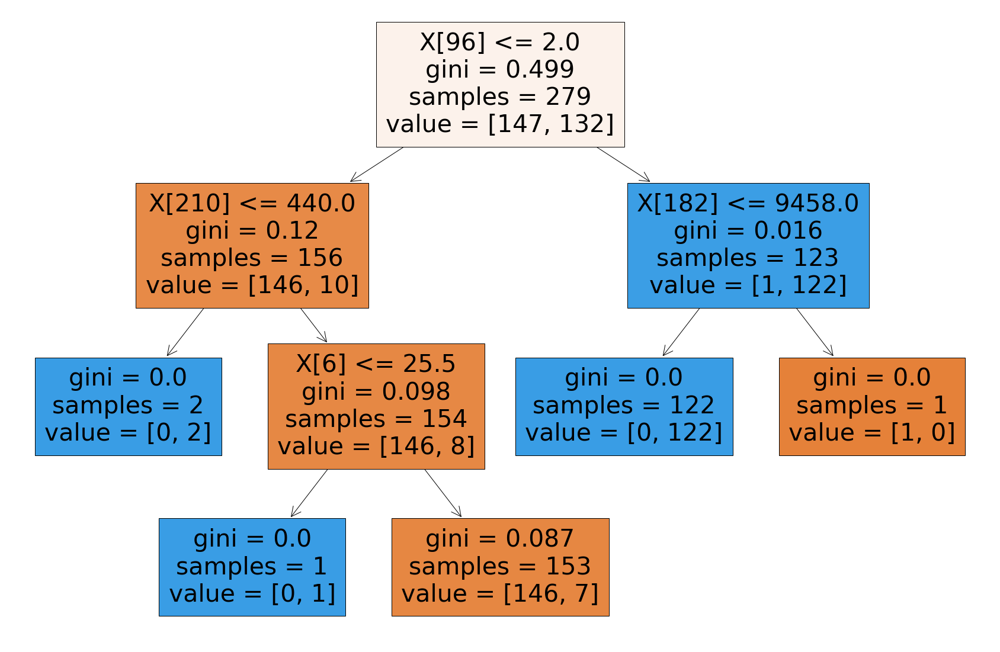

In [204]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
Polynomial
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



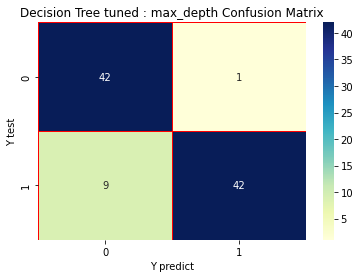

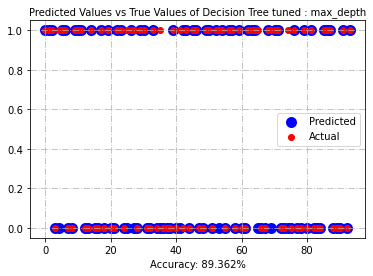

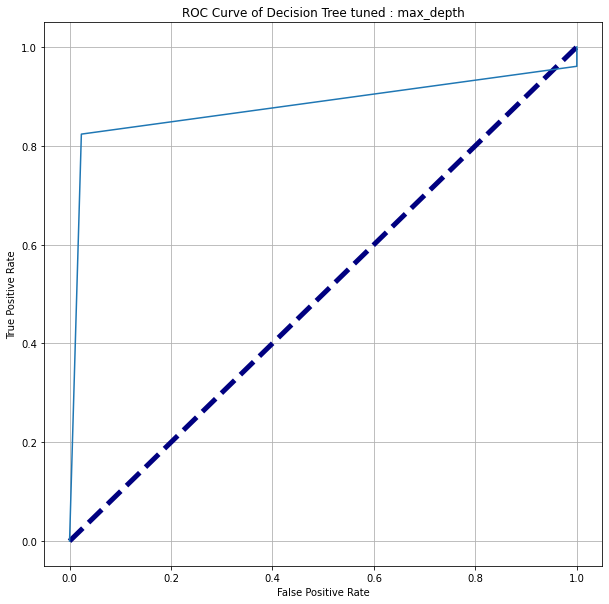

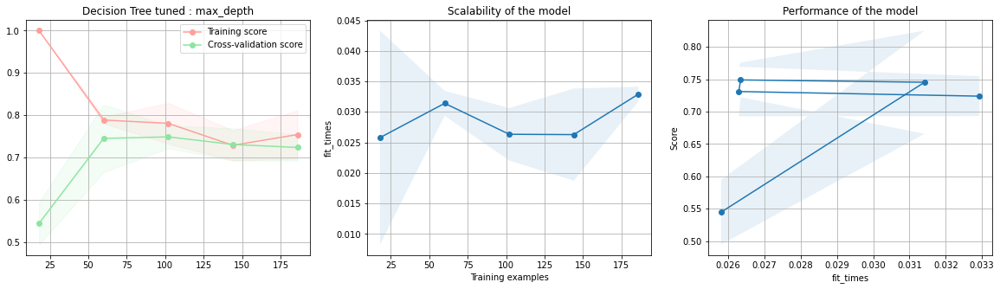

In [205]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Tuning using  pruning

In [206]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

DecisionTreeClassifier(random_state=42)

In [207]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['poly_normal'][0], data_list['poly_normal'][2])
ccp_alphas = path.ccp_alphas

In [208]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



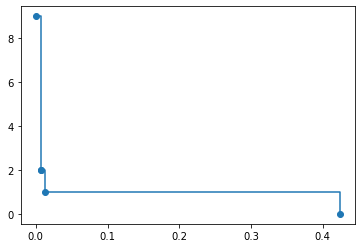

In [209]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [210]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_normal'][0].iloc[train_idx], \
        data_list['poly_normal'][0].iloc[test_idx], data_list['poly_normal'][2].iloc[train_idx], \
        data_list['poly_normal'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree: alpha tuning"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [211]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.012720851430528868


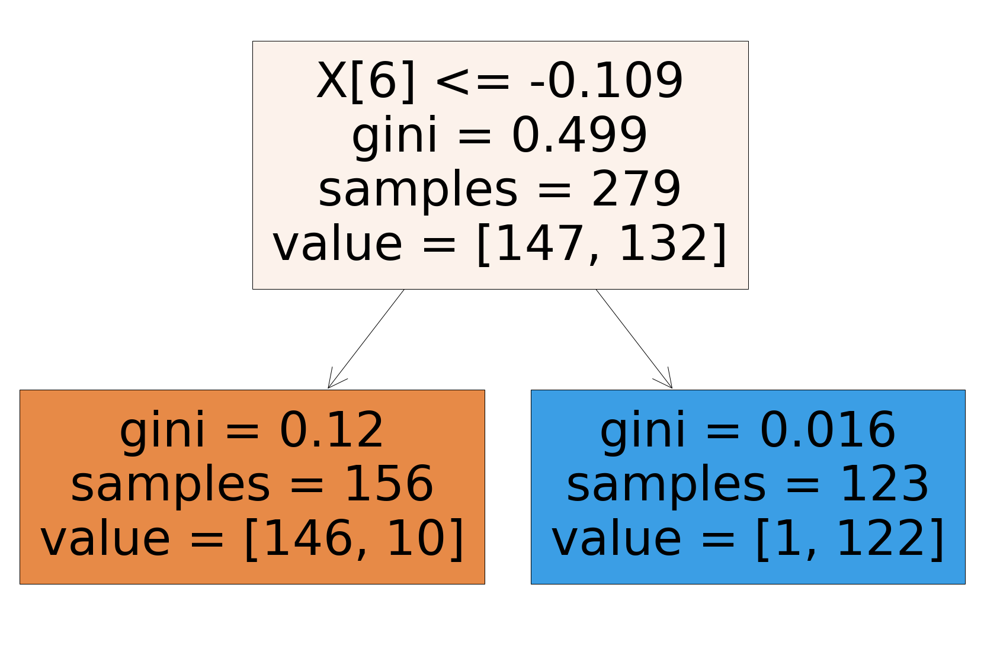

In [212]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
Polynomial
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



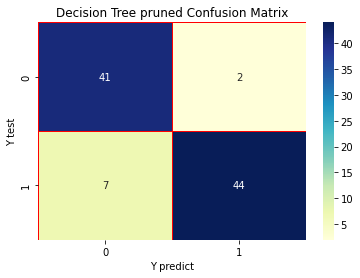

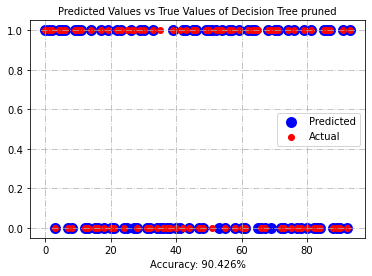

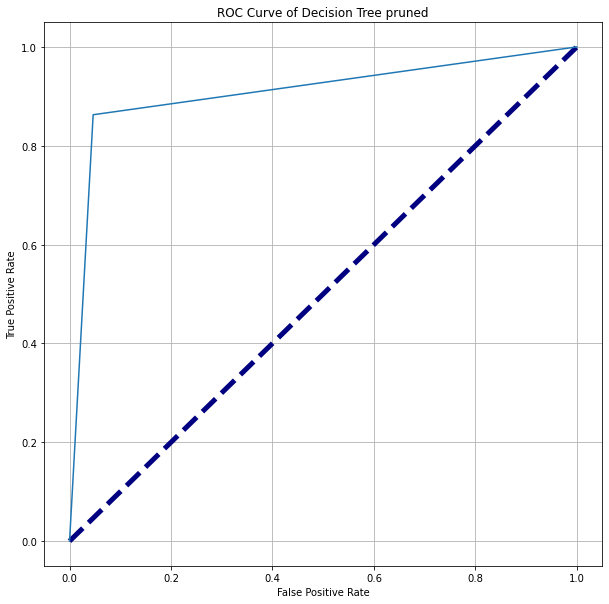

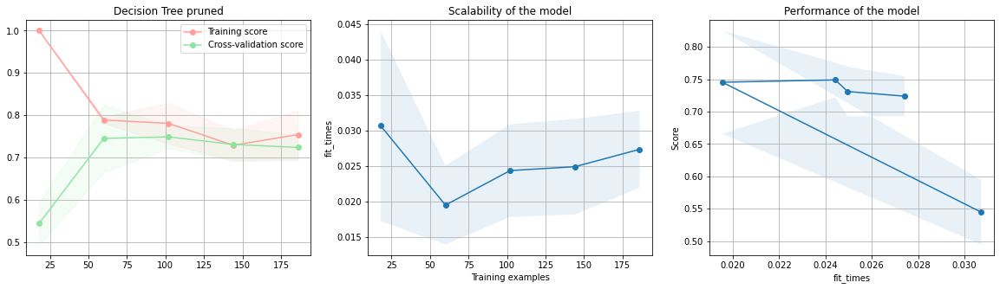

In [213]:
run_model("Decision Tree pruned", dtree_bestalpha, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

### Decision Tree with Min Max polynomial transformation

DecisionTree
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.80      0.86      0.83        43
           1       0.88      0.82      0.85        51

    accuracy                           0.84        94
   macro avg       0.84      0.84      0.84        94
weighted avg       0.84      0.84      0.84        94



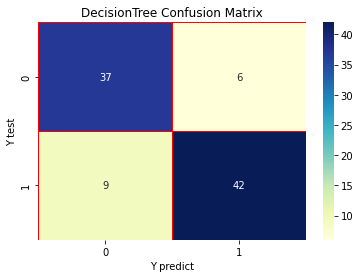

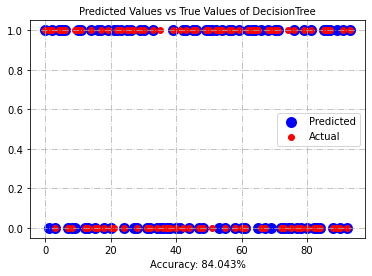

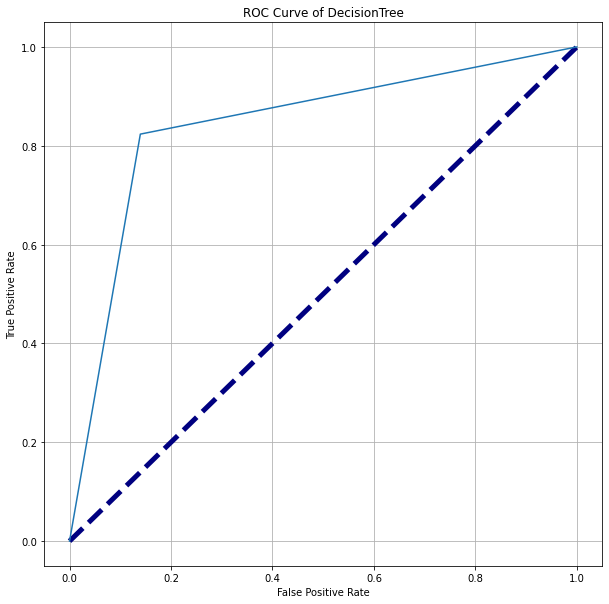

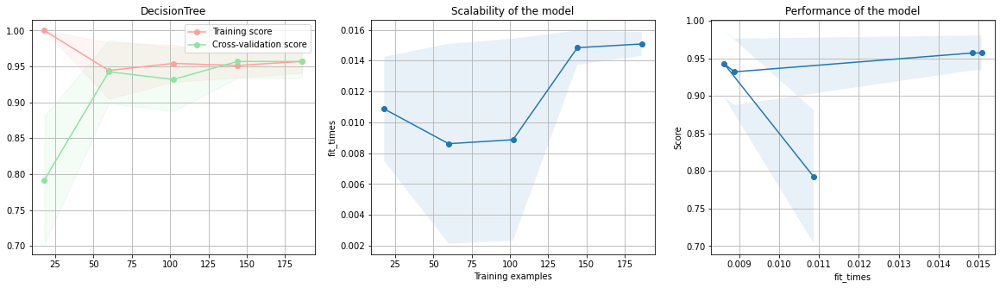

In [214]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

In [215]:
# # Find optimal depth of trees
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['poly_minmax'][0], data_list['poly_minmax'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_minmax'][0].iloc[train_idx], \
        data_list['poly_minmax'][0].iloc[test_idx], data_list['poly_minmax'][2].iloc[train_idx], \
        data_list['poly_minmax'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree: depth tuning"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

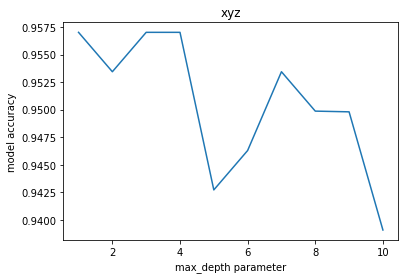

In [216]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [217]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

4


In [218]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

DecisionTreeClassifier(max_depth=4, random_state=42)

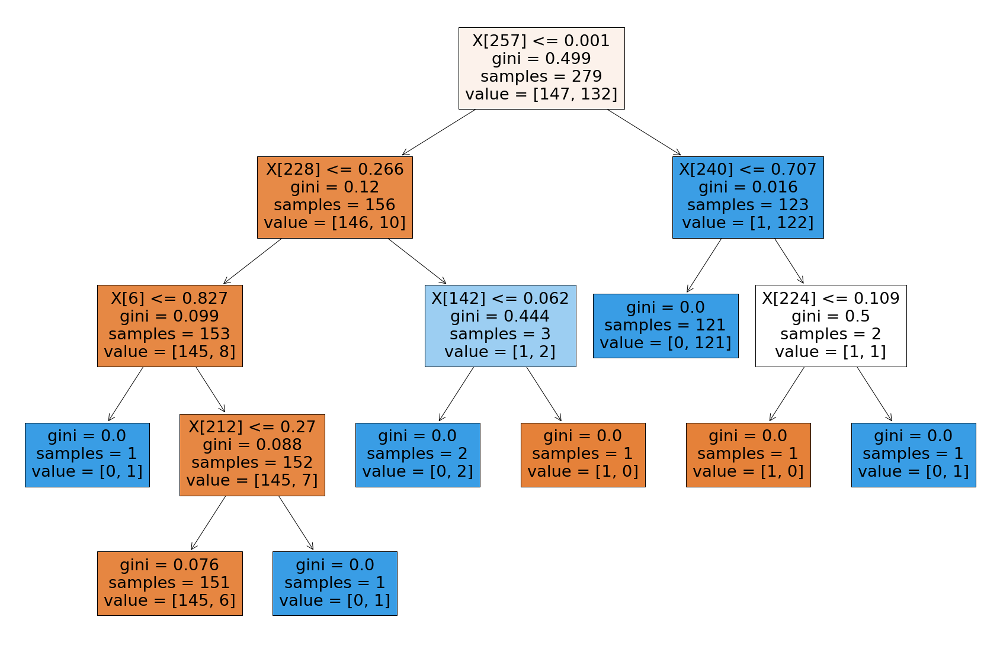

In [219]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.95      0.89        43
           1       0.96      0.84      0.90        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.90      0.89      0.89        94



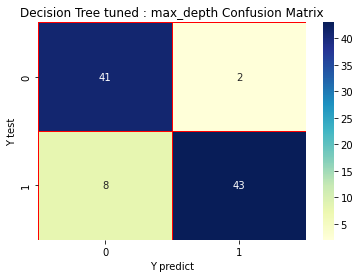

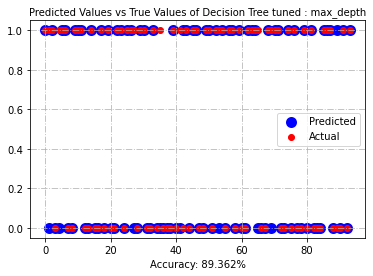

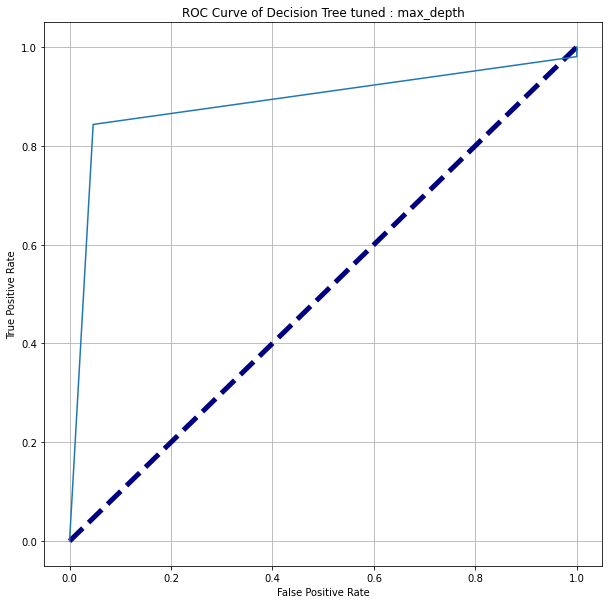

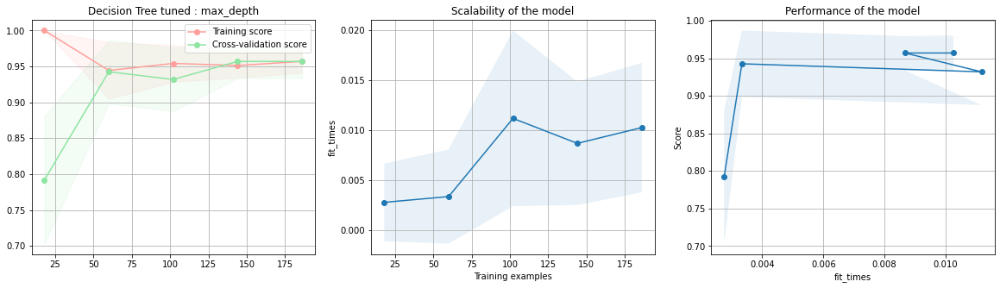

In [220]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Tuning using  pruning

In [221]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

DecisionTreeClassifier(random_state=42)

In [222]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
ccp_alphas = path.ccp_alphas

In [223]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



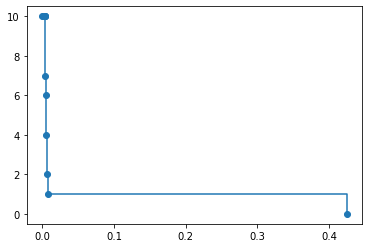

In [224]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [225]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_minmax'][0].iloc[train_idx], \
        data_list['poly_minmax'][0].iloc[test_idx], data_list['poly_minmax'][2].iloc[train_idx], \
        data_list['poly_minmax'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree: alpha tuning"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [226]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.0065236915499344884


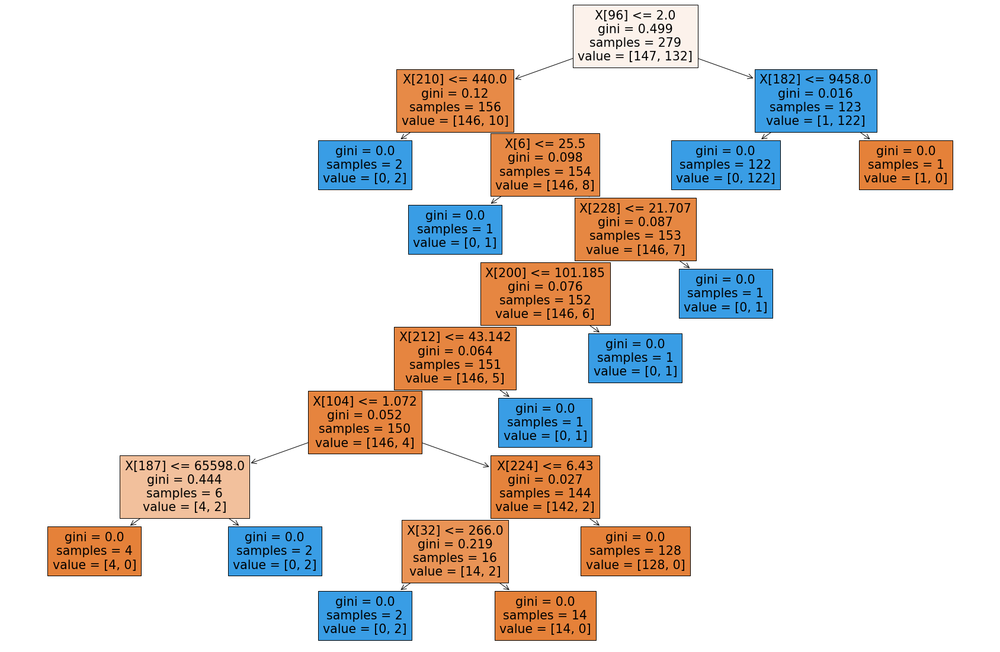

In [227]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



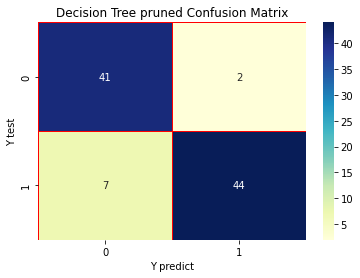

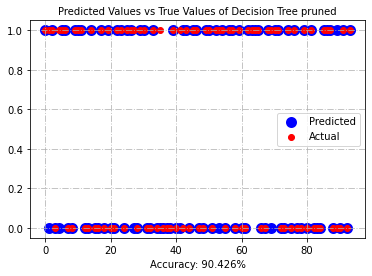

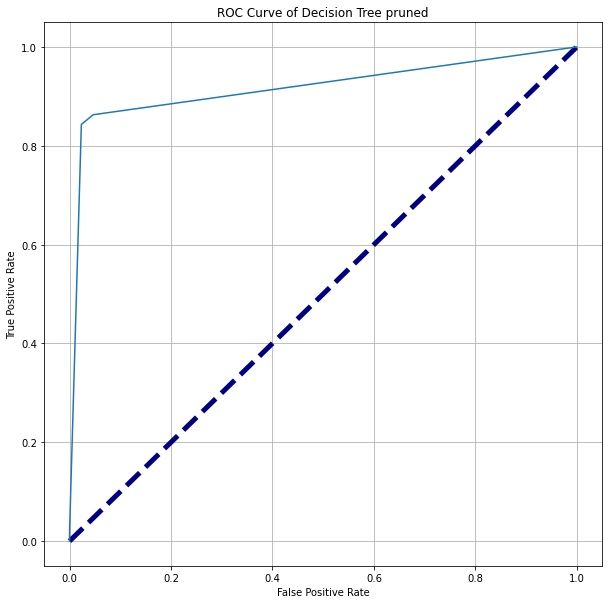

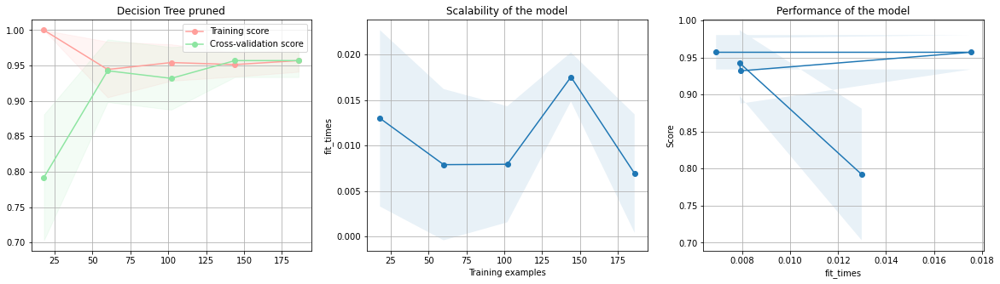

In [228]:
run_model("Decision Tree pruned", dtree_bestalpha, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

### Decision Tree with Standard Scaler polynomial transformation

DecisionTree
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.83      0.93      0.88        43
           1       0.93      0.84      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.89      0.88        94
weighted avg       0.89      0.88      0.88        94



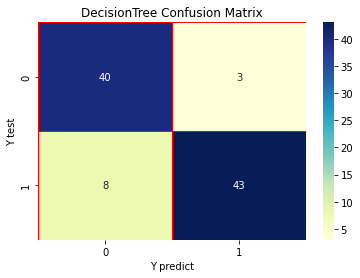

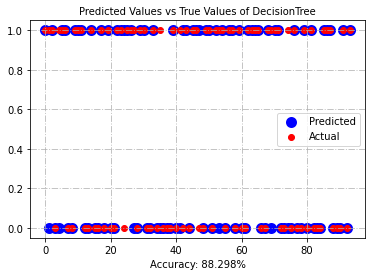

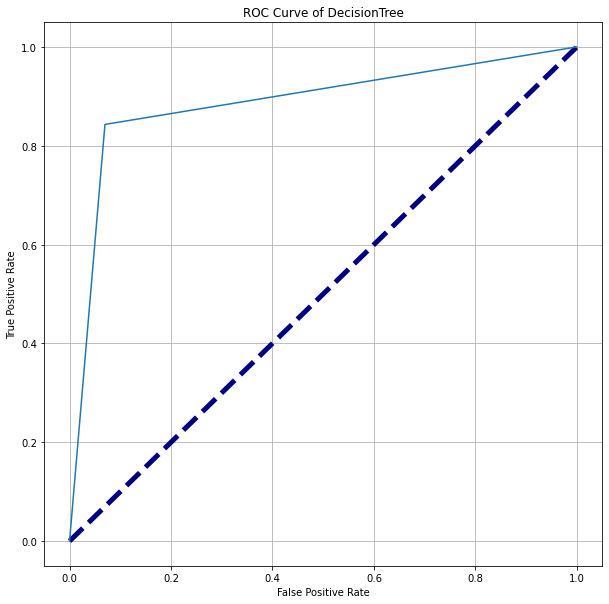

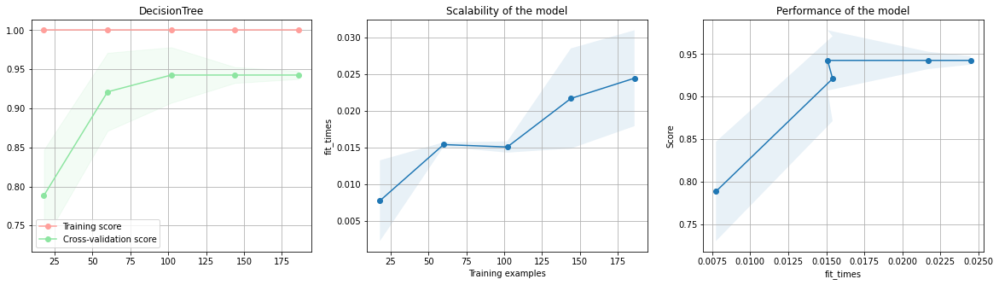

In [229]:
dtree = DecisionTreeClassifier(random_state = rs)

run_model("DecisionTree", dtree, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

In [230]:
# # Find optimal depth of trees
max_depth_arr = np.arange(1, 11)
depth_acc_dict = {}
start = time.time()
for d in max_depth_arr:
    dtree = DecisionTreeClassifier(max_depth = d, random_state = rs)
    kf = KFold(n_splits=5)
    dt_score_list = []
    
    for train_idx, test_idx in kf.split(data_list['poly_standard'][0], data_list['poly_standard'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_standard'][0].iloc[train_idx], \
        data_list['poly_standard'][0].iloc[test_idx], data_list['poly_standard'][2].iloc[train_idx], \
        data_list['poly_standard'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        dt_score_list.append(dt_acc)
        
        depth_acc_dict[d] = np.mean(dt_score_list)
        
end = time.time() - start
tuning_time["model"] = "DecisionTree: depth tuning"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

Text(0.5, 1.0, 'xyz')

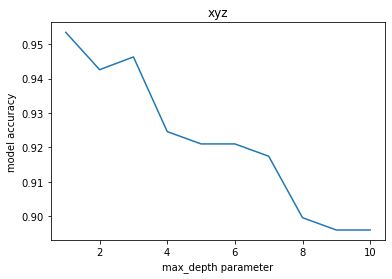

In [231]:
#Plot the variation of cross validation accuracy wrt max_depth
plt.plot(depth_acc_dict.keys(), depth_acc_dict.values())
plt.xlabel('max_depth parameter')
plt.ylabel('model accuracy')
plt.title('xyz')

In [232]:
# Find the best depth
best_maxdepth_dt = max(zip(depth_acc_dict.values(), depth_acc_dict.keys()))[1]
print(best_maxdepth_dt)

1


In [233]:
# Fit a new model wtih best depth found above
# Your code here
dtree_bestdepth = DecisionTreeClassifier(max_depth = best_maxdepth_dt, random_state = rs)
dtree_bestdepth.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

DecisionTreeClassifier(max_depth=1, random_state=42)

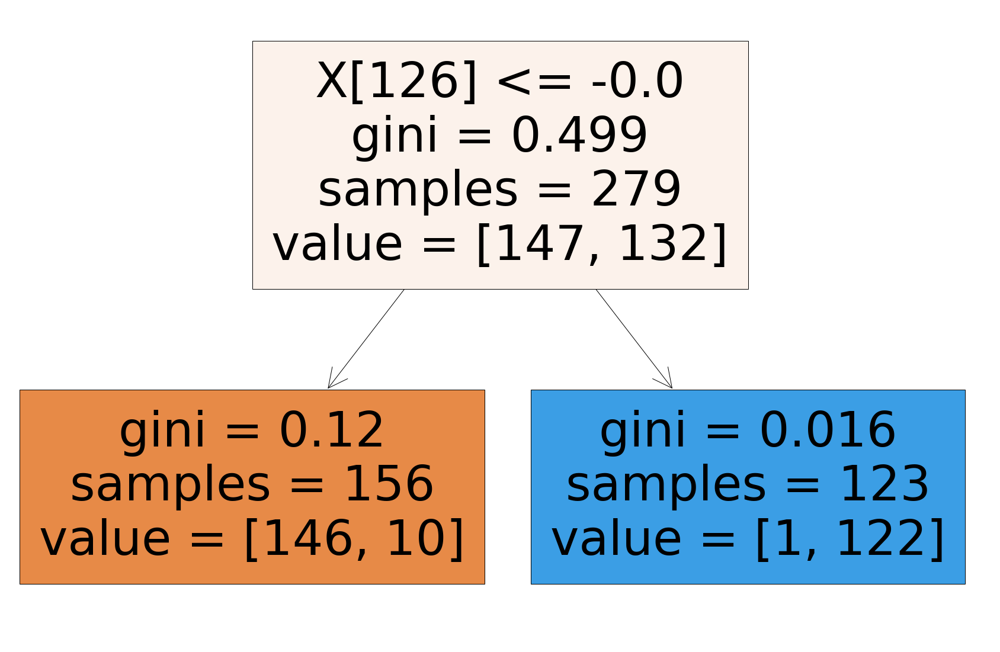

In [234]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestdepth, filled=True)
plt.show()

Decision Tree tuned : max_depth
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.95      0.89        43
           1       0.96      0.84      0.90        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.90      0.89      0.89        94



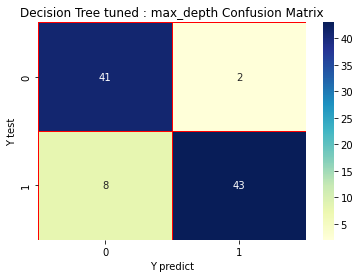

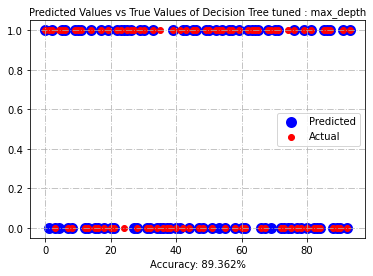

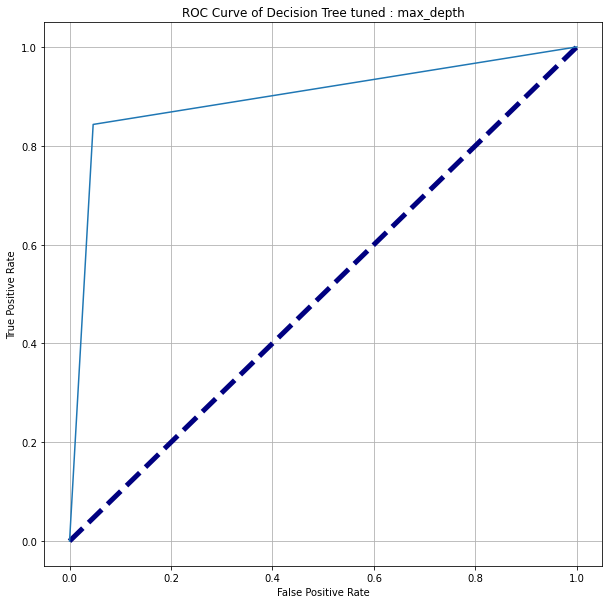

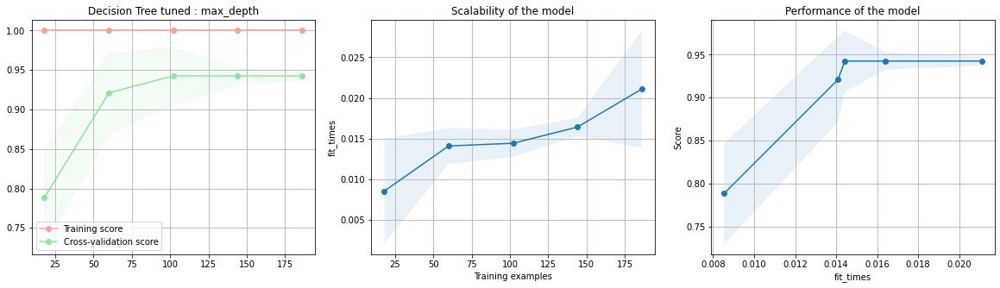

In [235]:
# Perform training and visualization through run_model()
run_model("Decision Tree tuned : max_depth", dtree_bestdepth, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Tuning using  pruning

In [236]:
# Full model 
dtree_of = DecisionTreeClassifier(random_state = rs)
dtree_of.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

DecisionTreeClassifier(random_state=42)

In [237]:
# Compute the alphas
path = dtree_of.cost_complexity_pruning_path(data_list['poly_standard'][0], data_list['poly_standard'][2])
ccp_alphas = path.ccp_alphas

In [238]:
# Create a dictionary to store all the decision trees for alpha values, and fit a model on each value of ccp_alpha we got from the previous step
dt_alpha_dict = {}
start = time.time()
for a in ccp_alphas:
    dt = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    dt.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
    dt_alpha_dict[a] = dt
end = time.time() - start



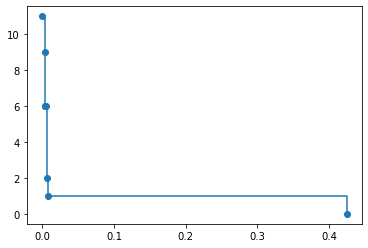

In [239]:
# Plot depth vs alpha
depth_pr = [d.tree_.max_depth for d in dt_alpha_dict.values()]
plt.plot(dt_alpha_dict.keys(), depth_pr, marker="o", drawstyle="steps-post")

In [240]:
# Find the best alpha
tuning_time = {}
# 3 fold cross validation
alpha_acc_dict = {}
start = time.time()
for a in ccp_alphas:
    dtree = DecisionTreeClassifier(ccp_alpha = a, random_state = rs)
    kf = KFold(n_splits=3)
    score_list = []
    
    for train_idx, test_idx in kf.split(data_list['notrans'][0], data_list['notrans'][2]):

        X_train_kf, X_test_kf, y_train_kf, y_test_kf = data_list['poly_standard'][0].iloc[train_idx], \
        data_list['poly_standard'][0].iloc[test_idx], data_list['poly_standard'][2].iloc[train_idx], \
        data_list['poly_standard'][2].iloc[test_idx]
        
        dtree.fit(X_train_kf, y_train_kf)
        y_pred_kf = dtree.predict(X_test_kf)
        dt_acc = accuracy_score(y_test_kf, y_pred_kf)
        score_list.append(dt_acc)
        
    alpha_acc_dict[a] = np.mean(score_list)
end = time.time() - start
tuning_time["model"] = "DecisionTree: alpha tuning"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [241]:
# best_ccp_alpha 
# Your code here
best_ccp_alpha = max(zip(alpha_acc_dict.values(), alpha_acc_dict.keys()))[1]
print(best_ccp_alpha)

0.00796135014983844


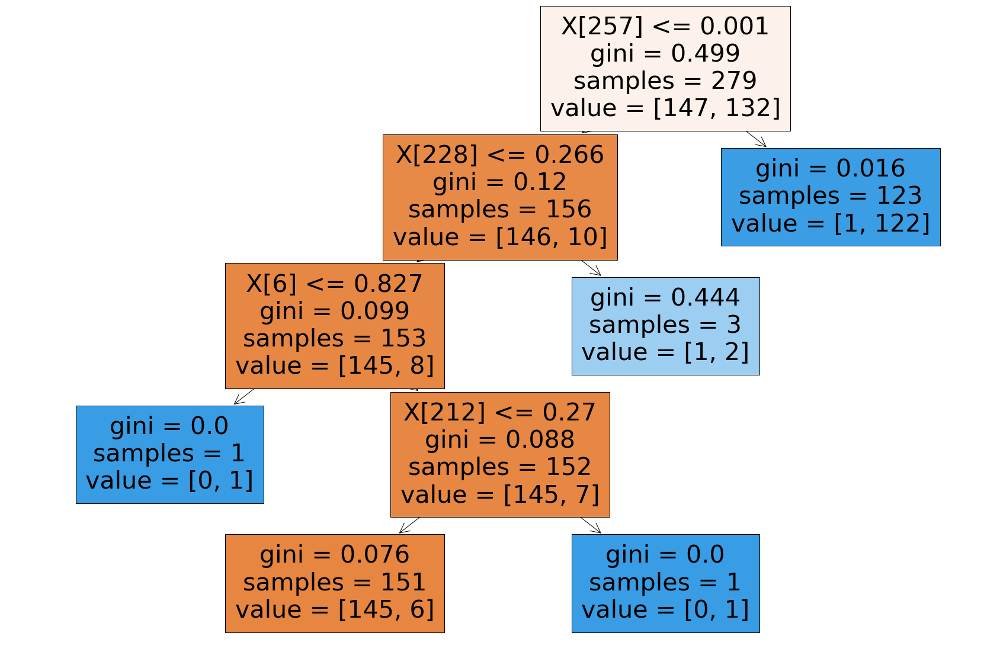

In [242]:
# Plot the tree
plt.figure(figsize=(30,20))
tree.plot_tree(dtree_bestalpha, filled=True)
plt.show()

Decision Tree pruned
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.83      0.93      0.88        43
           1       0.93      0.84      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.89      0.88        94
weighted avg       0.89      0.88      0.88        94



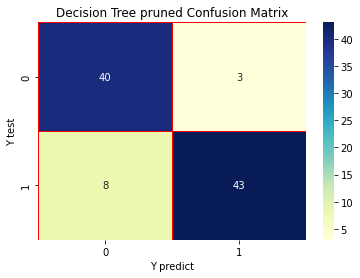

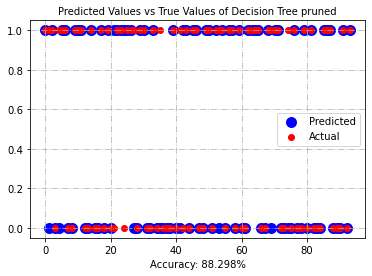

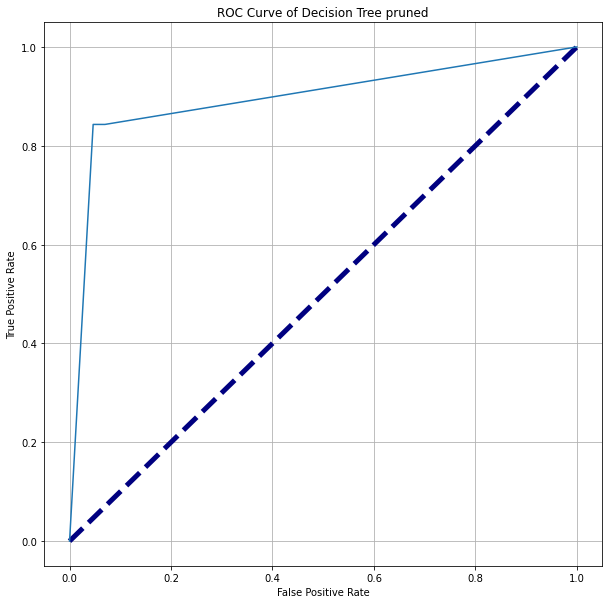

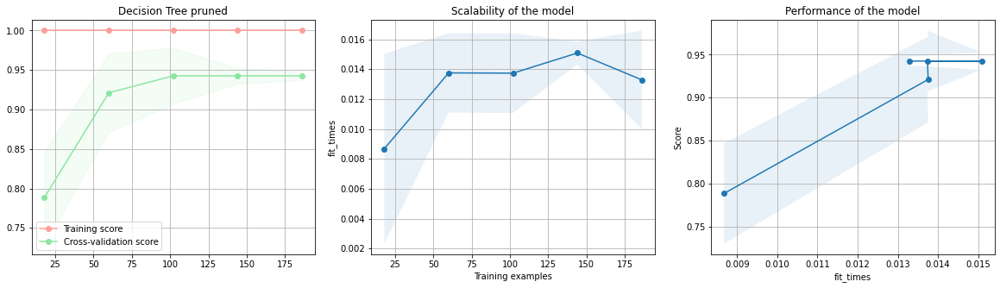

In [243]:
run_model("Decision Tree pruned", dtree_bestalpha, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

### Bagging Classifier

Bagging Classifier
None
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



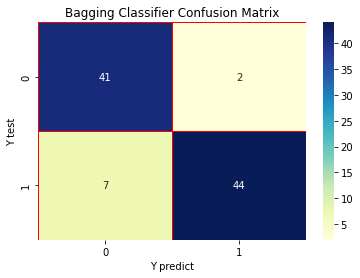

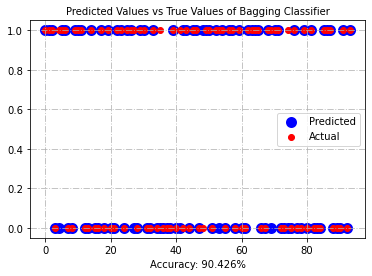

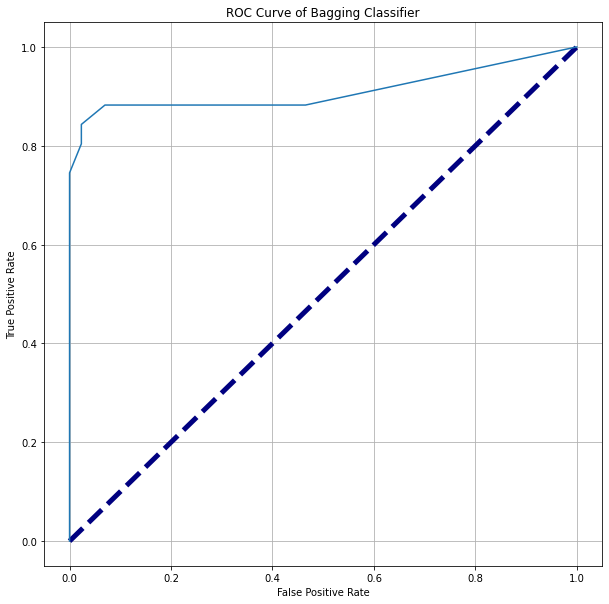

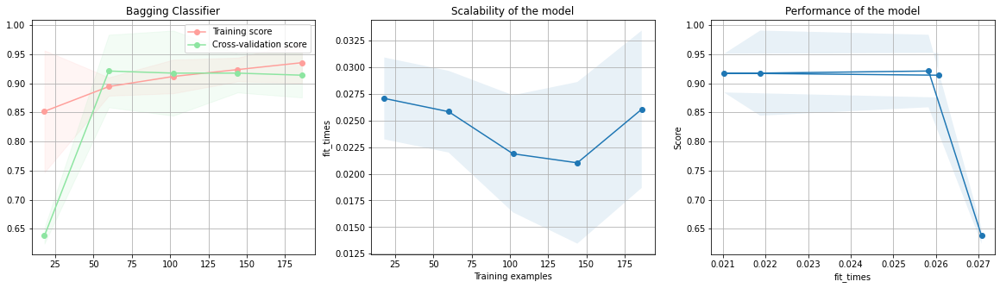

In [244]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [245]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list["notrans"][0], data_list["notrans"][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [246]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 10
The optimal value of max_samples is: 0.05


In [247]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['notrans'][0], data_list['notrans'][2])

BaggingClassifier(max_samples=0.05, random_state=42)

Bagging tuned: Gridsearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



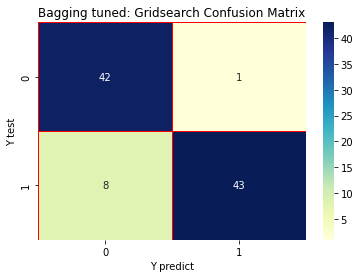

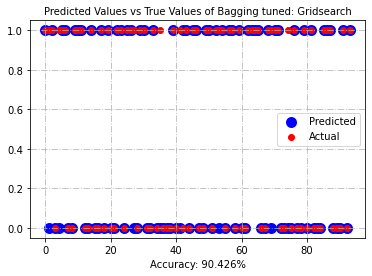

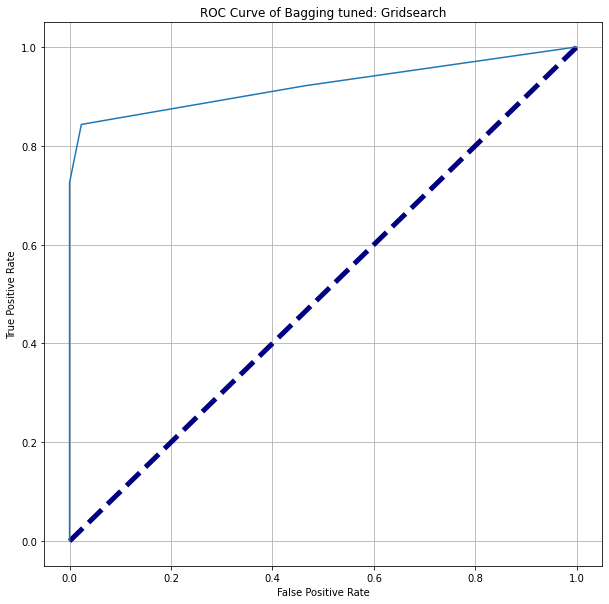

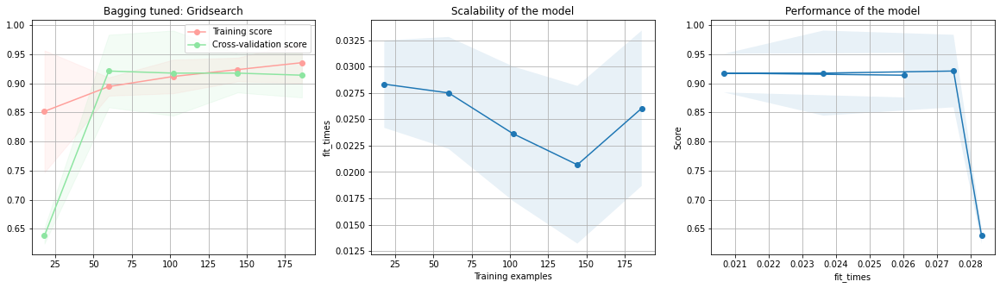

In [248]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

####  Random Search

In [249]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [250]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [251]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['notrans'][0], data_list['notrans'][2])

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: RandomizedSearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



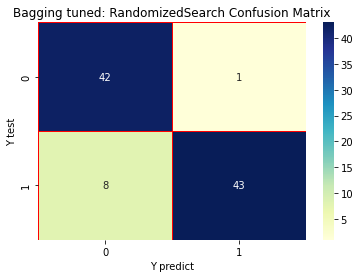

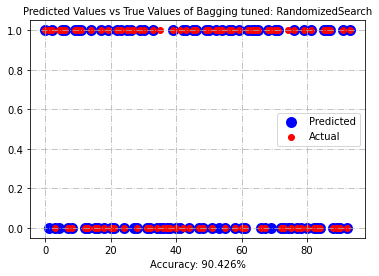

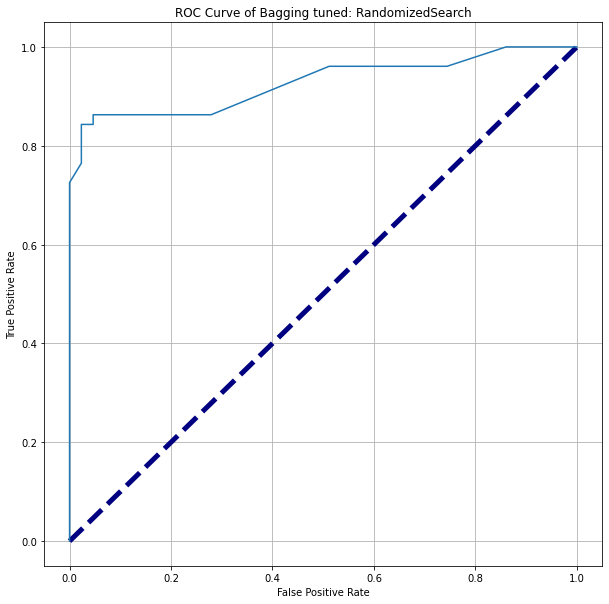

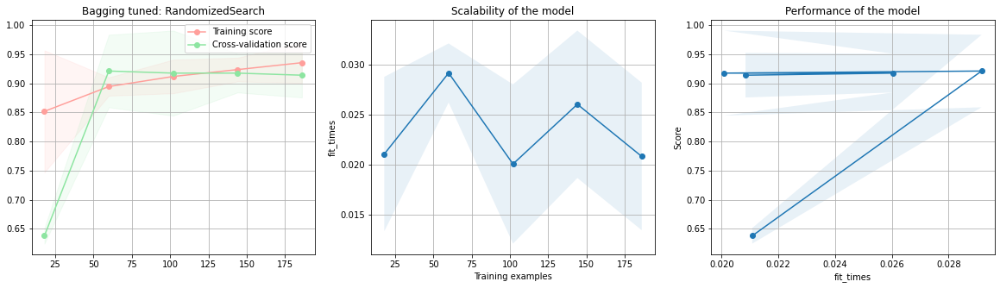

In [252]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Halving Grid Search

In [253]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [254]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [255]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['notrans'][0], data_list['notrans'][2])

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Grid Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



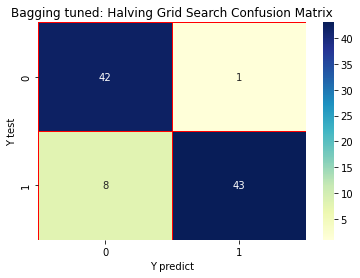

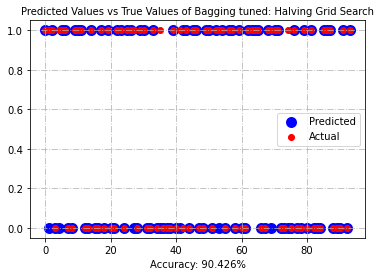

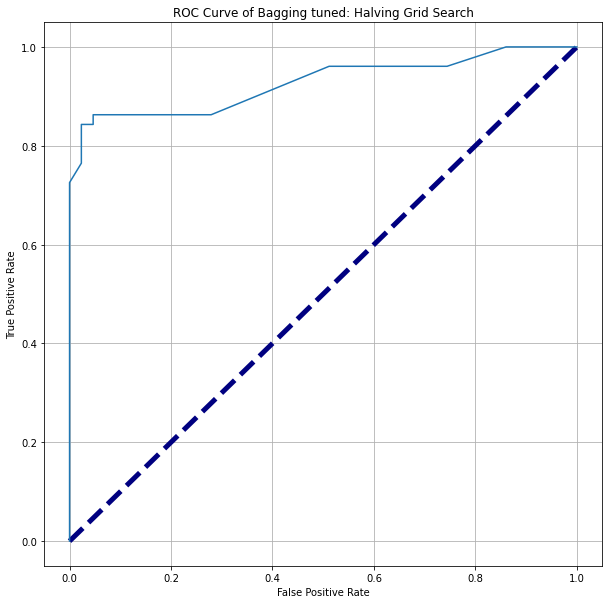

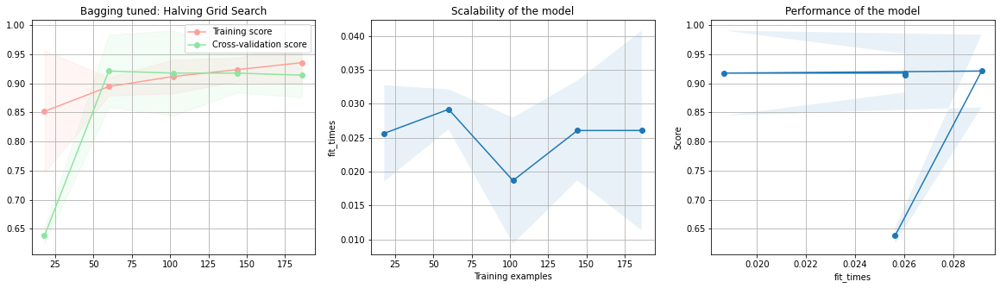

In [256]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Halving Random Search

In [257]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [258]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 3
The optimal value of n_estimators is: 20
The optimal value of max_samples is: 0.1


In [259]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['notrans'][0], data_list['notrans'][2])

BaggingClassifier(max_samples=0.1, n_estimators=20, random_state=42)

Bagging tuned: Halving Random Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



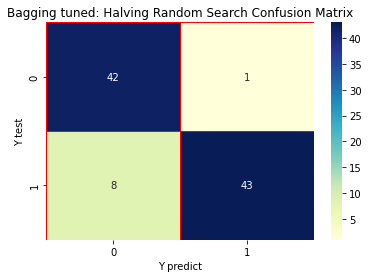

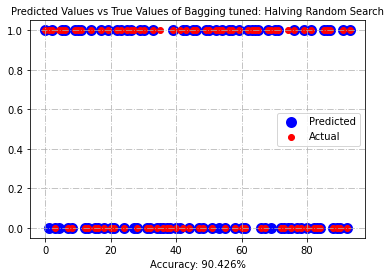

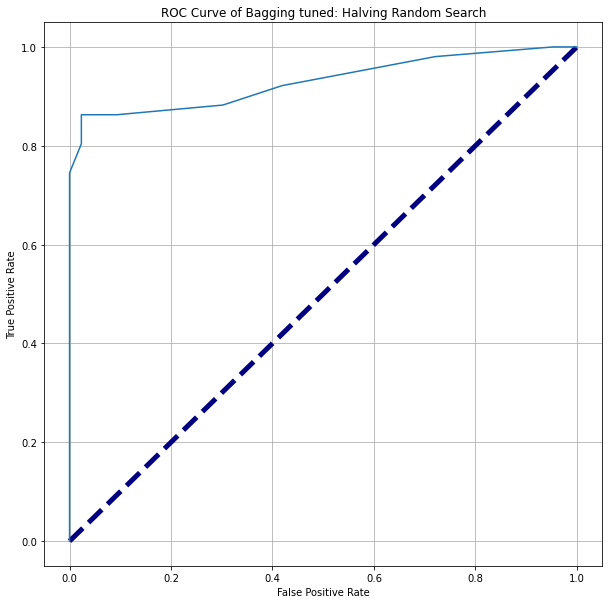

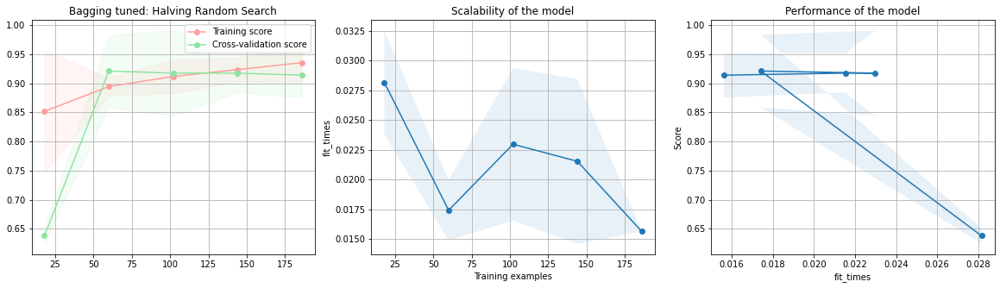

In [260]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

### Bagging Classifier with minmax scaling

Bagging Classifier
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



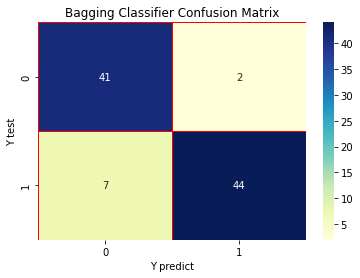

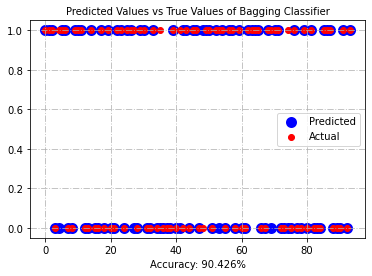

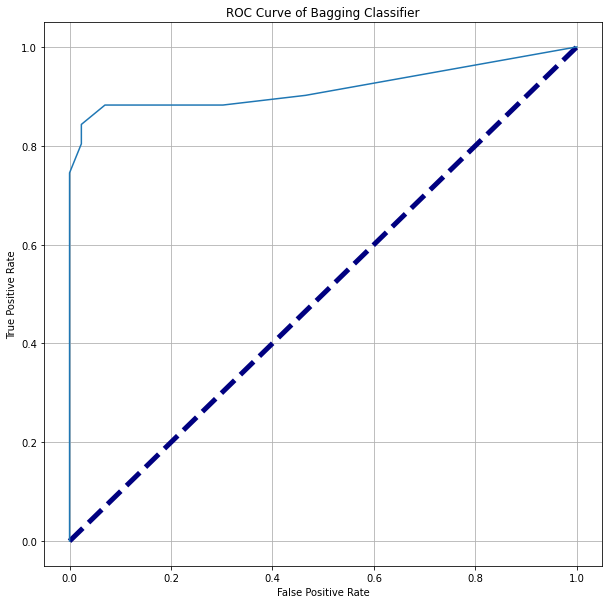

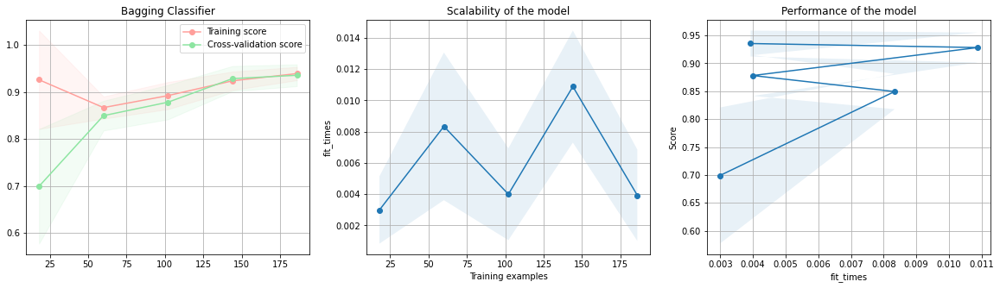

In [261]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [262]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [263]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 10
The optimal value of max_samples is: 0.05


In [264]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

BaggingClassifier(max_samples=0.05, random_state=42)

Bagging tuned: Gridsearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



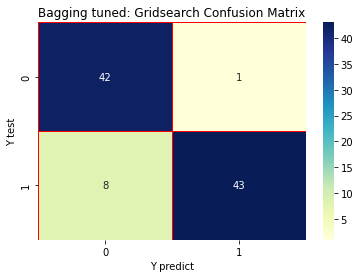

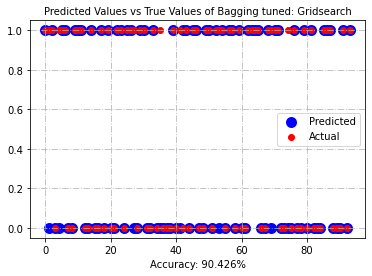

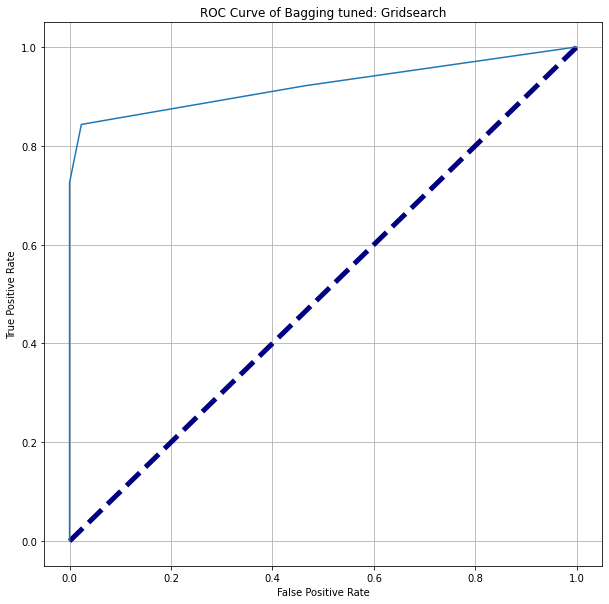

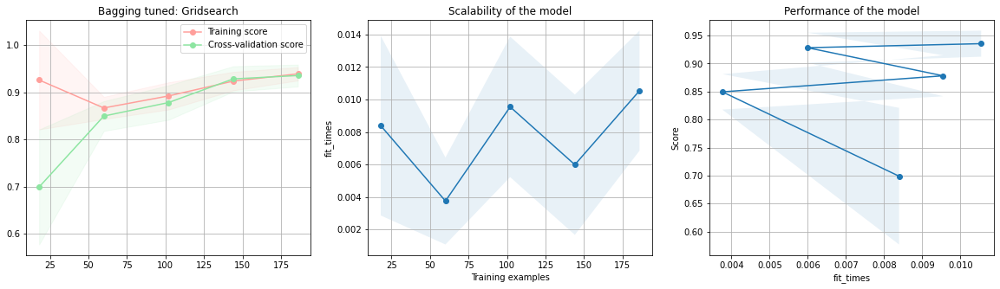

In [265]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

####  Random Search

In [266]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [267]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.05


In [268]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

BaggingClassifier(max_samples=0.05, n_estimators=50, random_state=42)

Bagging tuned: RandomizedSearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



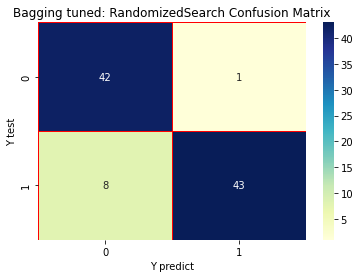

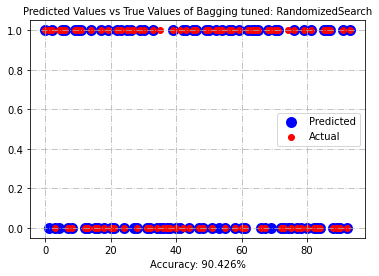

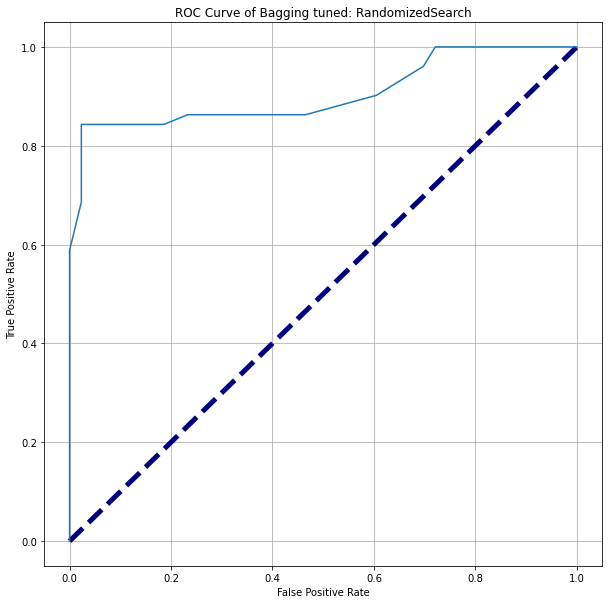

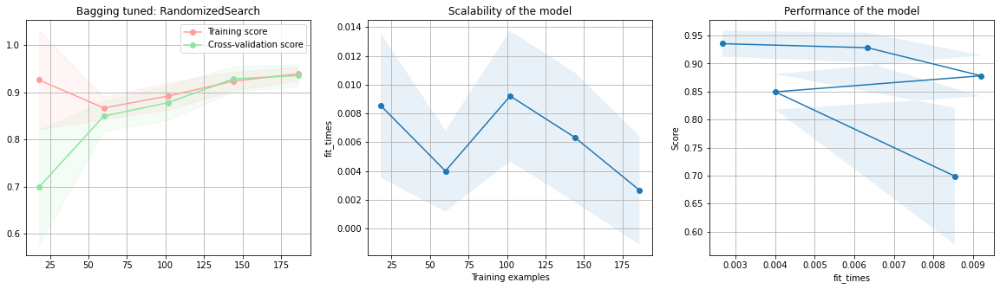

In [269]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Halving Grid Search

In [270]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [271]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 40
The optimal value of max_samples is: 0.1


In [272]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

BaggingClassifier(max_samples=0.1, n_estimators=40, random_state=42)

Bagging tuned: Halving Grid Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



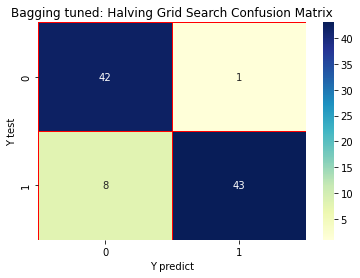

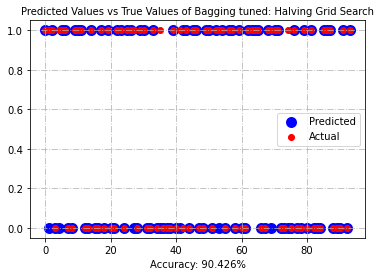

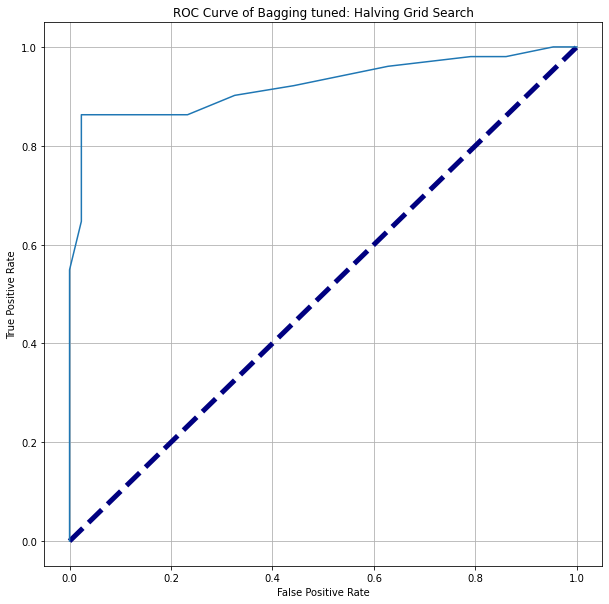

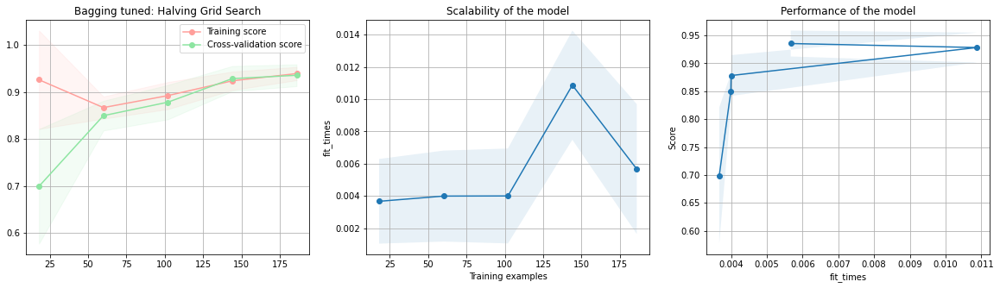

In [273]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Halving Random Search

In [274]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [275]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [276]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2]) 

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Random Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



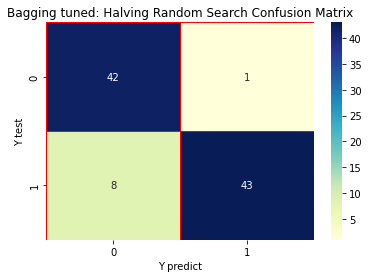

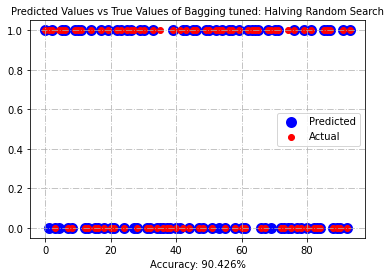

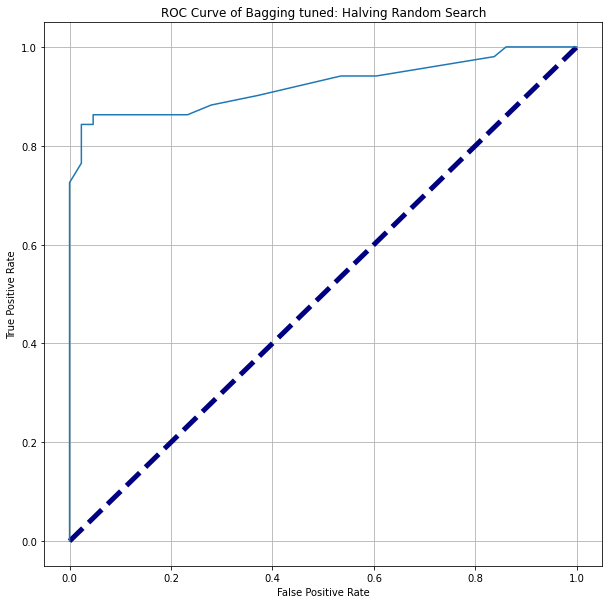

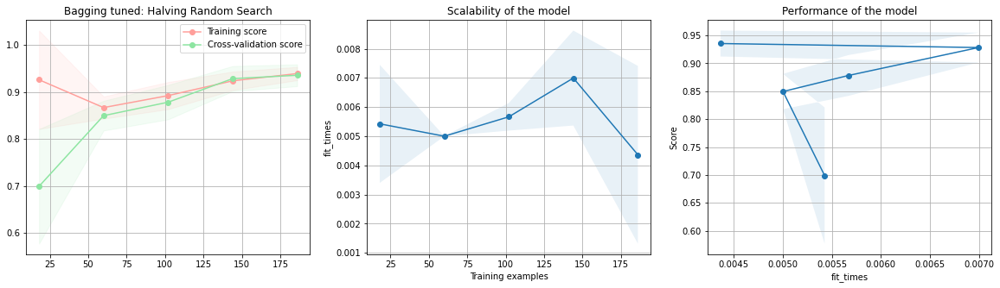

In [277]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

### Bagging Classifier with standard scaling

Bagging Classifier
Standard Scaler
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



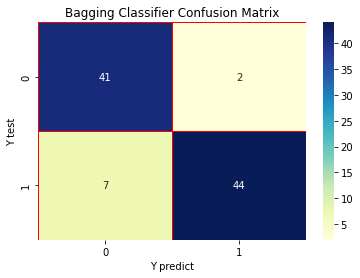

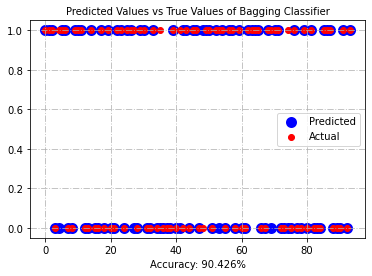

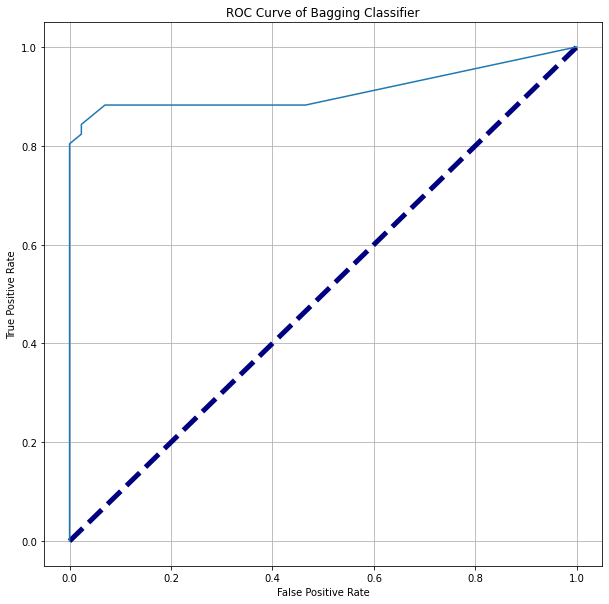

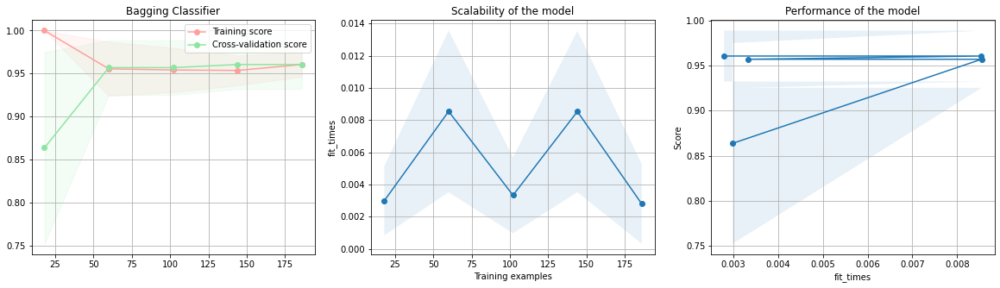

In [278]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [279]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [280]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 10
The optimal value of max_samples is: 0.05


In [281]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

BaggingClassifier(max_samples=0.05, random_state=42)

Bagging tuned: Gridsearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



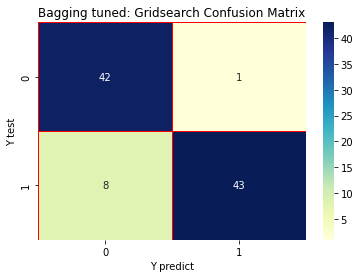

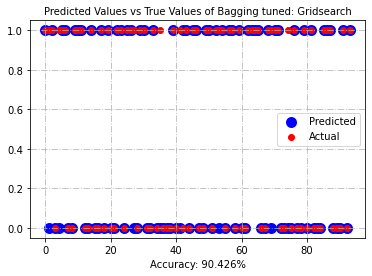

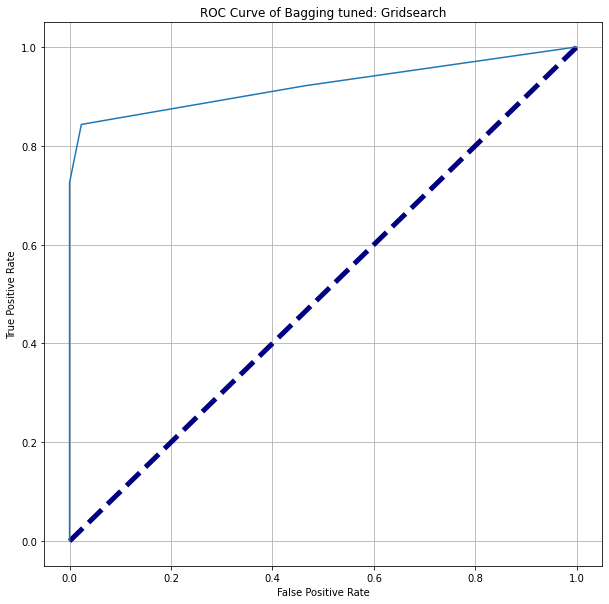

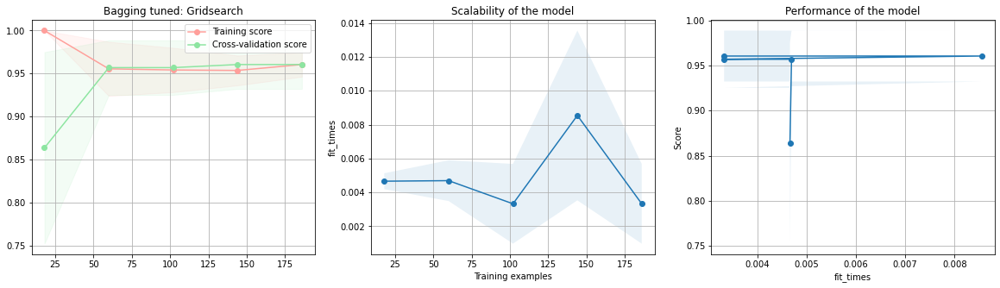

In [282]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

####  Random Search

In [283]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [284]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 3
The optimal value of n_estimators is: 30
The optimal value of max_samples is: 0.5


In [285]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

BaggingClassifier(max_samples=0.5, n_estimators=30, random_state=42)

Bagging tuned: RandomizedSearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.86      0.98      0.91        43
           1       0.98      0.86      0.92        51

    accuracy                           0.91        94
   macro avg       0.92      0.92      0.91        94
weighted avg       0.92      0.91      0.92        94



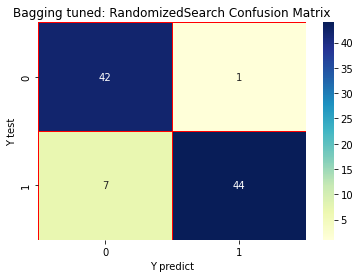

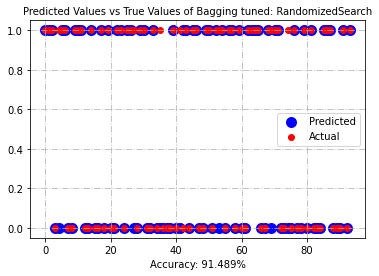

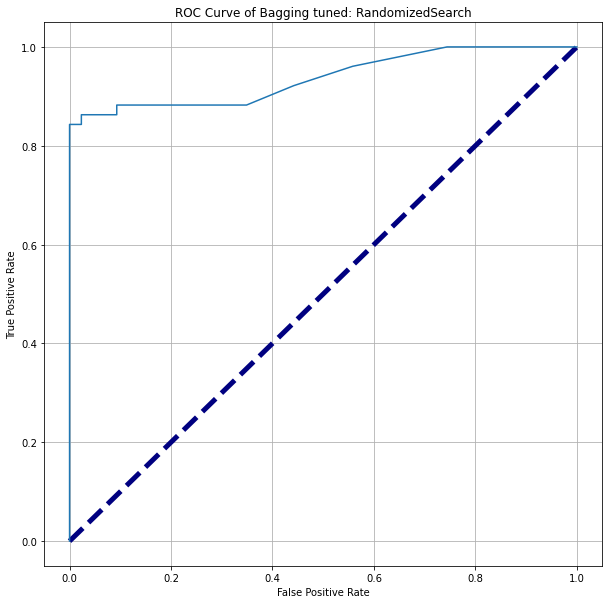

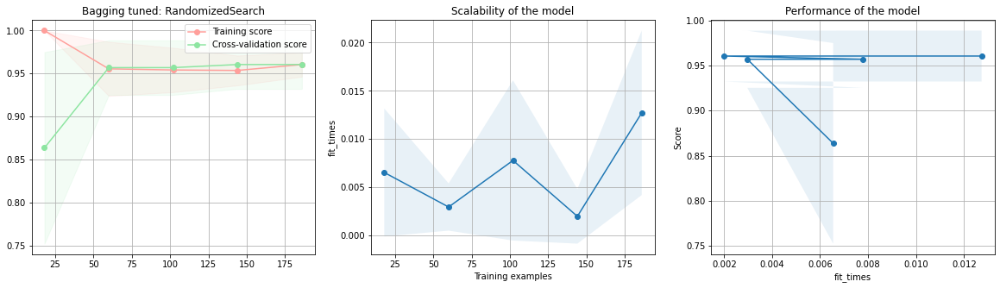

In [286]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best,data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Halving Grid Search

In [287]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [288]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [289]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Grid Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



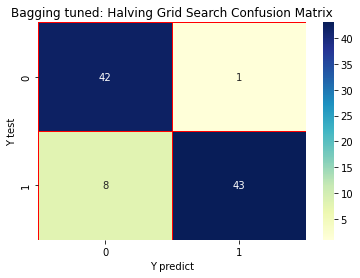

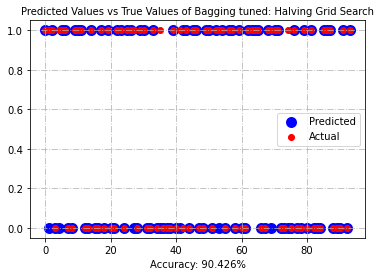

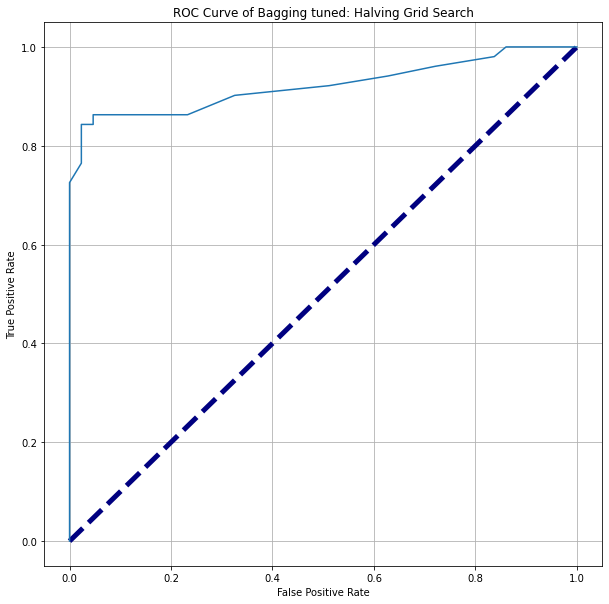

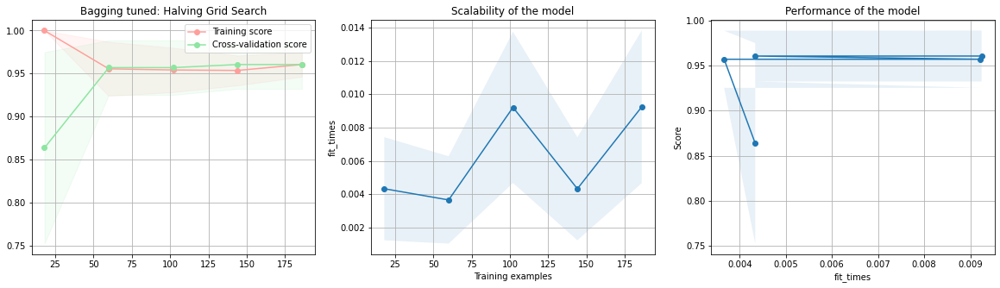

In [290]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Halving Random Search

In [291]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [292]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 40
The optimal value of max_samples is: 0.1


In [293]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2]) 

BaggingClassifier(max_samples=0.1, n_estimators=40, random_state=42)

Bagging tuned: Halving Random Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



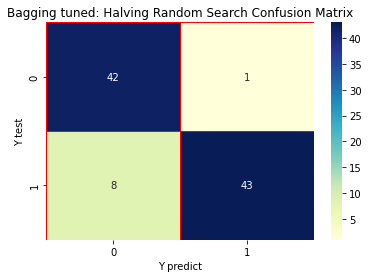

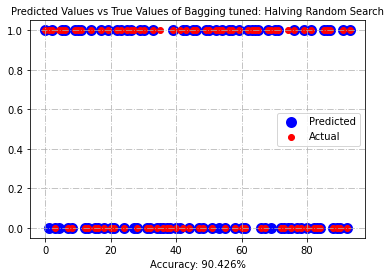

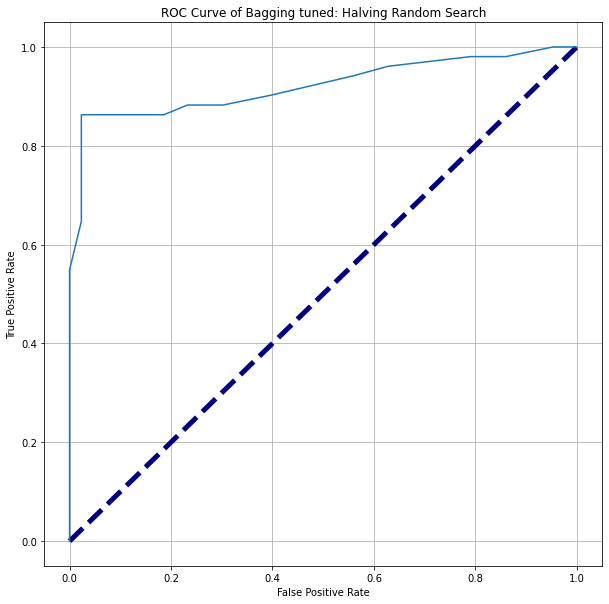

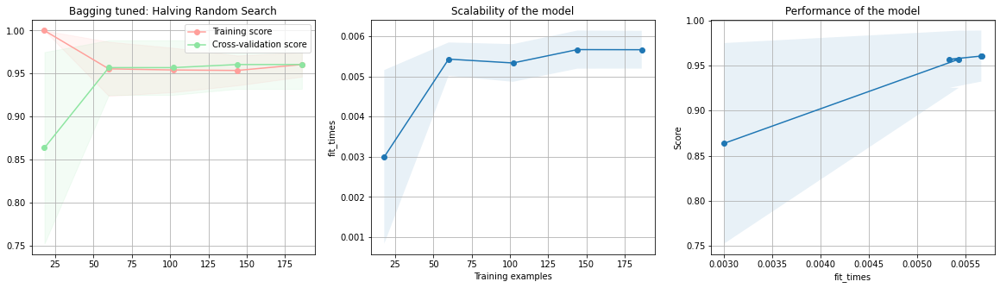

In [294]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

### Bagging Classifier with Polynomial Transformation

Bagging Classifier
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.95      0.89        43
           1       0.96      0.84      0.90        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.90      0.89      0.89        94



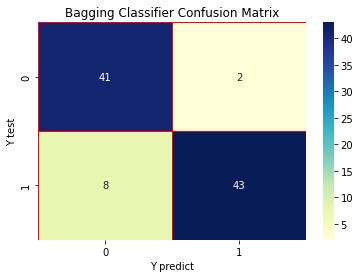

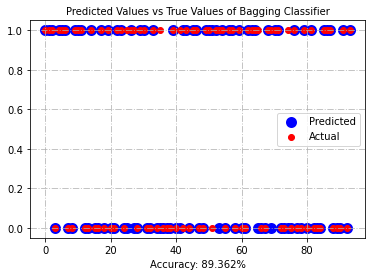

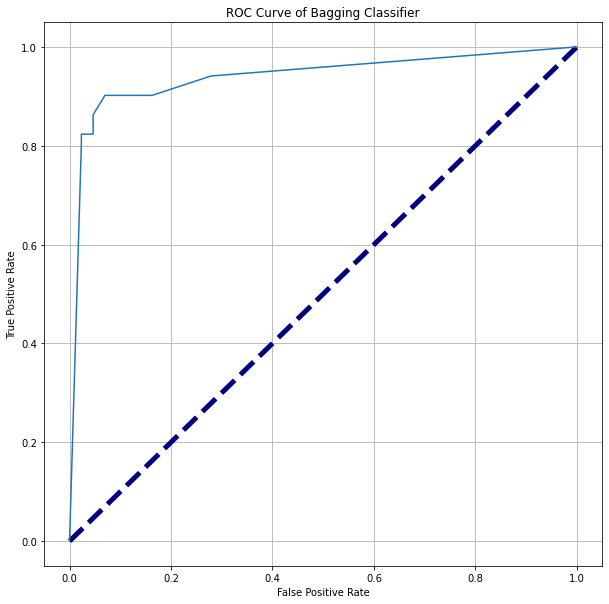

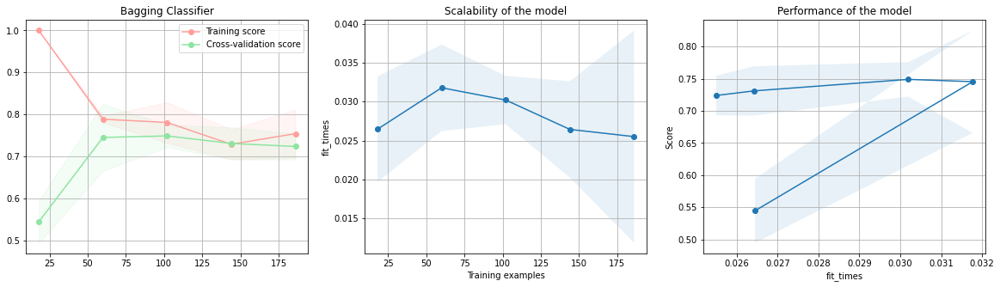

In [295]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [296]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [297]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 20
The optimal value of max_samples is: 0.05


In [298]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

BaggingClassifier(max_samples=0.05, n_estimators=20, random_state=42)

Bagging tuned: Gridsearch
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



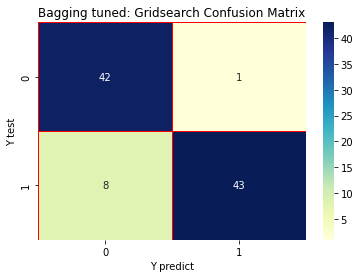

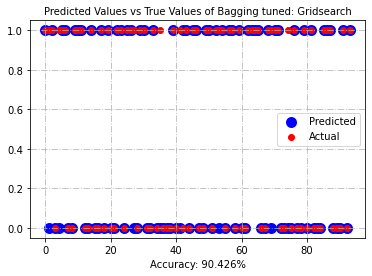

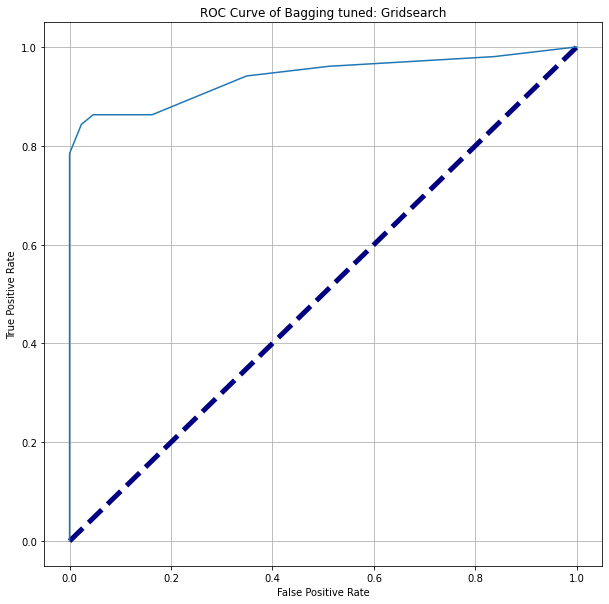

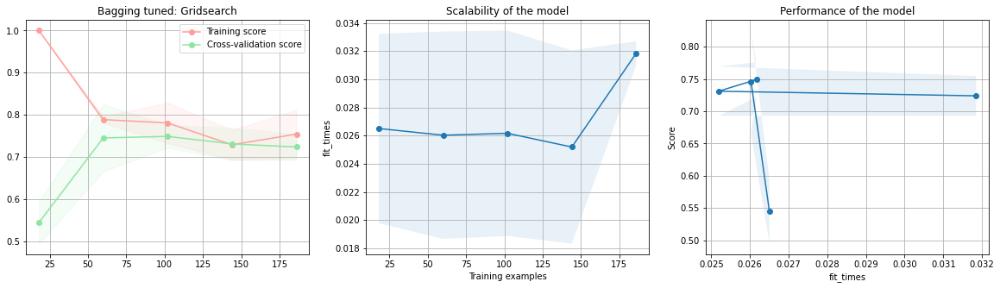

In [299]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

####  Random Search

In [300]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [301]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 3
The optimal value of n_estimators is: 20
The optimal value of max_samples is: 0.2


In [302]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

BaggingClassifier(max_samples=0.2, n_estimators=20, random_state=42)

Bagging tuned: RandomizedSearch
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



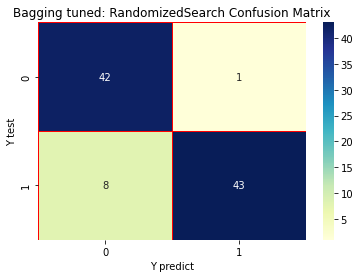

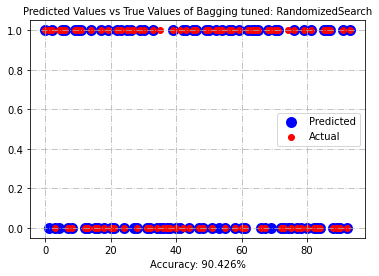

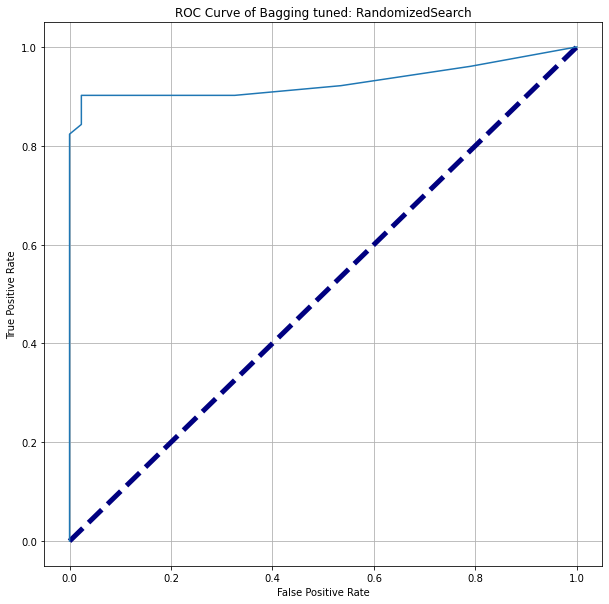

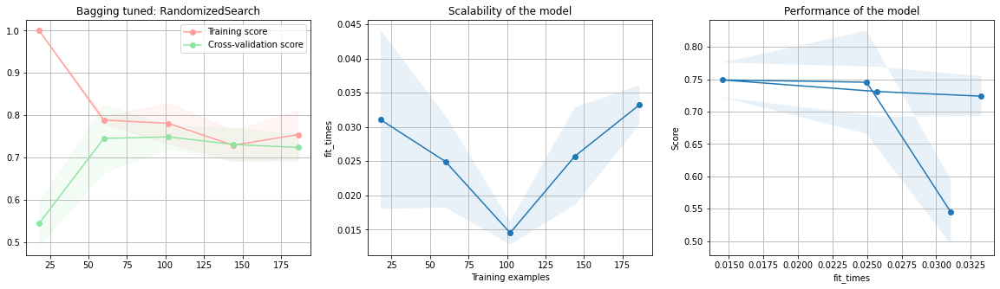

In [303]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Halving Grid Search

In [304]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [305]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 30
The optimal value of max_samples is: 0.1


In [306]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

BaggingClassifier(max_samples=0.1, n_estimators=30, random_state=42)

Bagging tuned: Halving Grid Search
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



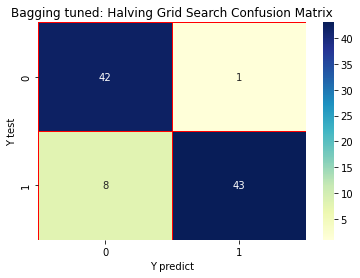

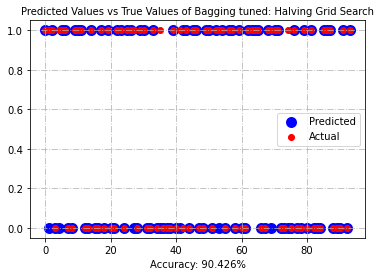

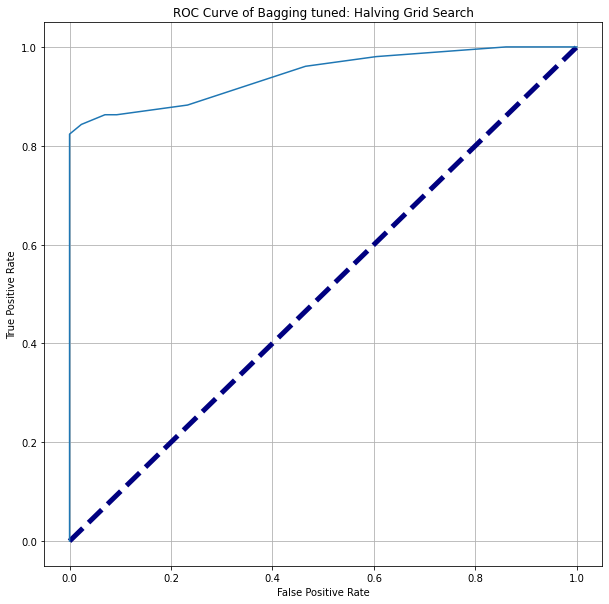

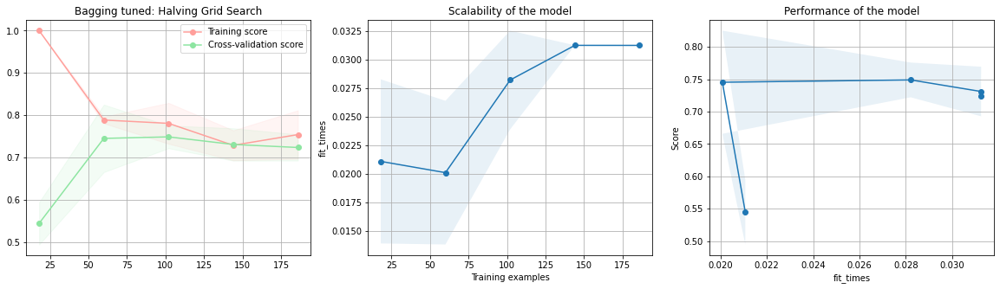

In [307]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Halving Random Search

In [308]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [309]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [310]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2]) 

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Random Search
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



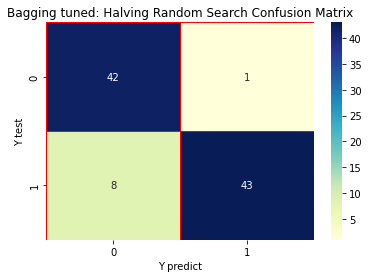

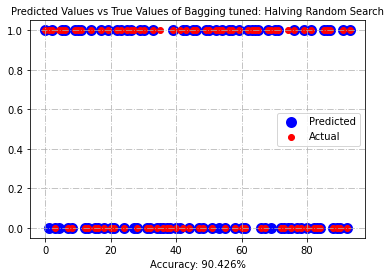

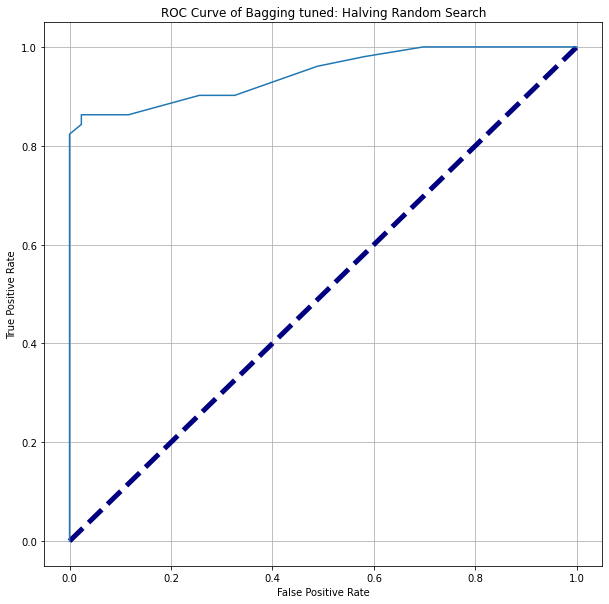

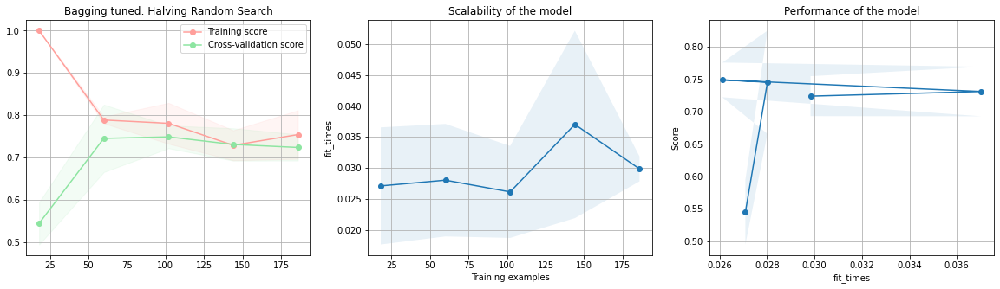

In [311]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

### Bagging Classifier with MinMax Polynomial Transformation

Bagging Classifier
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.95      0.89        43
           1       0.96      0.84      0.90        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.90      0.89      0.89        94



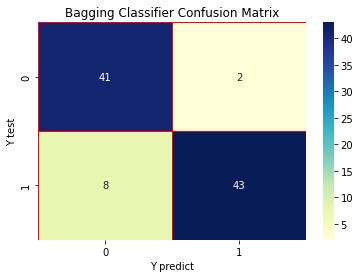

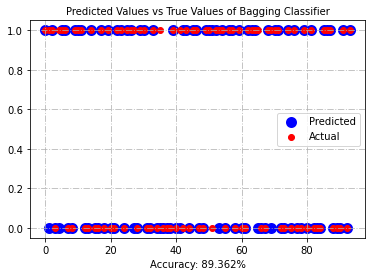

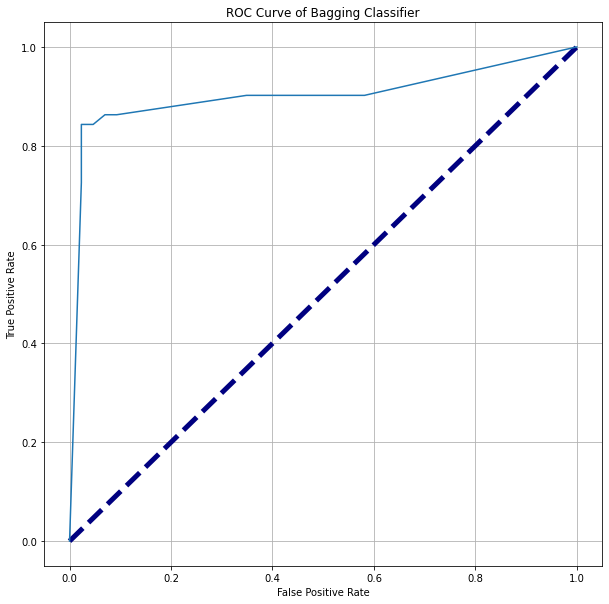

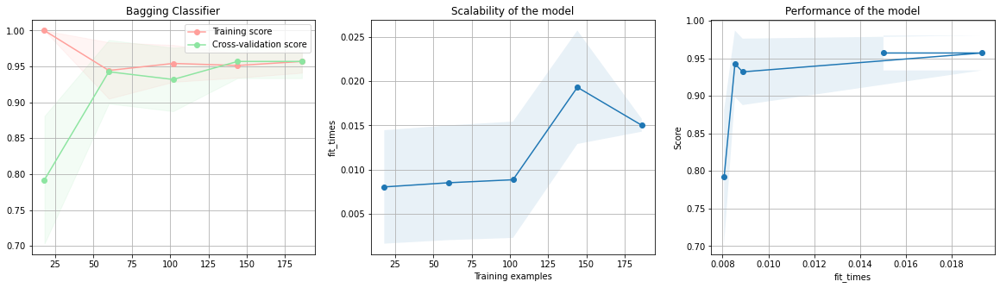

In [312]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [313]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [314]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 10
The optimal value of max_samples is: 0.1


In [315]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

BaggingClassifier(max_samples=0.1, random_state=42)

Bagging tuned: Gridsearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



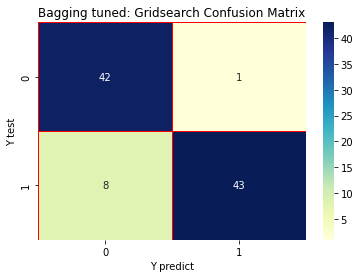

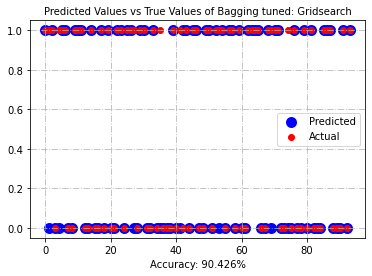

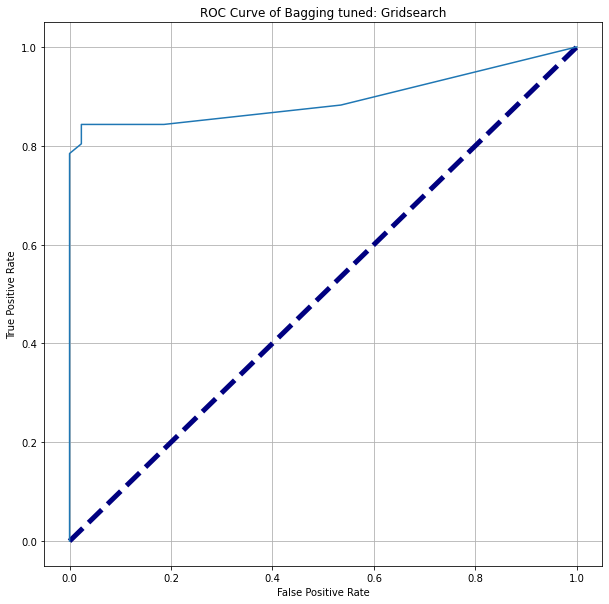

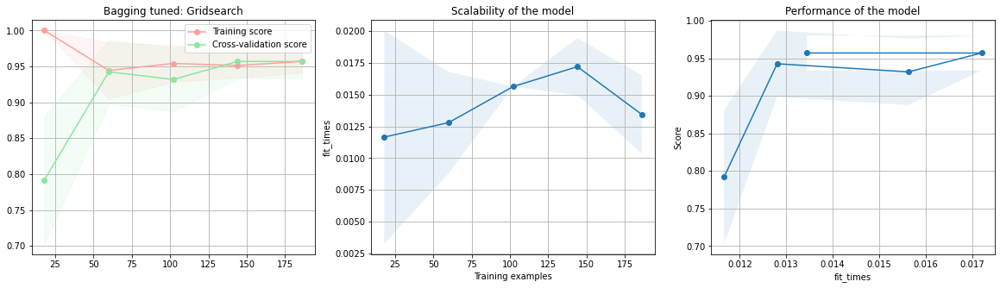

In [316]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

####  Random Search

In [317]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [318]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 20
The optimal value of max_samples is: 0.1


In [319]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

BaggingClassifier(max_samples=0.1, n_estimators=20, random_state=42)

Bagging tuned: RandomizedSearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



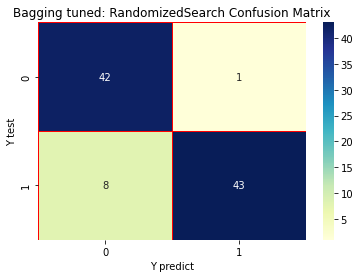

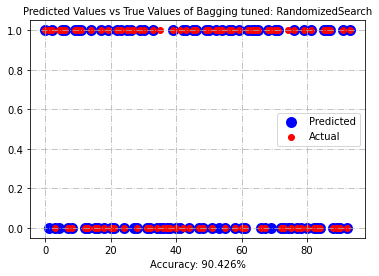

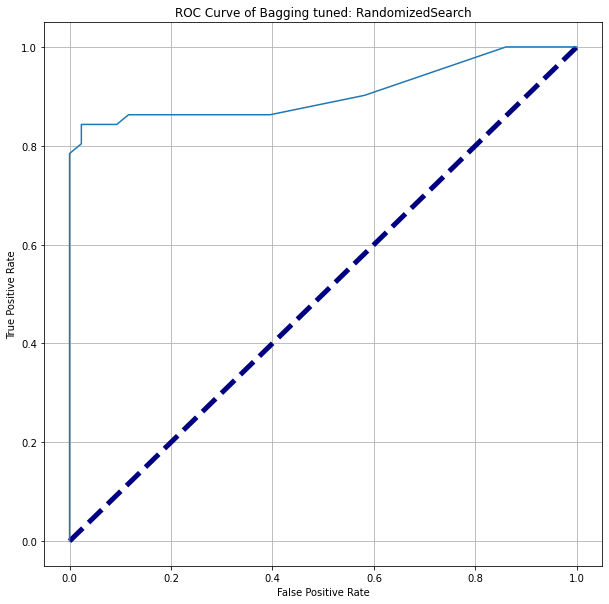

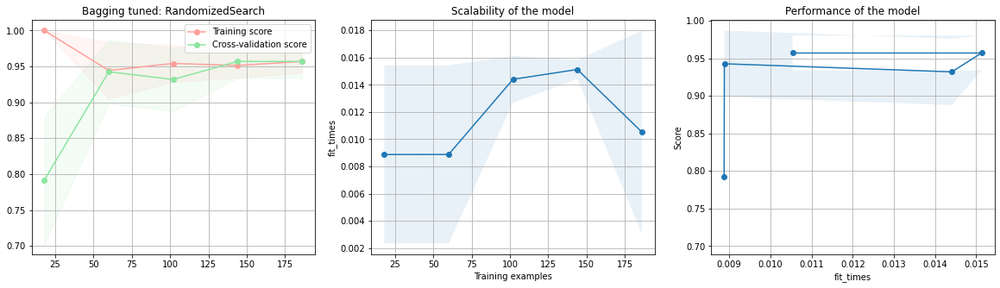

In [320]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Halving Grid Search

In [321]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [322]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 20
The optimal value of max_samples is: 0.1


In [323]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

BaggingClassifier(max_samples=0.1, n_estimators=20, random_state=42)

Bagging tuned: Halving Grid Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



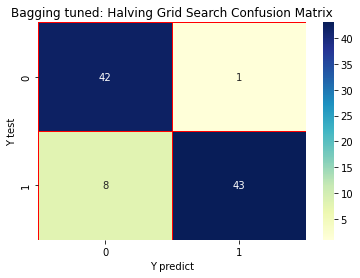

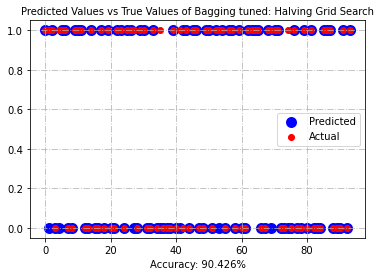

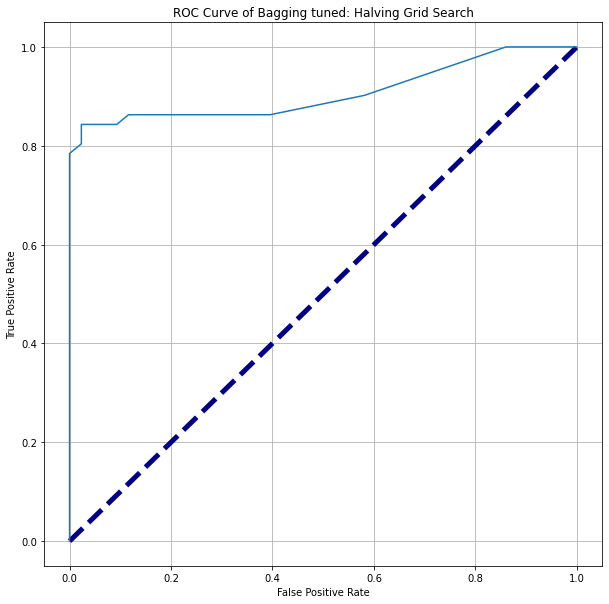

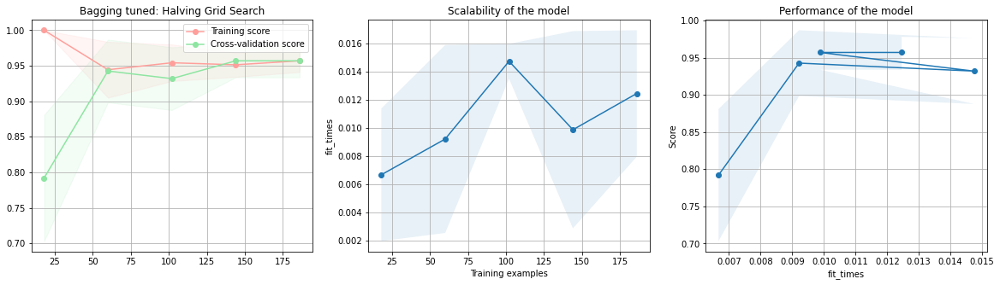

In [324]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best,data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Halving Random Search

In [325]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [326]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 30
The optimal value of max_samples is: 0.1


In [327]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2]) 

BaggingClassifier(max_samples=0.1, n_estimators=30, random_state=42)

Bagging tuned: Halving Random Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



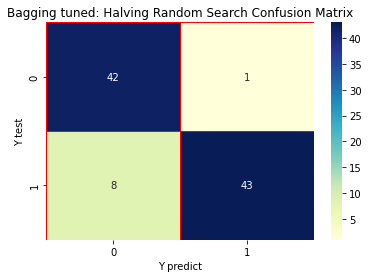

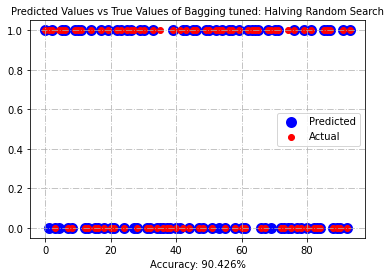

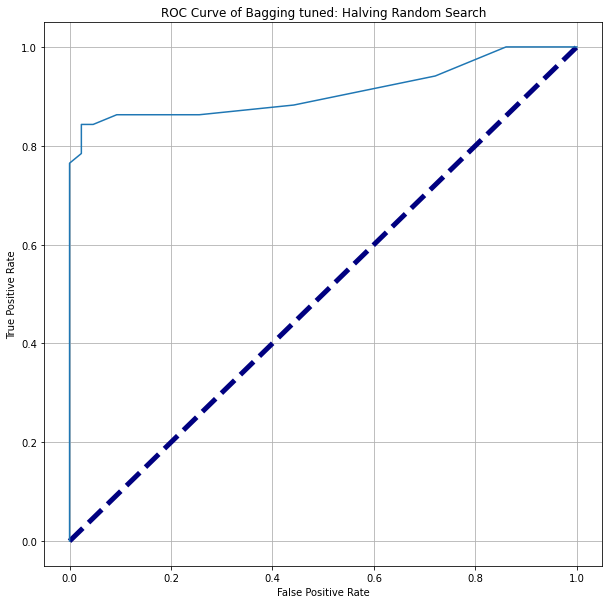

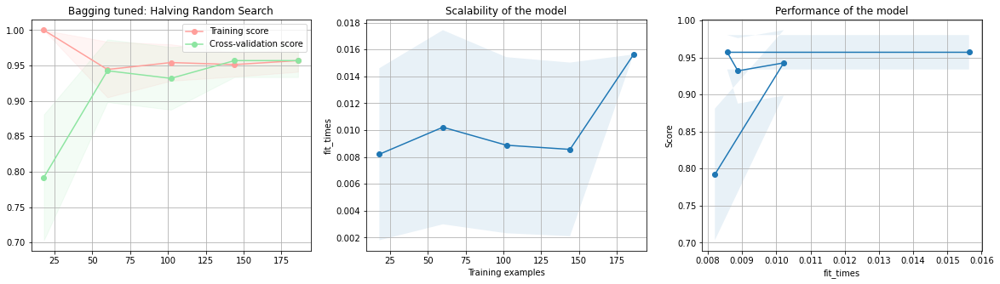

In [328]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

### Bagging Classifier with StandardScaler Polynomial Transformation

Bagging Classifier
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.83      0.93      0.88        43
           1       0.93      0.84      0.89        51

    accuracy                           0.88        94
   macro avg       0.88      0.89      0.88        94
weighted avg       0.89      0.88      0.88        94



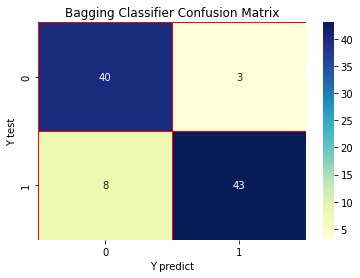

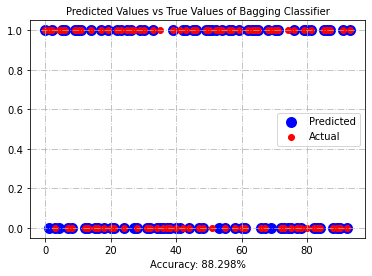

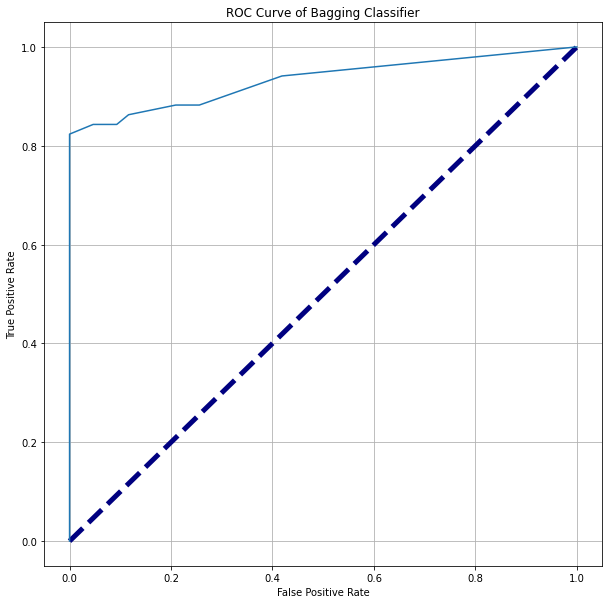

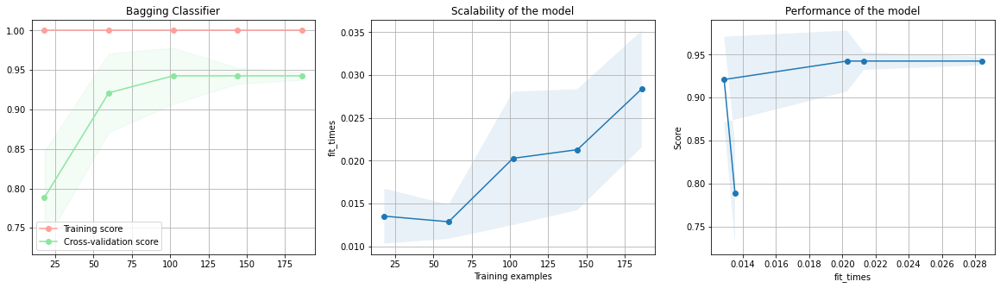

In [329]:
# Base model
bgc = BaggingClassifier(random_state = rs)
run_model("Bagging Classifier", bgc, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [330]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = GridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: Gridsearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [331]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 10
The optimal value of max_samples is: 0.2


In [332]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

BaggingClassifier(max_samples=0.2, random_state=42)

Bagging tuned: Gridsearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



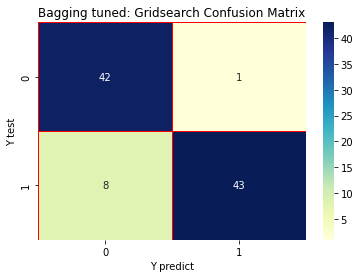

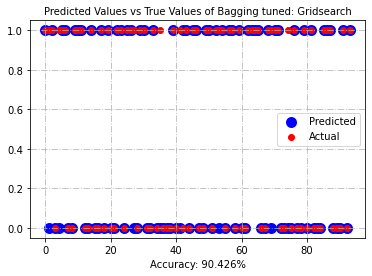

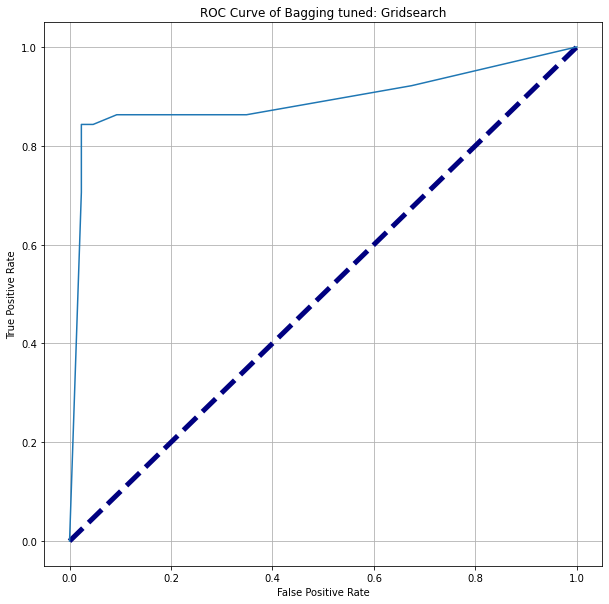

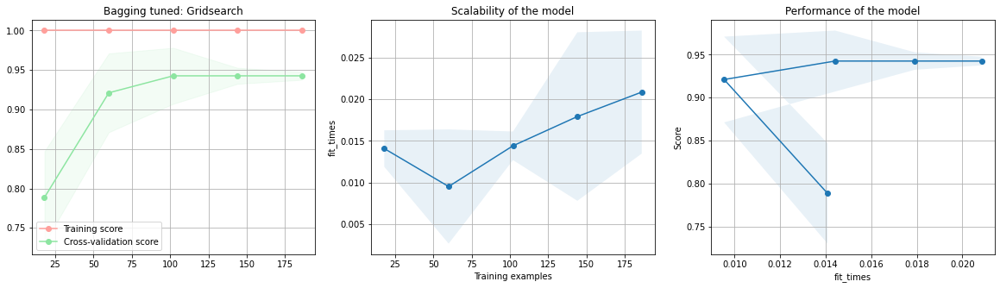

In [333]:
# train and visualize using run_model
run_model("Bagging tuned: Gridsearch", bg_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

####  Random Search

In [334]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = RandomizedSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [335]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 30
The optimal value of max_samples is: 0.5


In [336]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

BaggingClassifier(max_samples=0.5, n_estimators=30, random_state=42)

Bagging tuned: RandomizedSearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



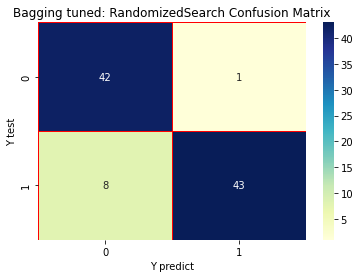

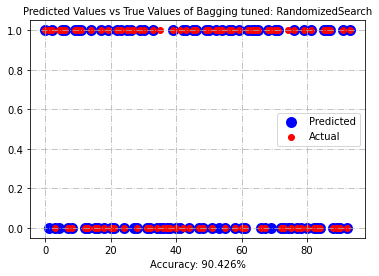

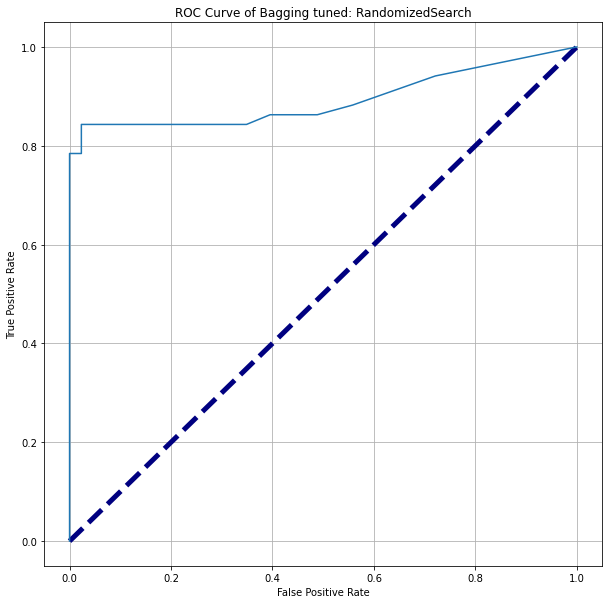

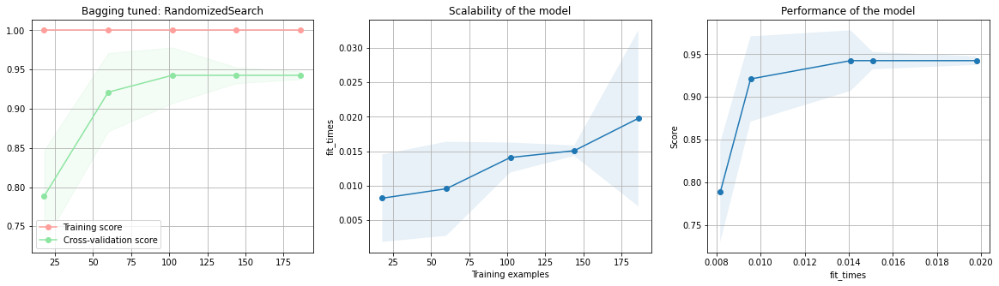

In [337]:
# train and visualize using run_model
run_model("Bagging tuned: RandomizedSearch", bg_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Halving Grid Search

In [338]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv = HalvingGridSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [339]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 1
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [340]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Grid Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



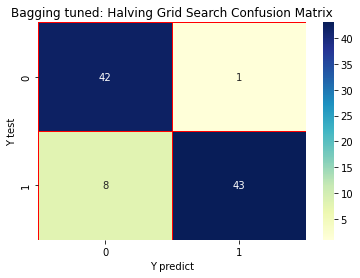

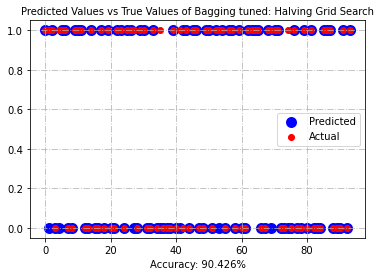

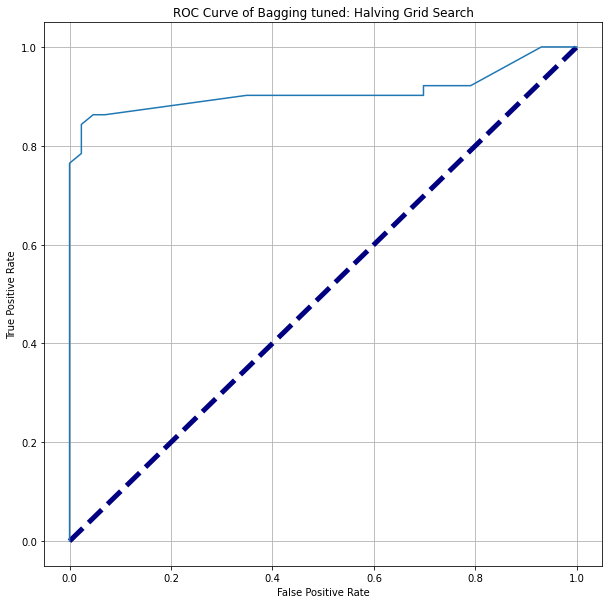

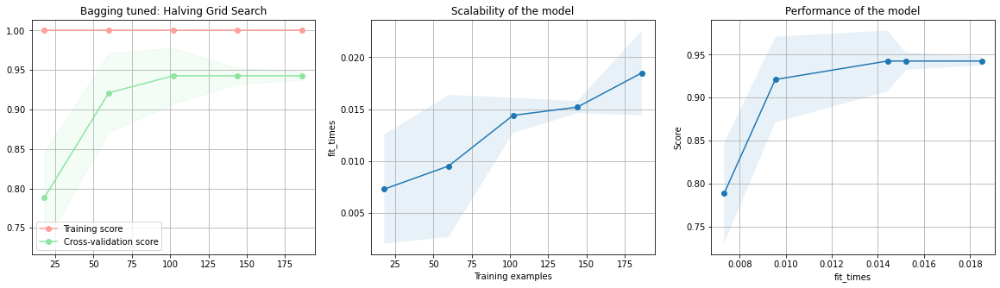

In [341]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Grid Search", bg_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Halving Random Search

In [342]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# bagging_parameters
bg_params = {'n_estimators' : [10, 20, 30, 40, 50], 'base_estimator__max_depth': [1, 2, 3], 'max_samples' : [0.05, 0.1, 0.2, 0.5]}
bgcv =  HalvingRandomSearchCV(bagging, bg_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
bgcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Bagging: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [343]:
# Print the best parameters
bgcv_best_est = bgcv.best_params_
print(f'The optimal value of max_height is: {bgcv_best_est["base_estimator__max_depth"]}')
print(f'The optimal value of n_estimators is: {bgcv_best_est["n_estimators"]}')
print(f'The optimal value of max_samples is: {bgcv_best_est["max_samples"]}')

The optimal value of max_height is: 2
The optimal value of n_estimators is: 50
The optimal value of max_samples is: 0.1


In [344]:
dt = DecisionTreeClassifier(max_depth = bgcv_best_est["base_estimator__max_depth"], random_state = rs)
bg_best = BaggingClassifier(n_estimators = bgcv_best_est["n_estimators"], max_samples = bgcv_best_est["max_samples"], random_state = rs)
bg_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2]) 

BaggingClassifier(max_samples=0.1, n_estimators=50, random_state=42)

Bagging tuned: Halving Random Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



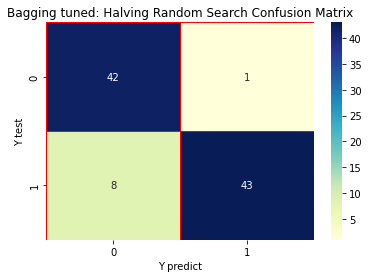

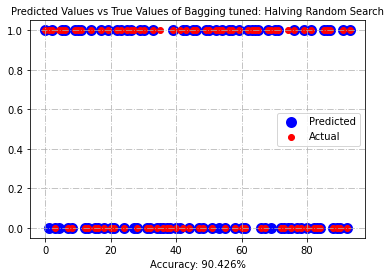

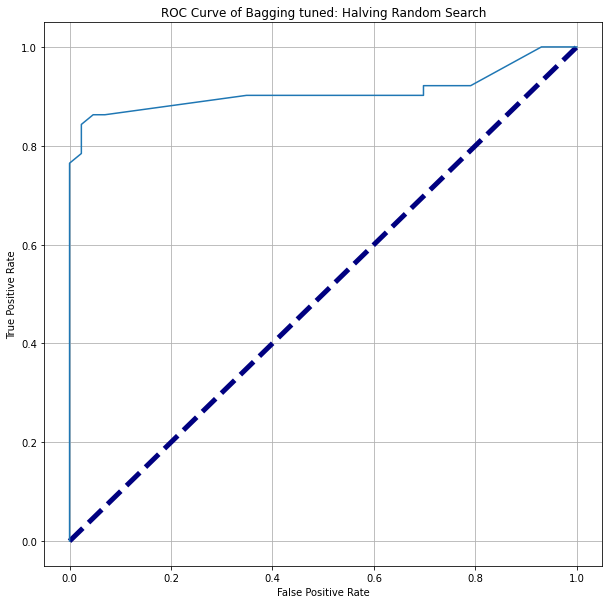

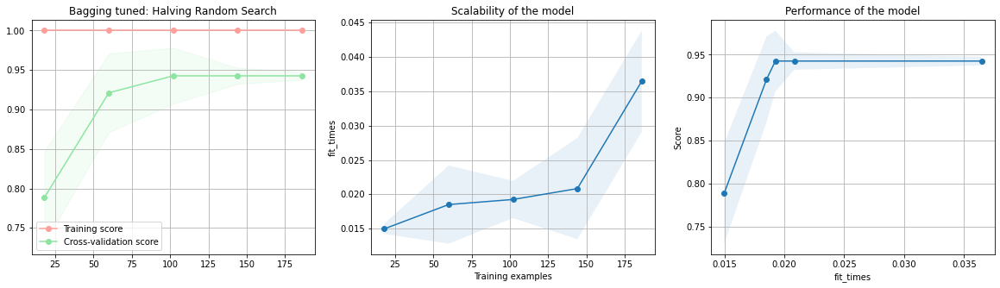

In [345]:
# train and visualize using run_model
run_model("Bagging tuned: Halving Random Search", bg_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

### Random Forest 

Random Forest Classifier
none
              precision    recall  f1-score   support

           0       0.88      0.98      0.92        43
           1       0.98      0.88      0.93        51

    accuracy                           0.93        94
   macro avg       0.93      0.93      0.93        94
weighted avg       0.93      0.93      0.93        94



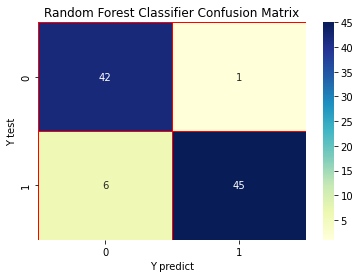

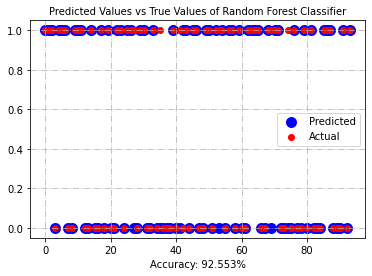

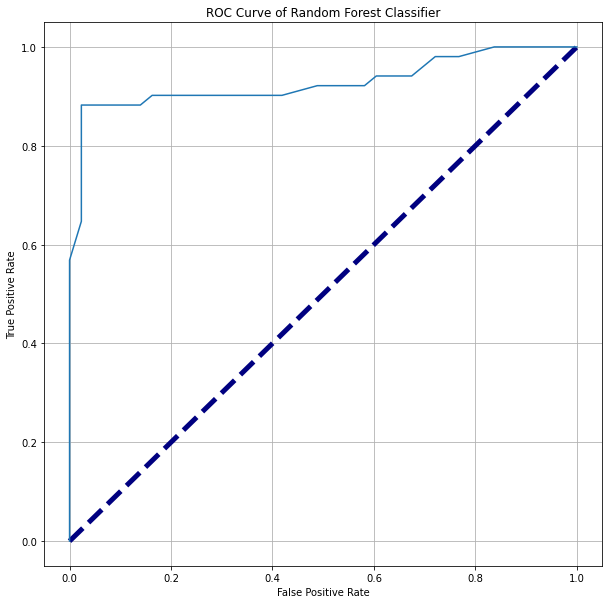

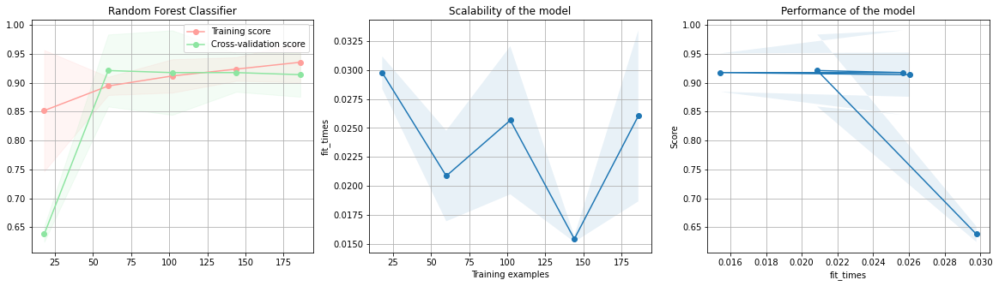

In [346]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf, data_list["notrans"][0], data_list["notrans"][1], data_list["notrans"][2], data_list["notrans"][3], fc = "none", list_scores = list_scores)

#### Tuning using OOB

In [347]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [348]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['notrans'][0], data_list['notrans'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [349]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(30, 4, 5)


In [350]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['notrans'][0], data_list['notrans'][2])

RandomForestClassifier(max_depth=5, max_features=4, n_estimators=30,
                       random_state=42)

RandomForest tuned
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



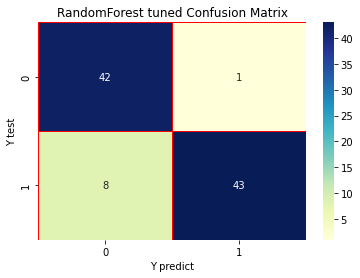

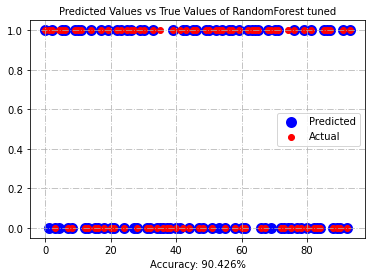

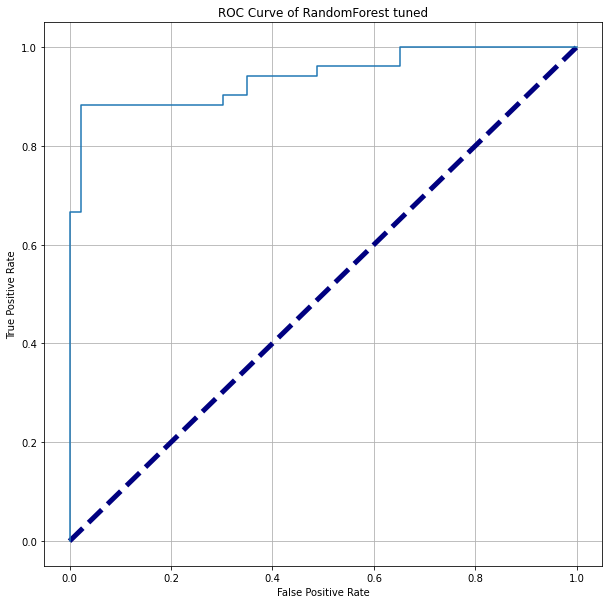

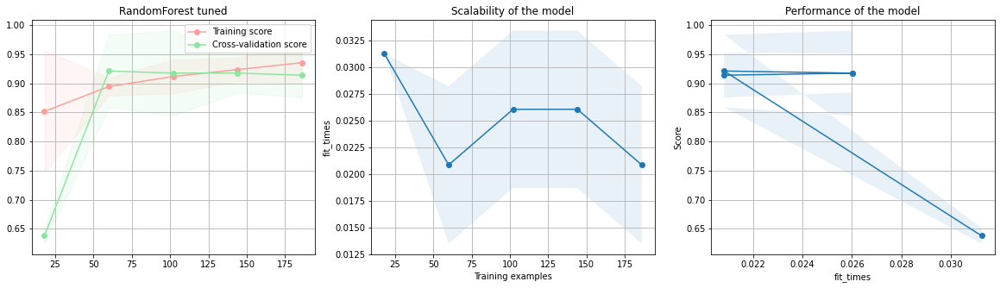

In [351]:
run_model("RandomForest tuned", rf_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

### Random Forest with MinMax Scaling

Random Forest Classifier
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.88      0.98      0.92        43
           1       0.98      0.88      0.93        51

    accuracy                           0.93        94
   macro avg       0.93      0.93      0.93        94
weighted avg       0.93      0.93      0.93        94



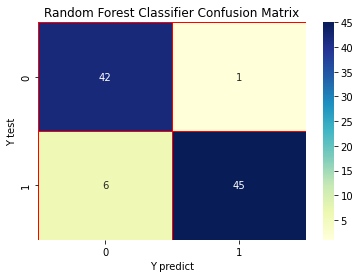

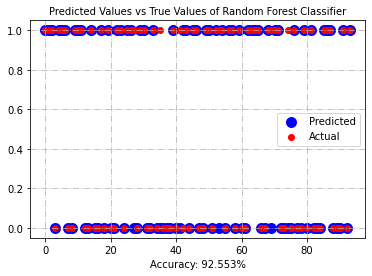

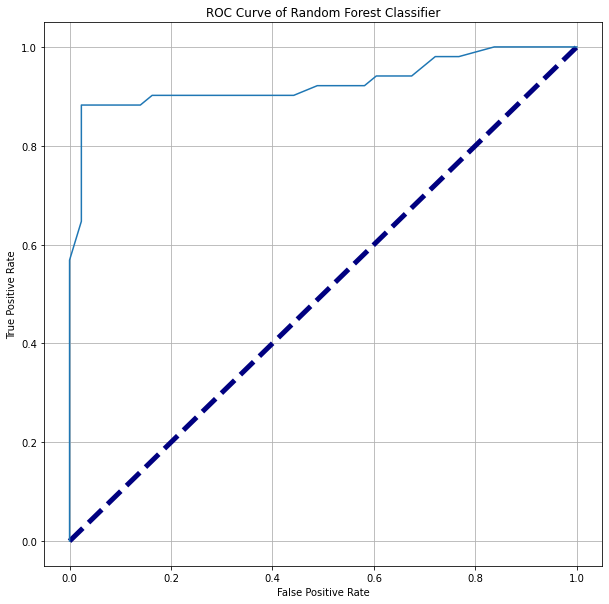

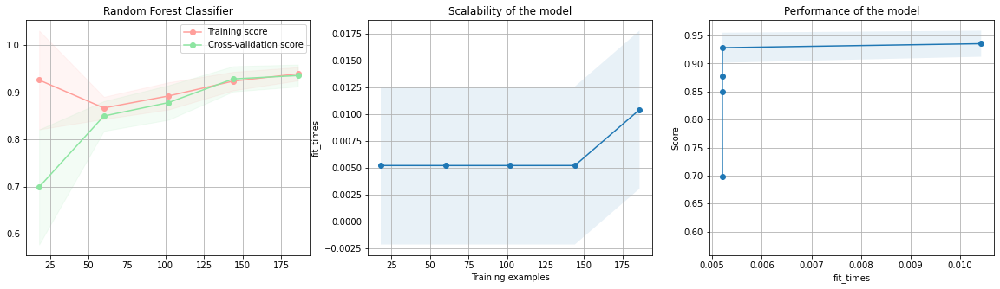

In [352]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Tuning using OOB

In [353]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [354]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [355]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(30, 4, 5)


In [356]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

RandomForestClassifier(max_depth=5, max_features=4, n_estimators=30,
                       random_state=42)

RandomForest tuned
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



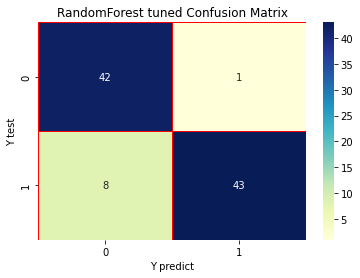

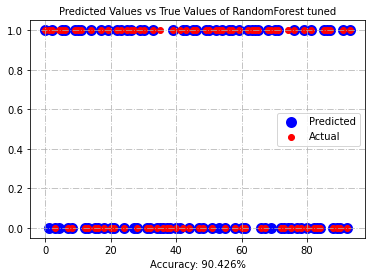

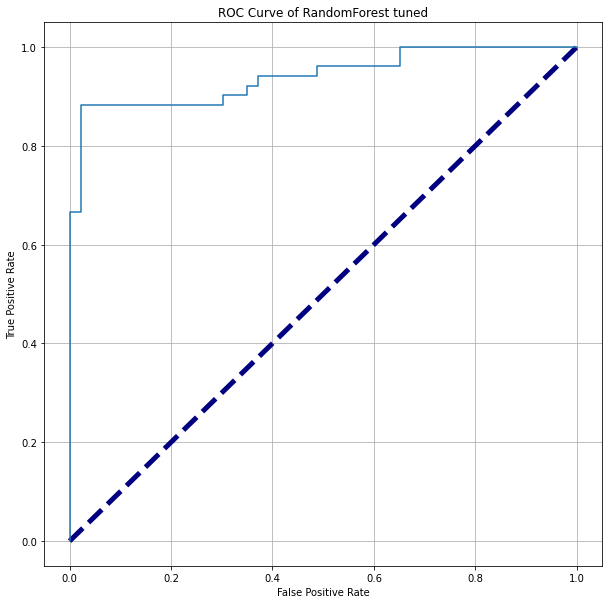

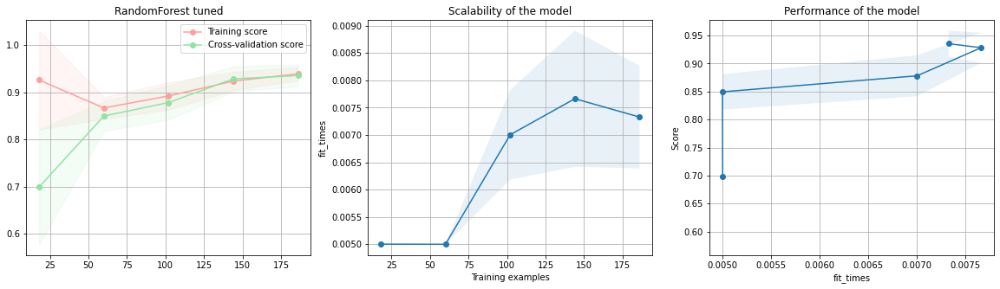

In [357]:
run_model("RandomForest tuned", rf_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

### Random Forest with Standard Scaling

Random Forest Classifier
Standard Scaler
              precision    recall  f1-score   support

           0       0.88      0.98      0.92        43
           1       0.98      0.88      0.93        51

    accuracy                           0.93        94
   macro avg       0.93      0.93      0.93        94
weighted avg       0.93      0.93      0.93        94



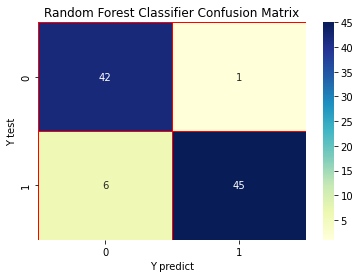

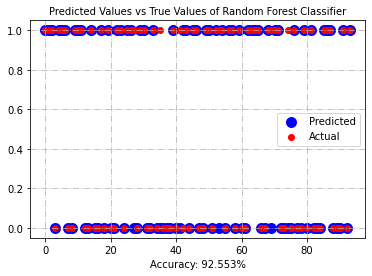

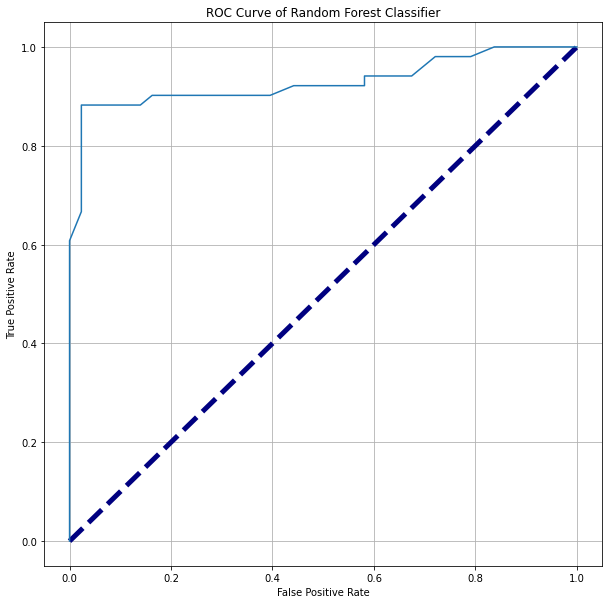

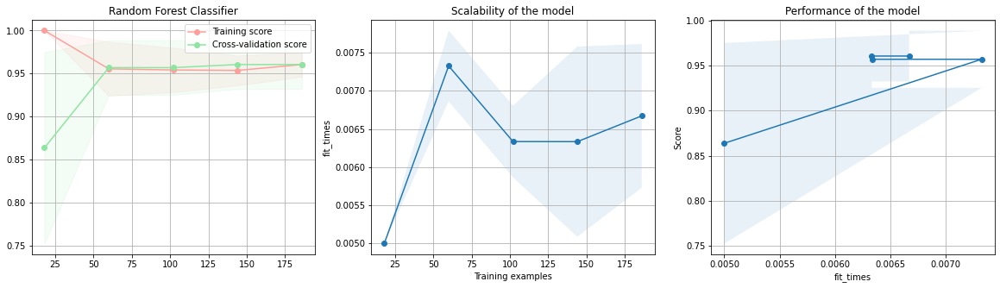

In [358]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Tuning using OOB

In [359]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [360]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [361]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(30, 4, 5)


In [362]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

RandomForestClassifier(max_depth=5, max_features=4, n_estimators=30,
                       random_state=42)

RandomForest tuned
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



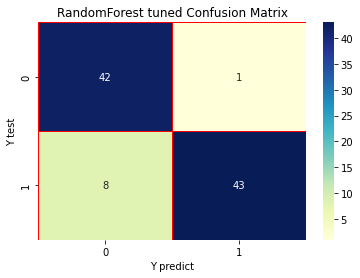

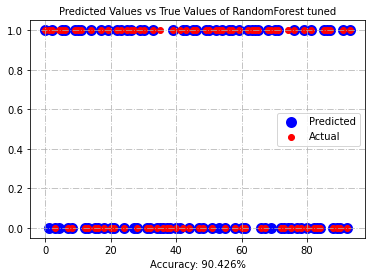

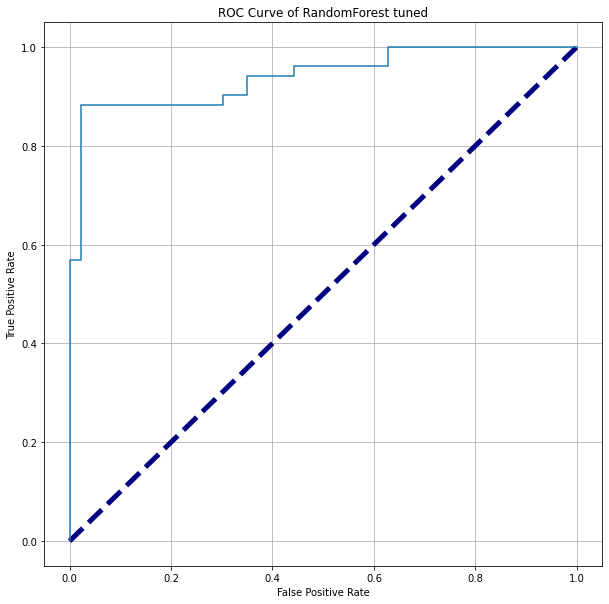

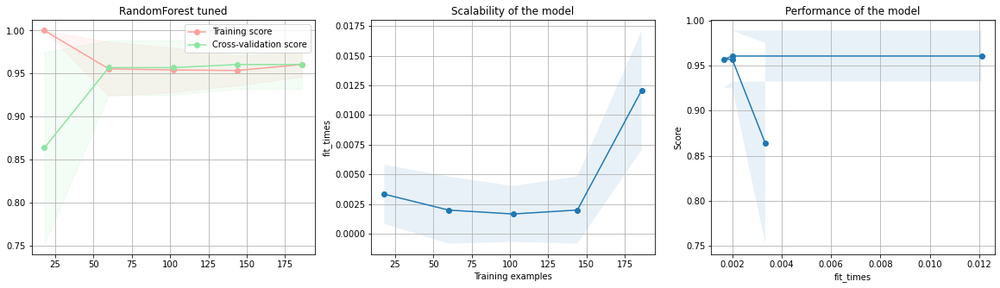

In [363]:
run_model("RandomForest tuned", rf_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

### Random Forest with Polynomial Transformation

Random Forest Classifier
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



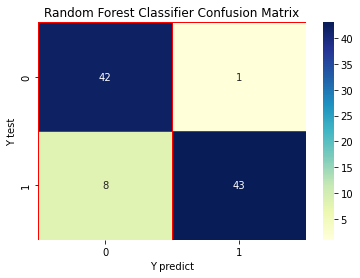

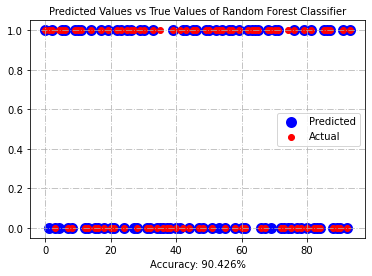

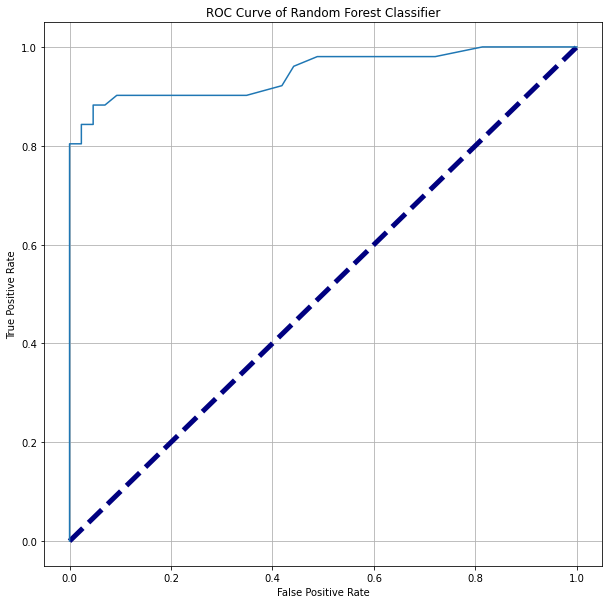

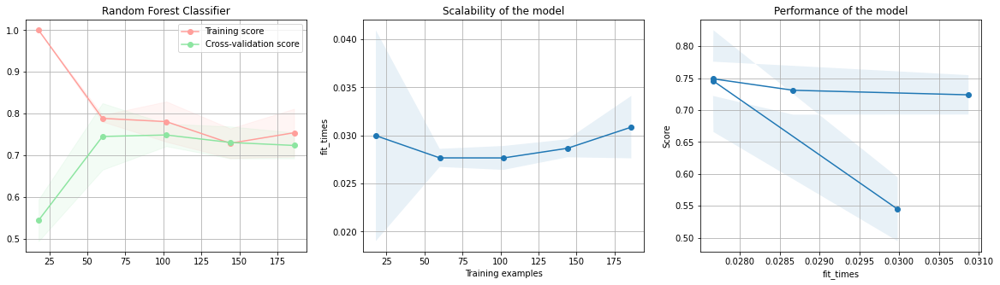

In [364]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Tuning using OOB

In [365]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [366]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [367]:
data_list["notrans"][0].shape

(279, 10)

In [368]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(10, 4, 4)


In [369]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

RandomForestClassifier(max_depth=4, max_features=4, n_estimators=10,
                       random_state=42)

RandomForest tuned
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



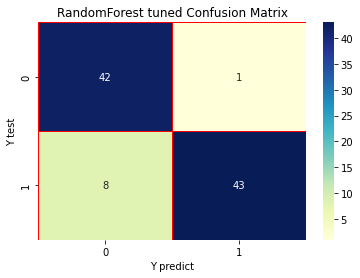

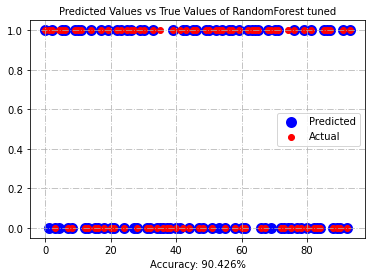

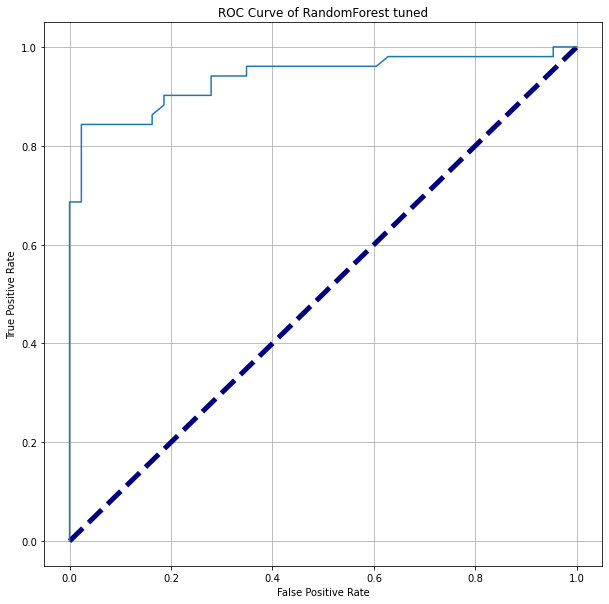

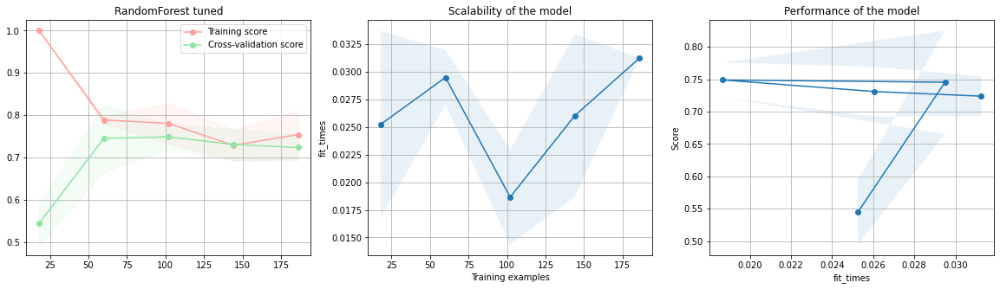

In [370]:
run_model("RandomForest tuned", rf_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

### Random Forest with MinMax Polynomial Transformation

Random Forest Classifier
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



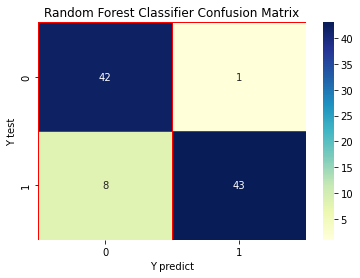

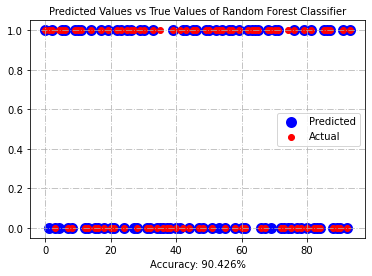

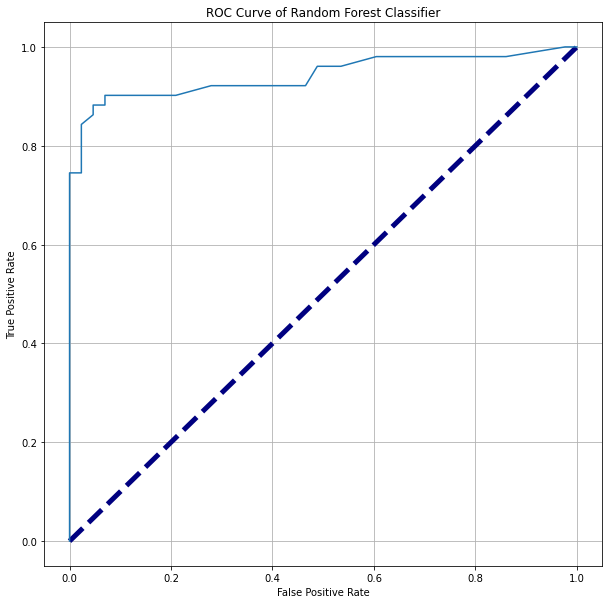

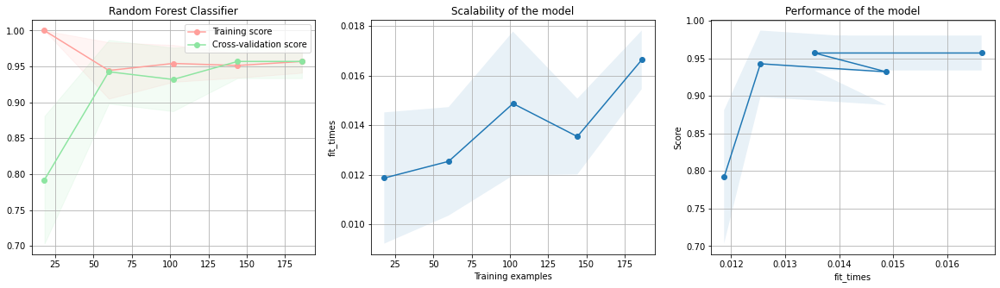

In [371]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Tuning using OOB

In [372]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [373]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [374]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(20, 8, 5)


In [375]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

RandomForestClassifier(max_depth=5, max_features=8, n_estimators=20,
                       random_state=42)

RandomForest tuned
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



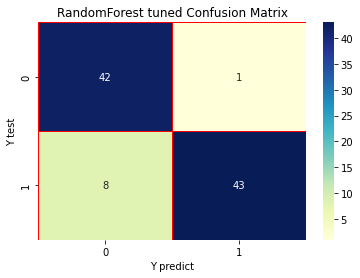

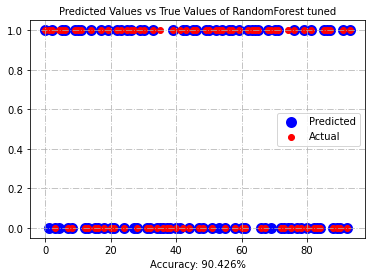

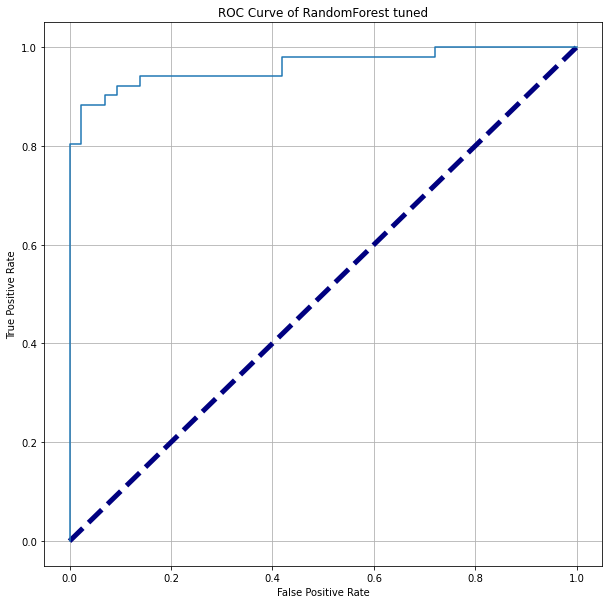

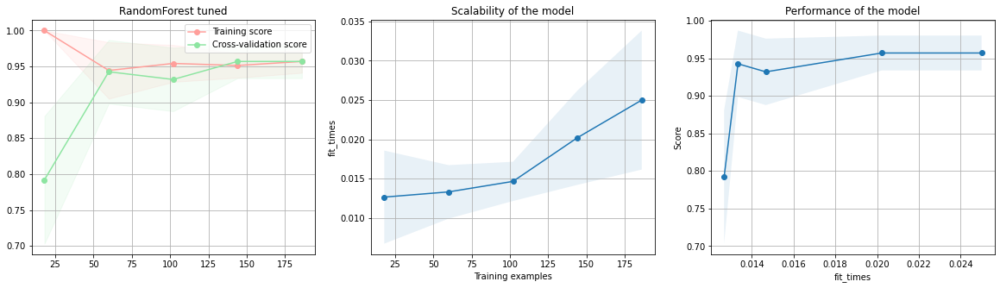

In [376]:
run_model("RandomForest tuned", rf_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

### Random Forest with Standard Scaling

Random Forest Classifier
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



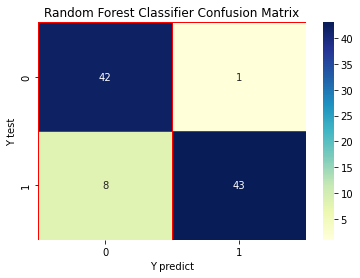

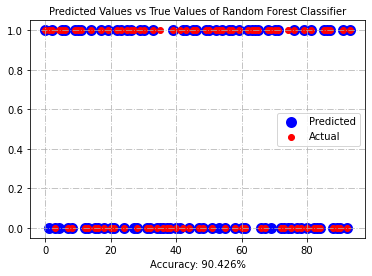

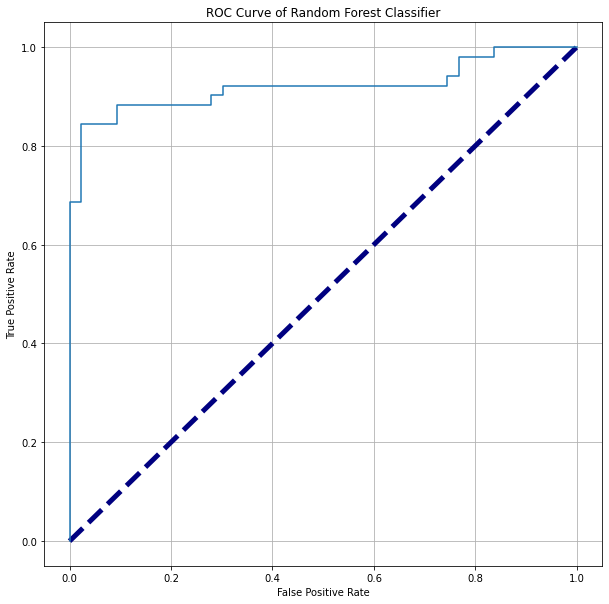

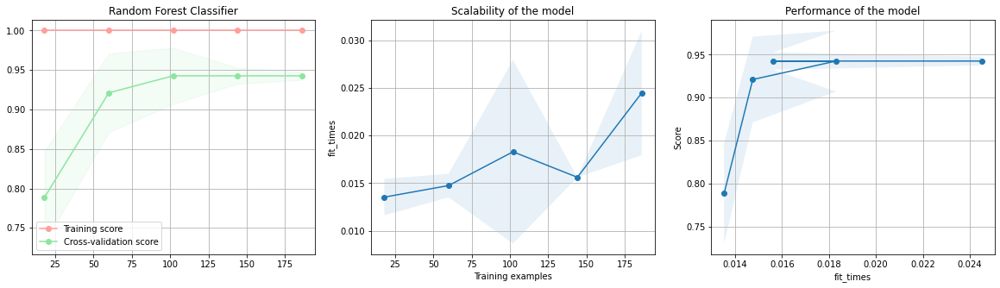

In [377]:
rf = RandomForestClassifier(random_state = rs)
run_model("Random Forest Classifier", rf_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Tuning using OOB

In [378]:
# hyperparamter list for tuning using OOB
param_dict = OrderedDict(n_estimators = [10, 20, 30, 40, 50, 100, 150, 200, 250], max_features = (range(2, 10)), max_depth=(range(2,10)))
param_list = list(product(*param_dict.values()))

In [379]:
# Fit the model for all possible combinations of param_dict
oob_dict = {}
tuning_time = {}
start = time.time()
for p in param_list:
    rf = RandomForestClassifier(n_estimators = p[0], max_features = p[1], max_depth = p[2], random_state = rs, oob_score = True)
    rf.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
    oob_error = 1 - rf.oob_score_
    oob_dict[p] = oob_error
end = time.time() - start


tuning_time["model"] = "RandomForest:  OOB"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [380]:
data_list["notrans"][0].shape

(279, 10)

In [381]:
# rf_best_params 
best_rf_p = min(zip(oob_dict.values(), oob_dict.keys()))[1]
print(best_rf_p)

(50, 8, 3)


In [382]:
# Fit new model
rf_best = RandomForestClassifier(n_estimators = best_rf_p[0], max_features = best_rf_p[1], max_depth = best_rf_p[2], random_state = rs)
rf_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

RandomForestClassifier(max_depth=3, max_features=8, n_estimators=50,
                       random_state=42)

RandomForest tuned
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



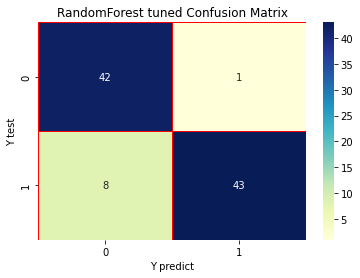

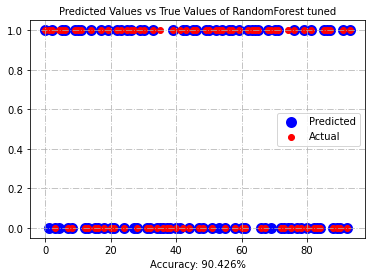

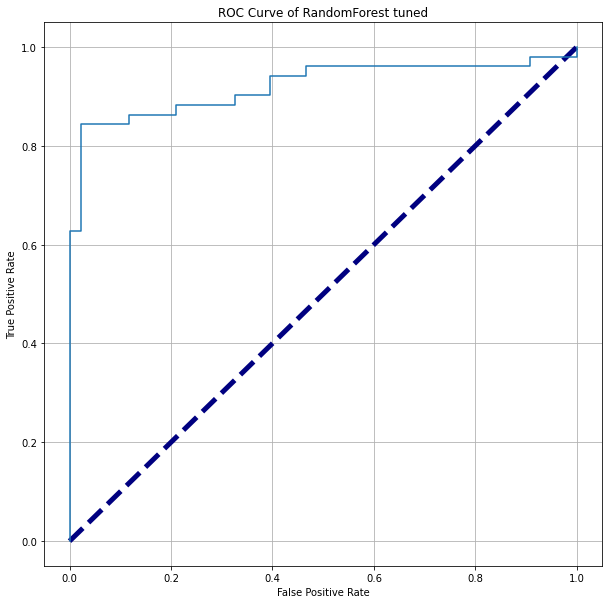

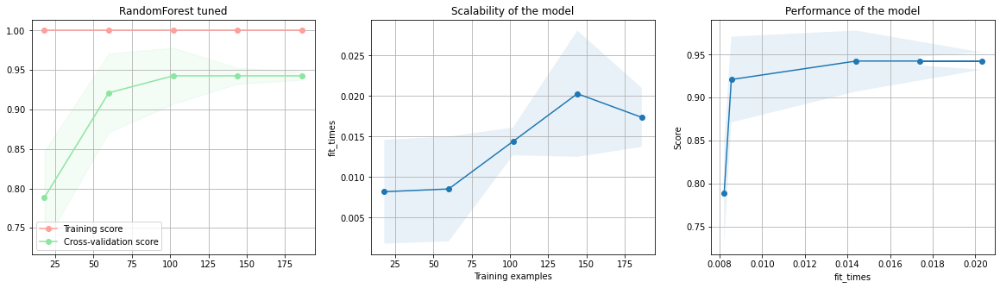

In [383]:
run_model("RandomForest tuned", rf_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

### AdaBoost 

AdaBoost Classifier
none
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



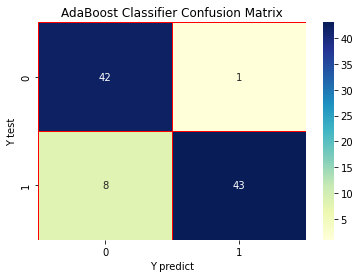

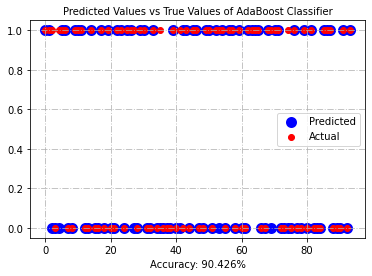

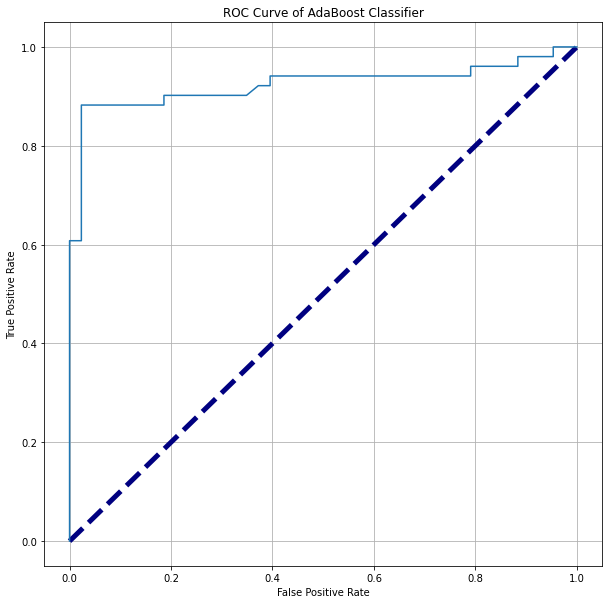

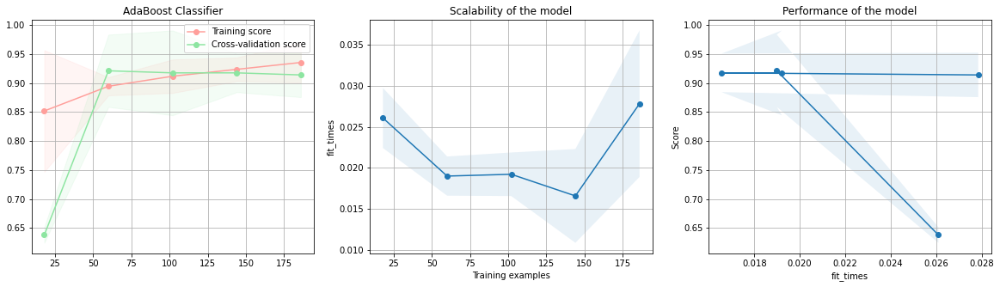

In [384]:
boost = AdaBoostClassifier(random_state = rs)
run_model("AdaBoost Classifier", boost, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "none", list_scores = list_scores)

#### Hyper Parameter Tuning

#### Grid Search

In [385]:
# Hyper-parameters tuning 
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# boosting_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(estimator = boost, param_grid = boost_params, cv = 10)


# Fit the model
start = time.time()
boostcv.fit(data_list["notrans"][0], data_list["notrans"][2])
end = time.time() - start

tuning_time["model"] = "Boosting: Gridsearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [386]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [387]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['notrans'][0], data_list['notrans'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



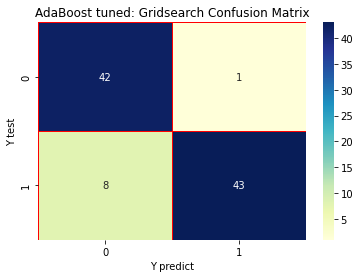

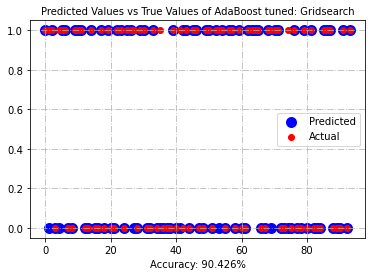

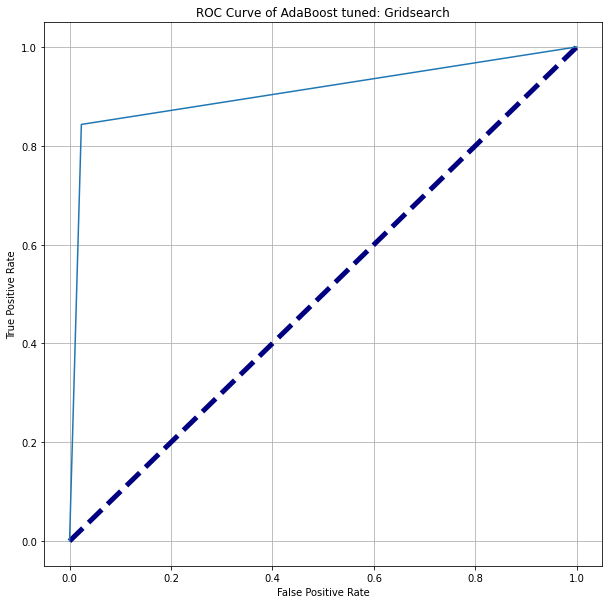

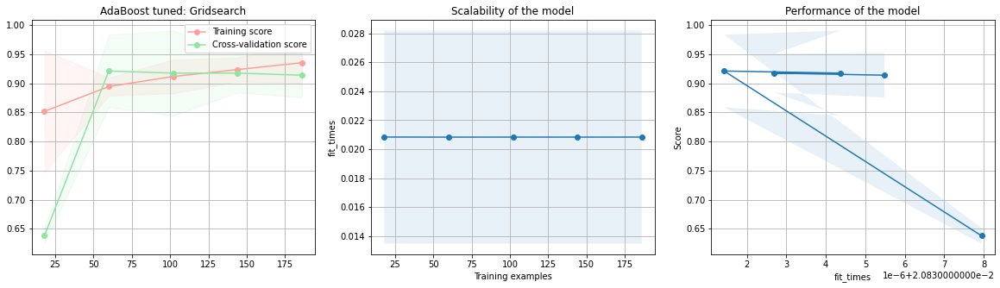

In [388]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

####  Random Search

In [389]:
# Hyper-parameters tuning
dt = DecisionTreeClassifier(random_state = rs)
bagging = BaggingClassifier(dt, random_state = rs)

# boosting_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [390]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 30
The optimal value of learning_rate is: 0.005


In [391]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['notrans'][0], data_list['notrans'][2])

AdaBoostClassifier(learning_rate=0.005, n_estimators=30, random_state=42)

AdaBoost tuned: RandomizedSearch
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



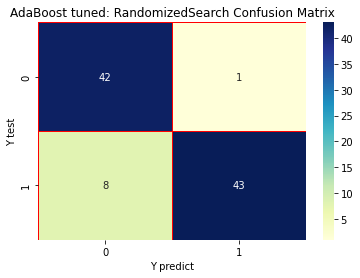

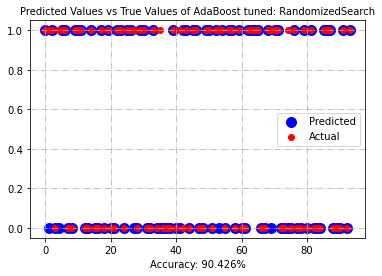

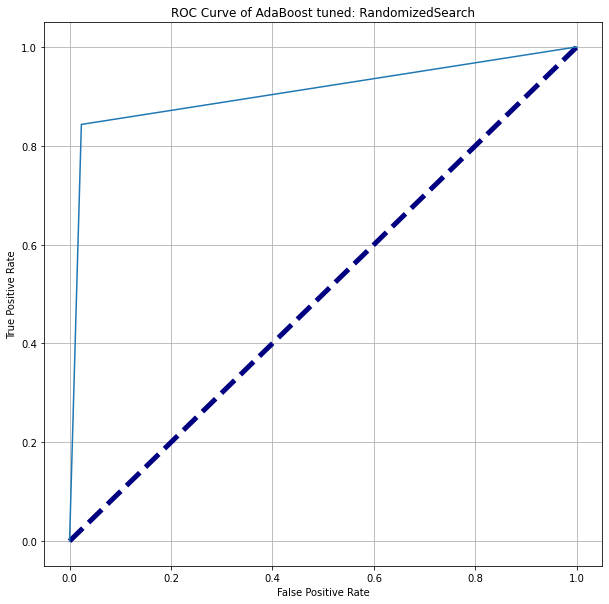

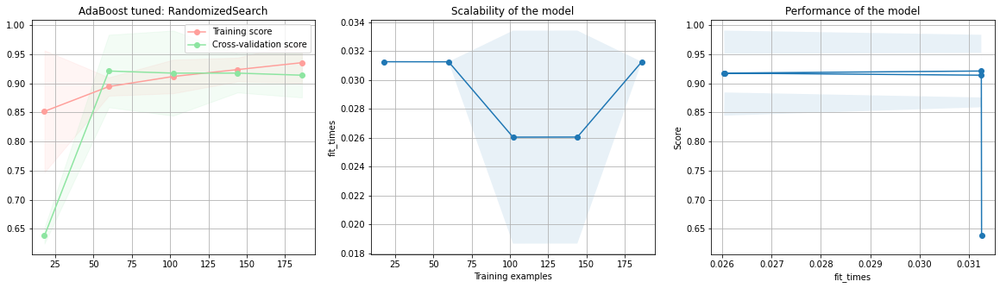

In [392]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Halving Grid Search

In [393]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [394]:
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 50
The optimal value of learning_rate is: 0.05


In [395]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['notrans'][0], data_list['notrans'][2])

AdaBoostClassifier(learning_rate=0.05, random_state=42)

AdaBoost tuned: Halving Grid Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



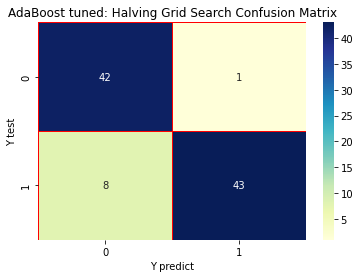

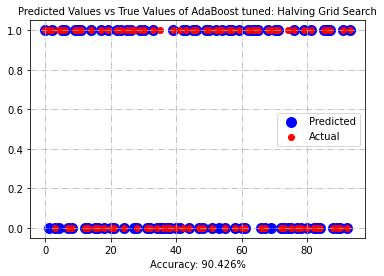

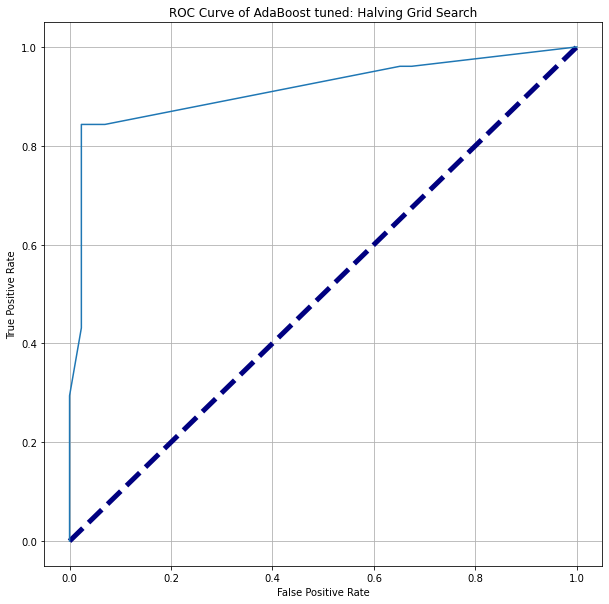

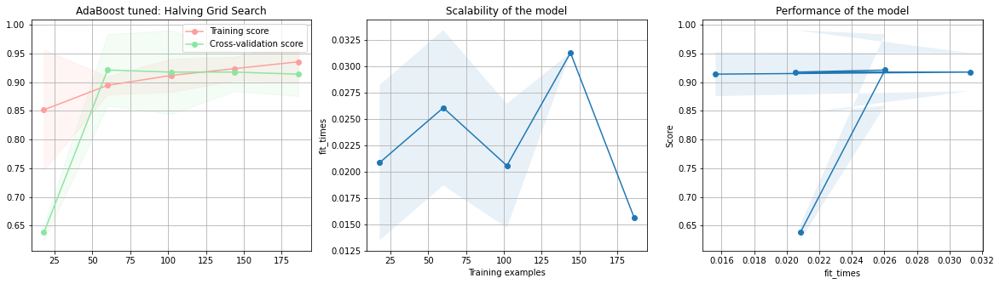

In [396]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

#### Halving Random Search

In [397]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['notrans'][0], data_list['notrans'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "None"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [398]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.005


In [399]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['notrans'][0], data_list['notrans'][2])

AdaBoostClassifier(learning_rate=0.005, n_estimators=10, random_state=42)

AdaBoost tuned: Halving Random Search
None
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



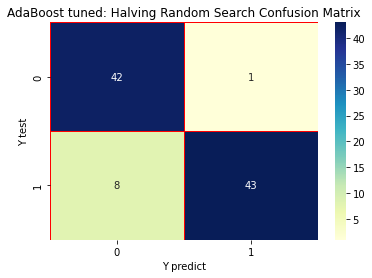

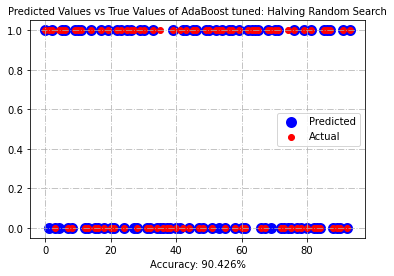

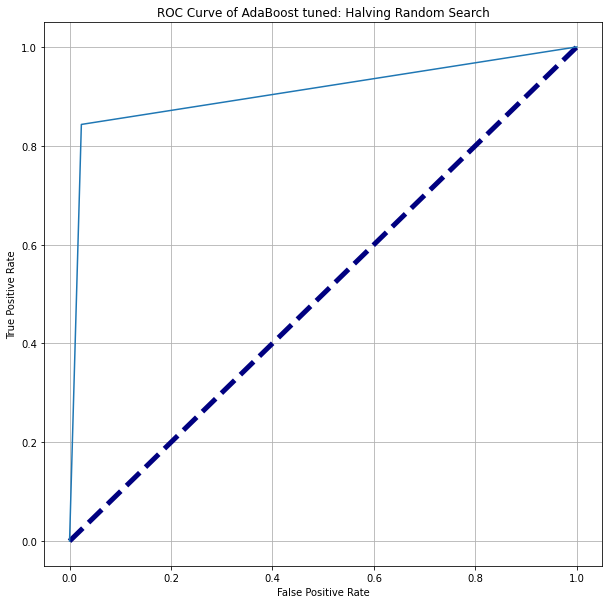

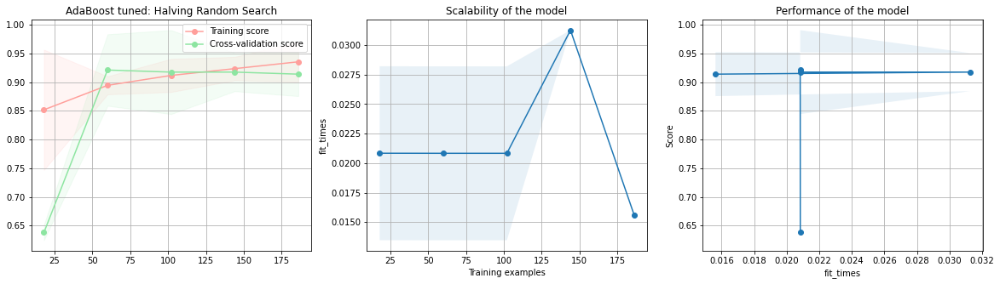

In [400]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['notrans'][0], data_list['notrans'][1], data_list['notrans'][2], data_list['notrans'][3], fc = "None", list_scores = list_scores)

### AdaBoost Classifier with minmax scaling

Boosting Classifier
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



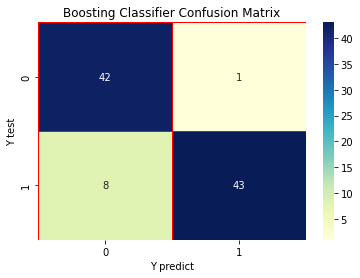

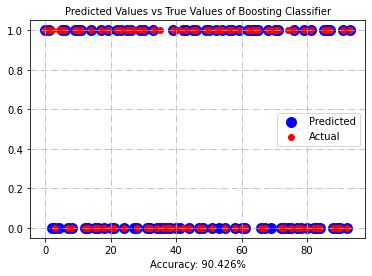

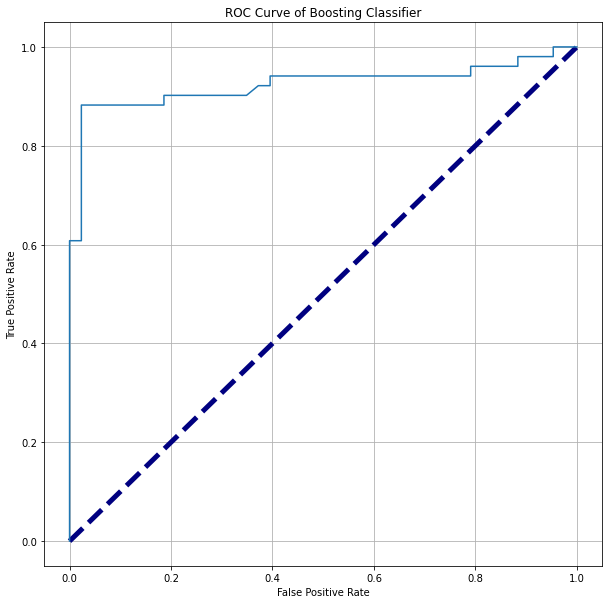

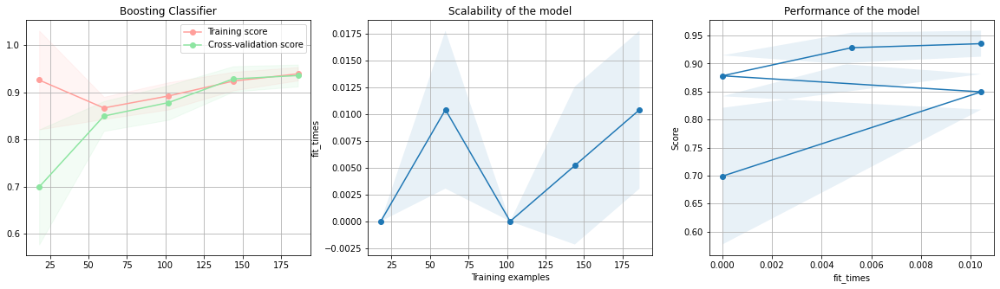

In [401]:
# Base model
boost = AdaBoostClassifier(random_state = rs)
run_model("Boosting Classifier", boost, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [402]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: Gridsearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [403]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')


The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [404]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



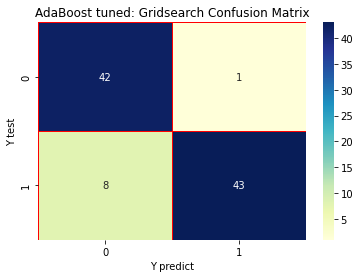

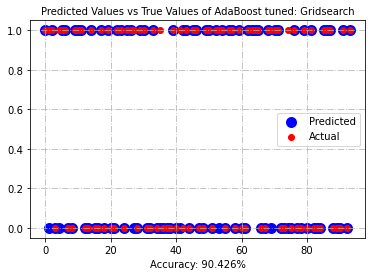

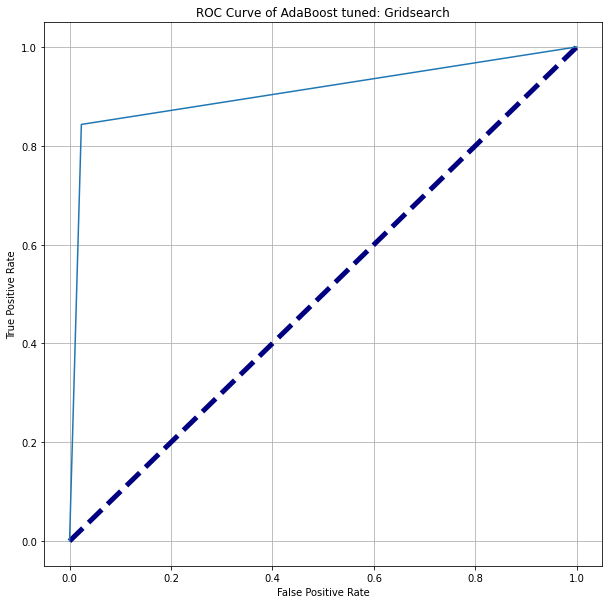

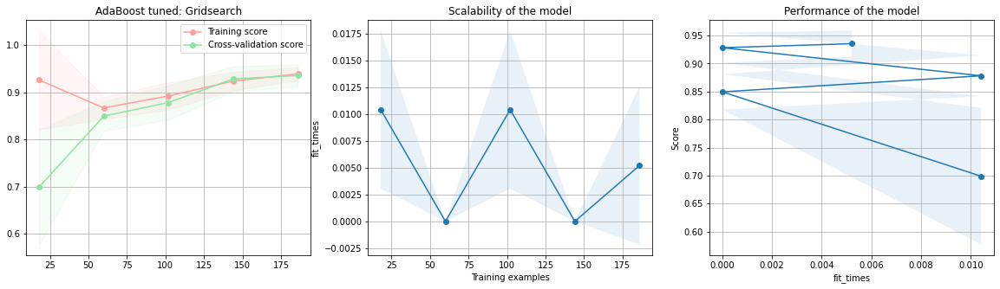

In [405]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

####  Random Search

In [406]:
# Hyper-parameters tuning
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [407]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 200
The optimal value of learning_rate is: 0.01


In [408]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['notrans'][0], data_list['notrans'][2])


AdaBoostClassifier(learning_rate=0.01, n_estimators=200, random_state=42)

AdaBoost tuned: RandomizedSearch
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



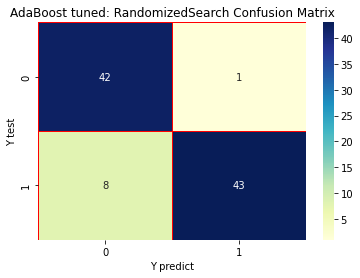

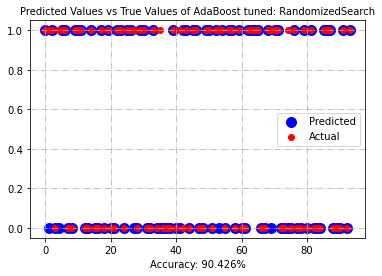

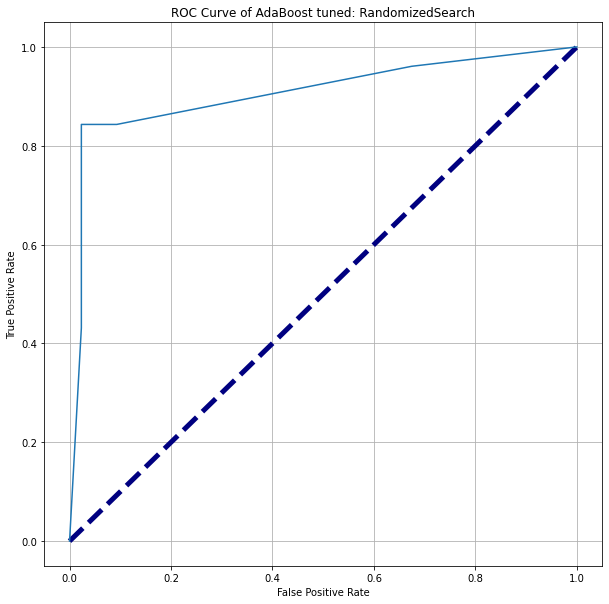

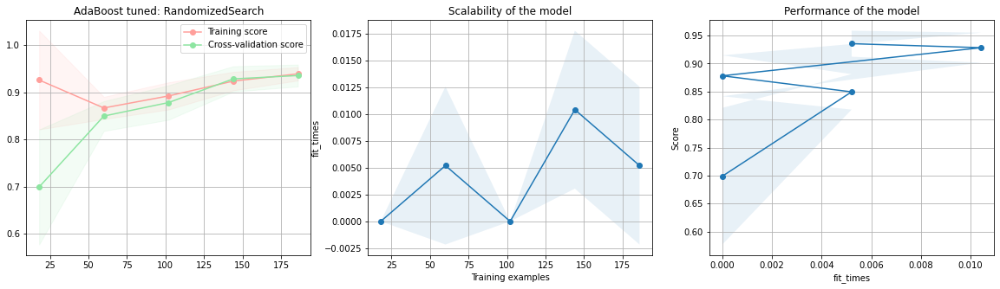

In [409]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Halving Grid Search

In [410]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [411]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 20
The optimal value of learning_rate is: 0.001


In [412]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=20, random_state=42)

AdaBoost tuned: Halving Grid Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



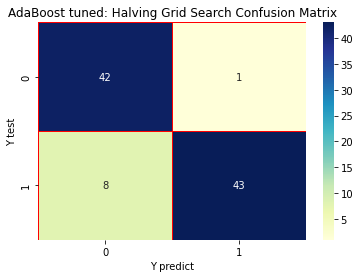

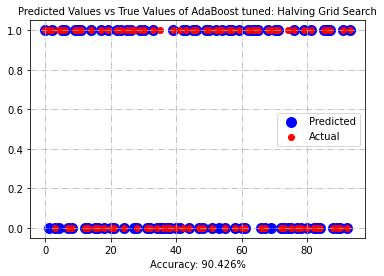

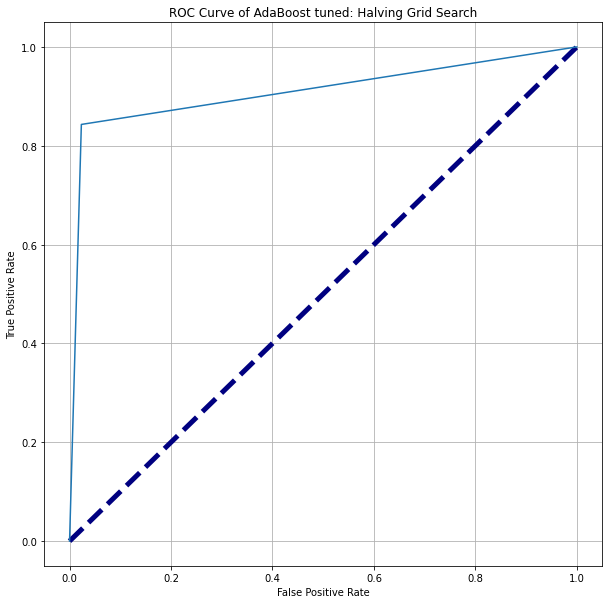

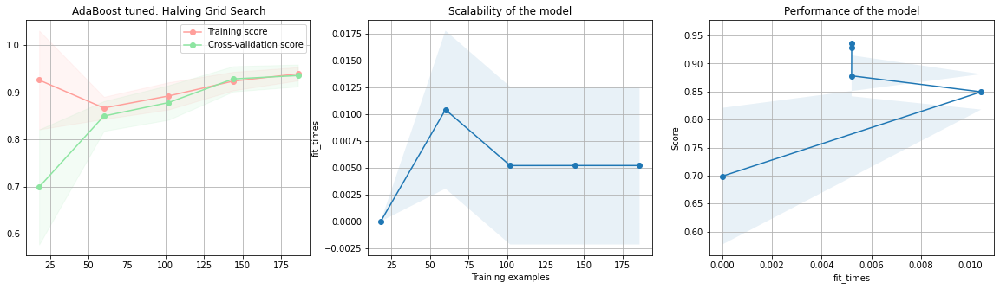

In [413]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

#### Halving Random Search

In [414]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "Min-Max Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [415]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 40
The optimal value of learning_rate is: 2


In [416]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['minmax_scaler'][0], data_list['minmax_scaler'][2])

AdaBoostClassifier(learning_rate=2, n_estimators=40, random_state=42)

AdaBoost tuned: Halving Random Search
Min-Max Scaler
              precision    recall  f1-score   support

           0       0.47      0.51      0.49        43
           1       0.55      0.51      0.53        51

    accuracy                           0.51        94
   macro avg       0.51      0.51      0.51        94
weighted avg       0.51      0.51      0.51        94



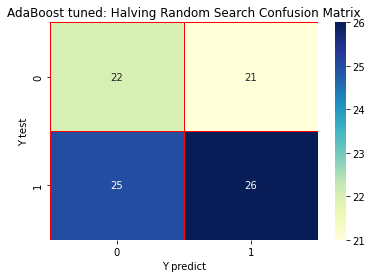

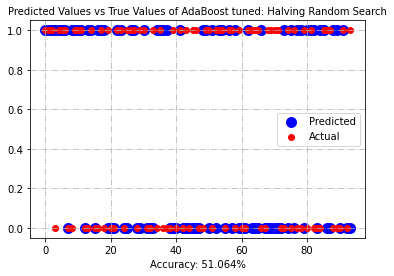

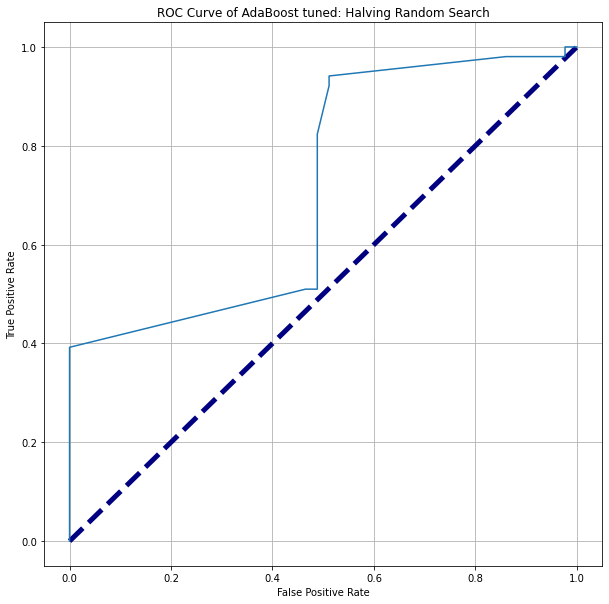

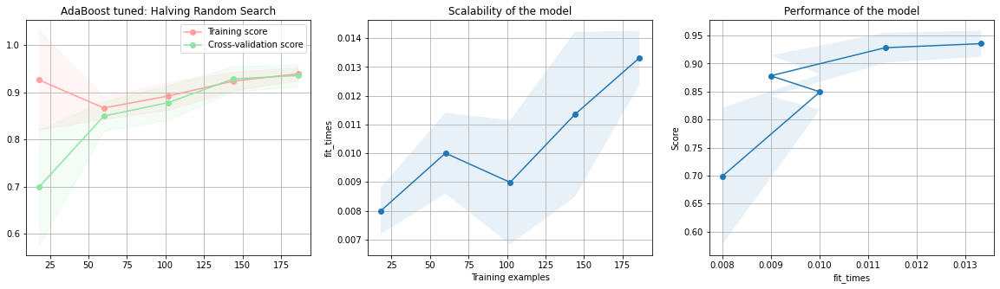

In [417]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['minmax_scaler'][0], data_list['minmax_scaler'][1], data_list['minmax_scaler'][2], data_list['minmax_scaler'][3], fc = "Min-Max Scaler", list_scores = list_scores)

### AdaBoost Classifier with standard scaling

Boosting Classifier
Standard Scaler
              precision    recall  f1-score   support

           0       0.85      0.95      0.90        43
           1       0.96      0.86      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



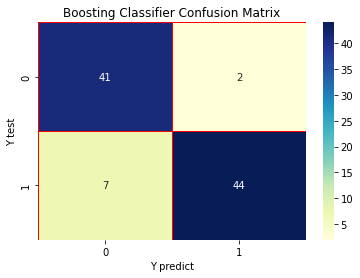

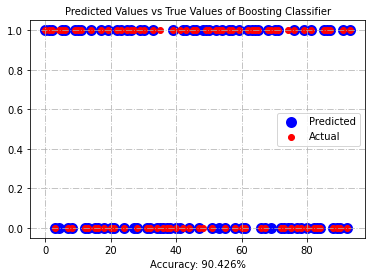

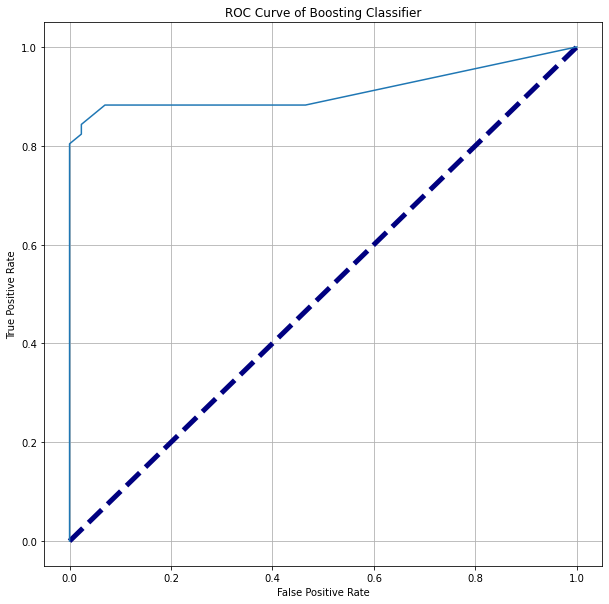

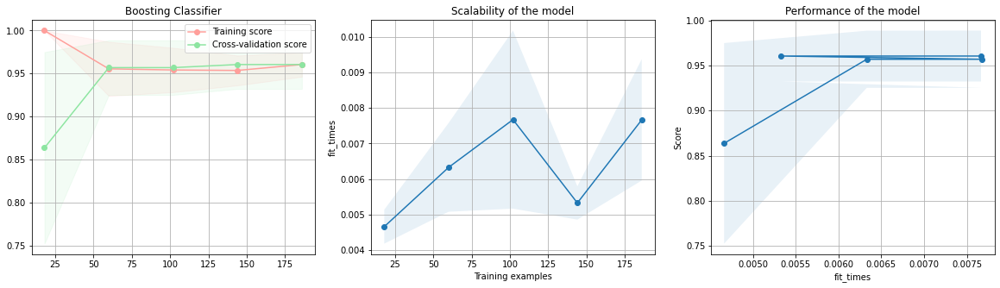

In [418]:
# Base model
boost = AdaBoostClassifier(random_state = rs)
run_model("Boosting Classifier", bgc, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [419]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(estimator = boost, param_grid = boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: Gridsearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [420]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [421]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



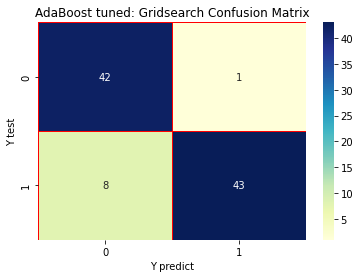

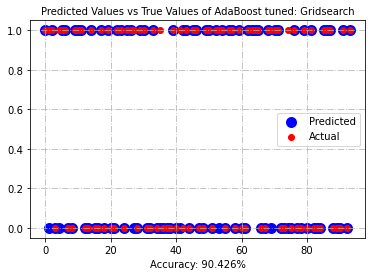

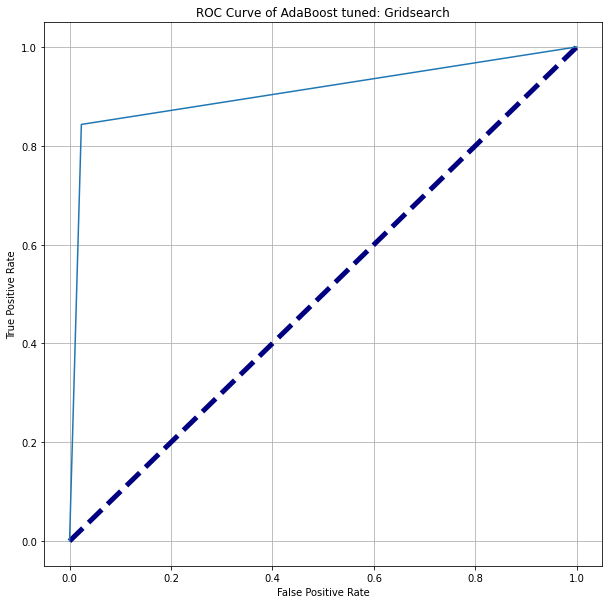

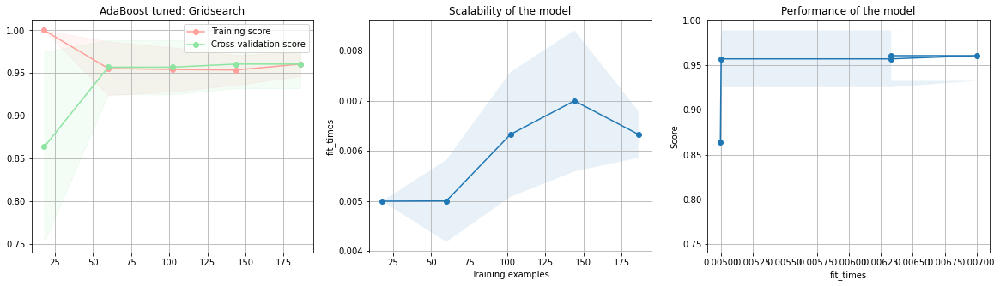

In [422]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

####  Random Search

In [423]:
# Hyper-parameters tuning
boost = AdaBoostClassifier(random_state = rs)
# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [424]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 50
The optimal value of learning_rate is: 0.01


In [425]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

AdaBoostClassifier(learning_rate=0.01, random_state=42)

AdaBoost tuned: RandomizedSearch
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



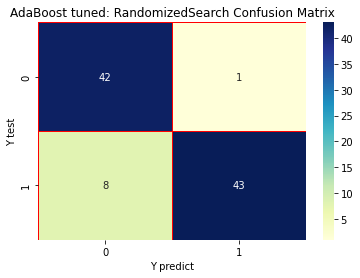

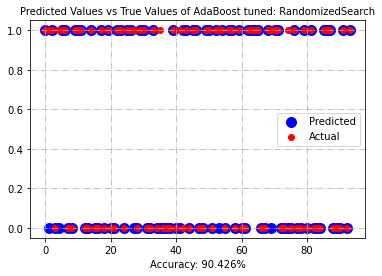

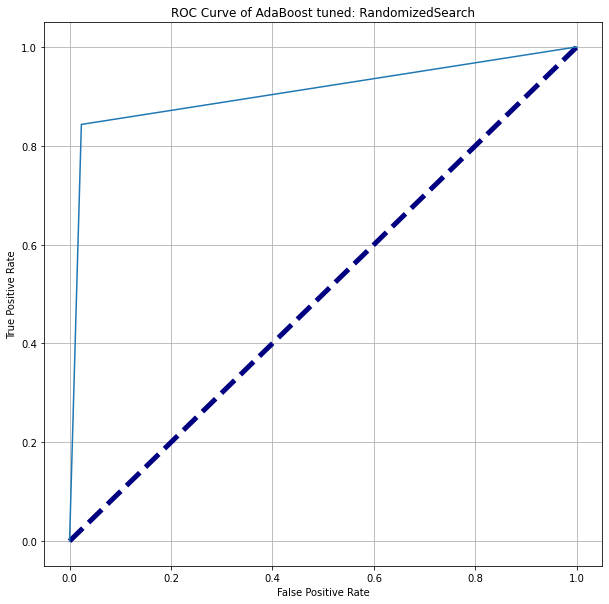

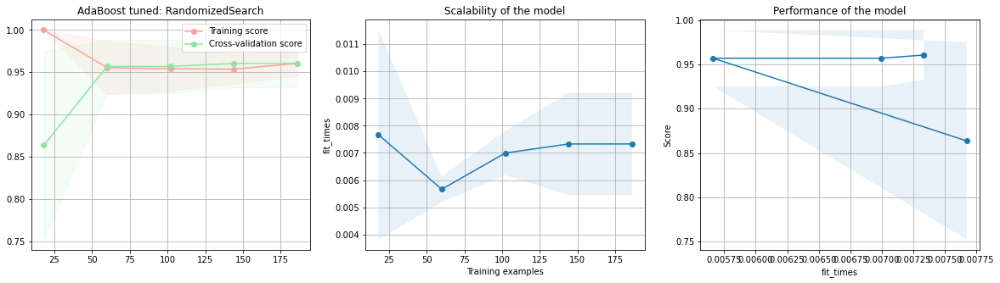

In [426]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best,data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Halving Grid Search

In [427]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [428]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 50
The optimal value of learning_rate is: 0.05


In [429]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])

AdaBoostClassifier(learning_rate=0.05, random_state=42)

AdaBoost tuned: Halving Grid Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



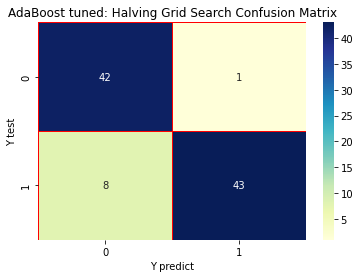

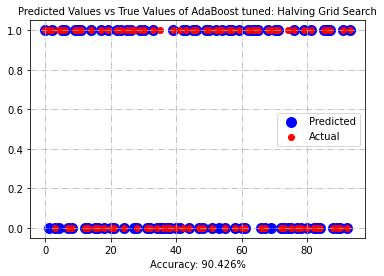

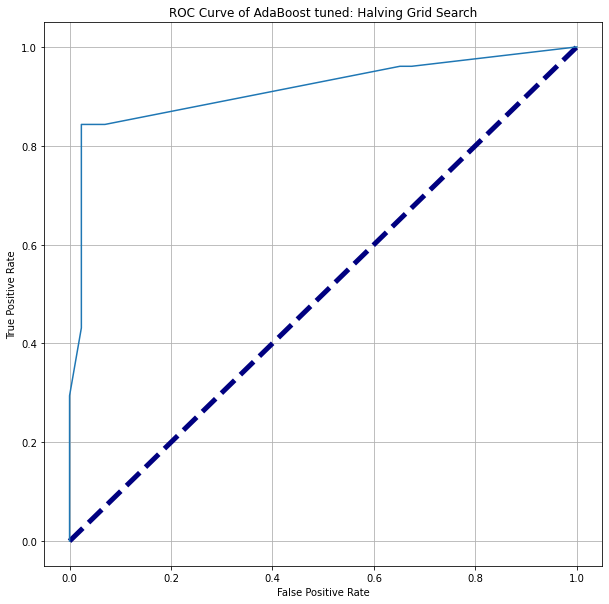

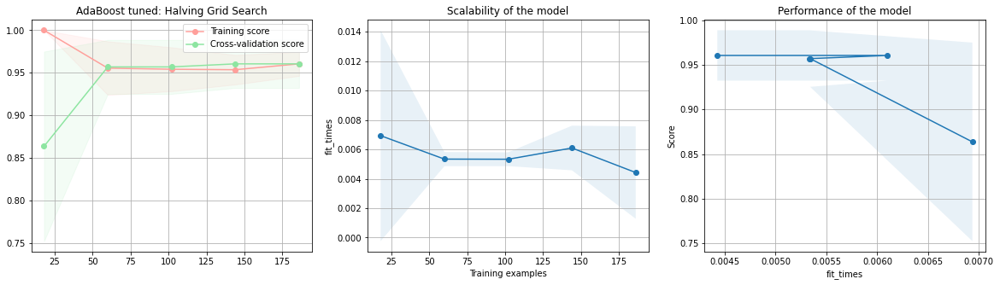

In [430]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

#### Halving Random Search

In [431]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "Standard Scaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [432]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 50
The optimal value of learning_rate is: 0.005


In [433]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['standard_scaler'][0], data_list['standard_scaler'][2]) 

AdaBoostClassifier(learning_rate=0.005, random_state=42)

AdaBoost tuned: Halving Random Search
Standard Scaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



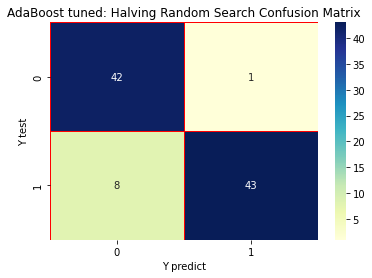

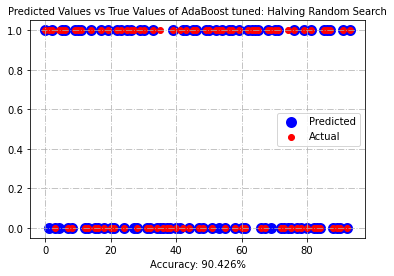

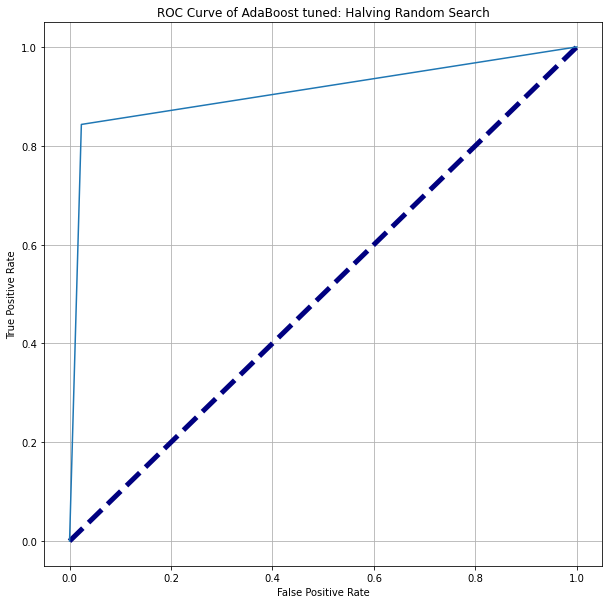

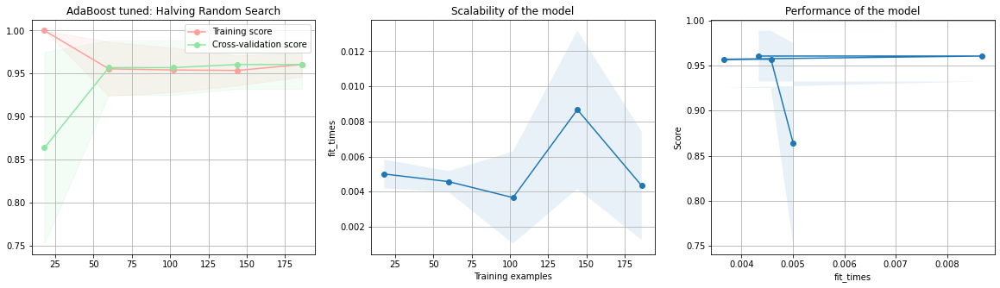

In [434]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['standard_scaler'][0], data_list['standard_scaler'][1], data_list['standard_scaler'][2], data_list['standard_scaler'][3], fc = "Standard Scaler", list_scores = list_scores)

### AdaBoost Classifier with Polynomial Transformation

Boosting Classifier
Polynomial
              precision    recall  f1-score   support

           0       0.88      0.98      0.92        43
           1       0.98      0.88      0.93        51

    accuracy                           0.93        94
   macro avg       0.93      0.93      0.93        94
weighted avg       0.93      0.93      0.93        94



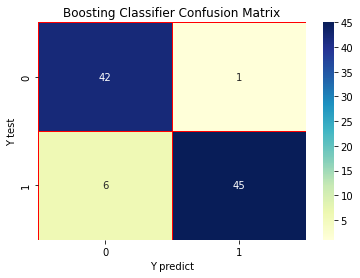

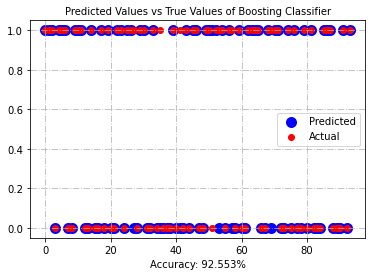

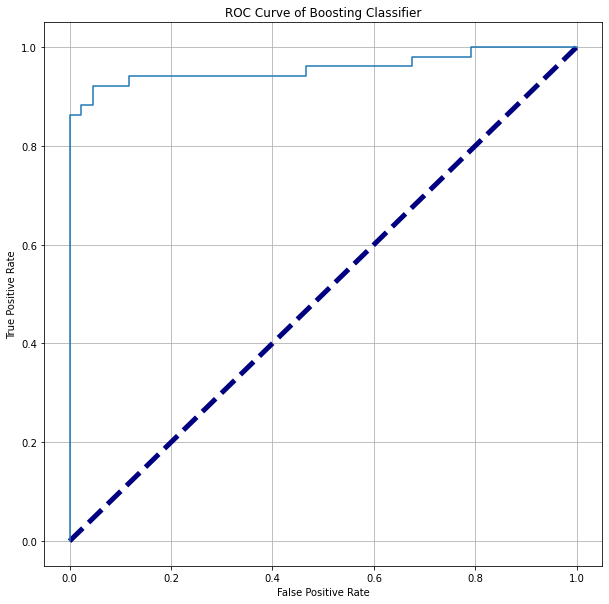

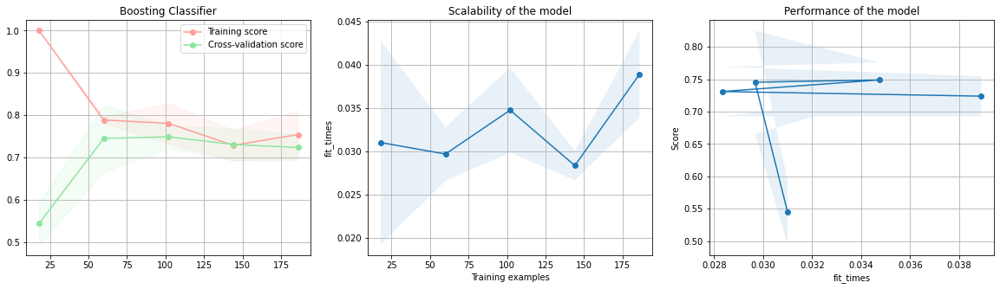

In [435]:
# Base model
boost = AdaBoostClassifier(random_state = rs)
run_model("Boosting Classifier", boost, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [436]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(estimator = boost, param_grid = boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: Gridsearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [437]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [438]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



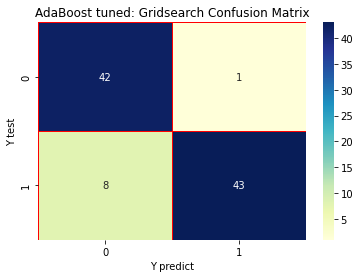

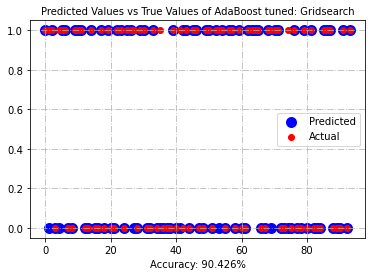

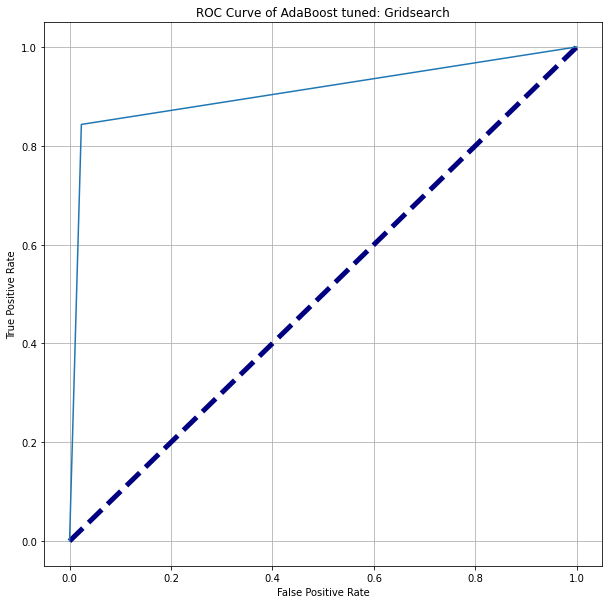

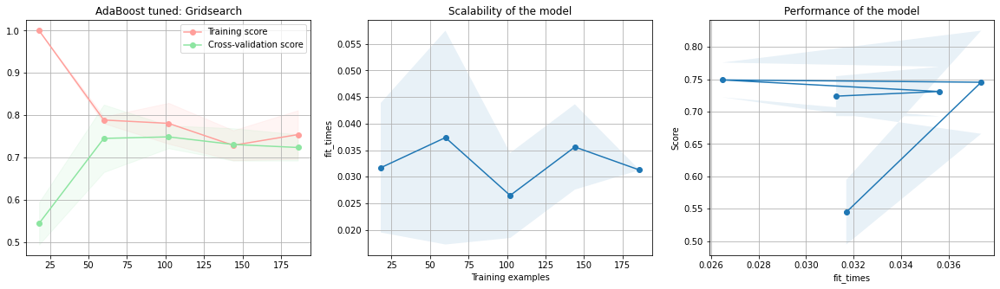

In [439]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

####  Random Search

In [440]:
# Hyper-parameters tuning
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [441]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.01


In [442]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

AdaBoostClassifier(learning_rate=0.01, n_estimators=10, random_state=42)

AdaBoost tuned: RandomizedSearch
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



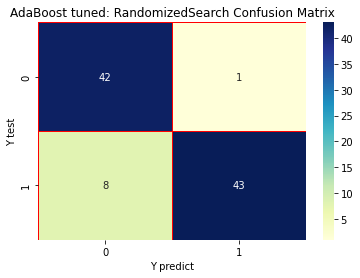

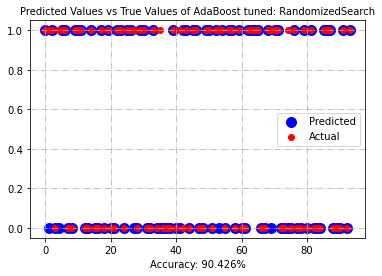

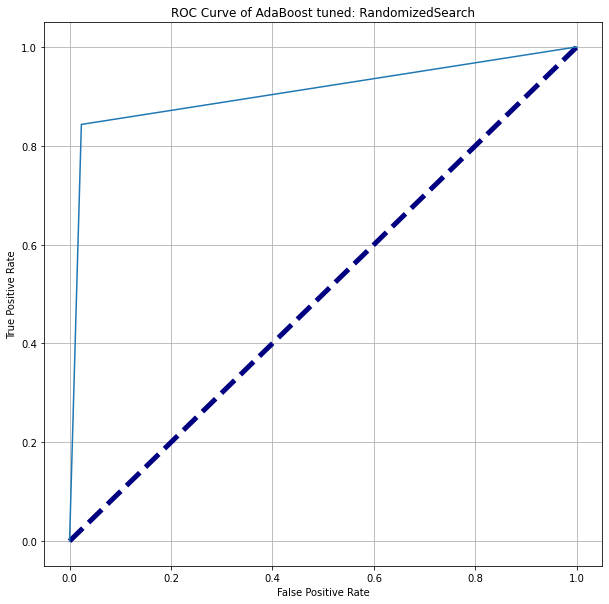

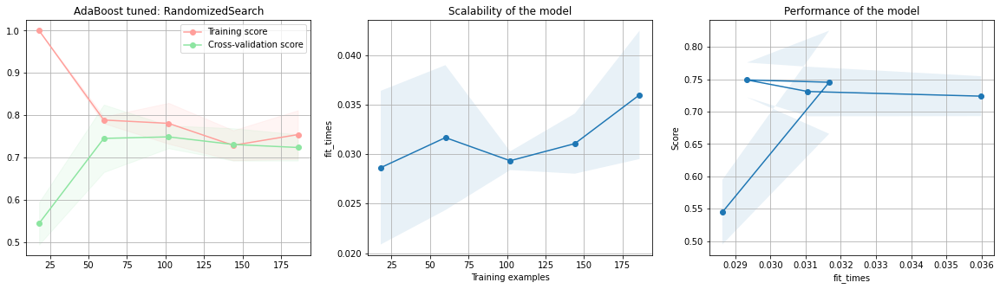

In [443]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Halving Grid Search

In [444]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [445]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 40
The optimal value of learning_rate is: 0.005


In [446]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])

AdaBoostClassifier(learning_rate=0.005, n_estimators=40, random_state=42)

AdaBoost tuned: Halving Grid Search
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



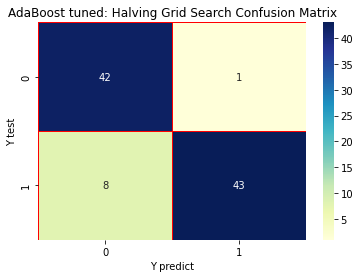

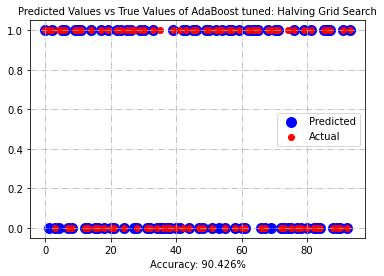

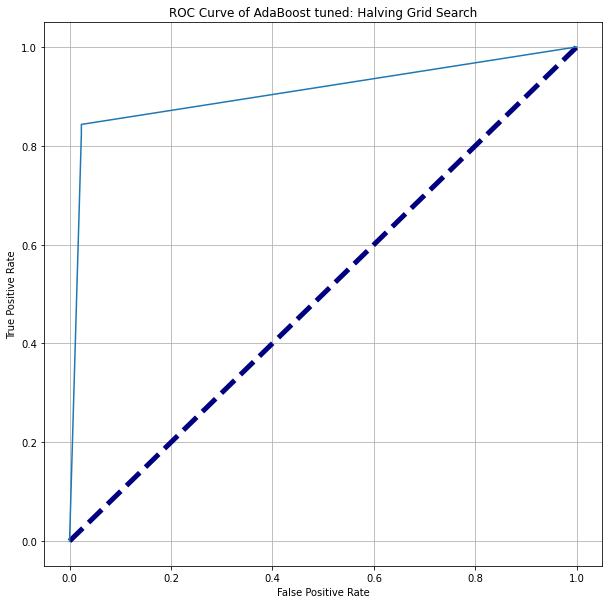

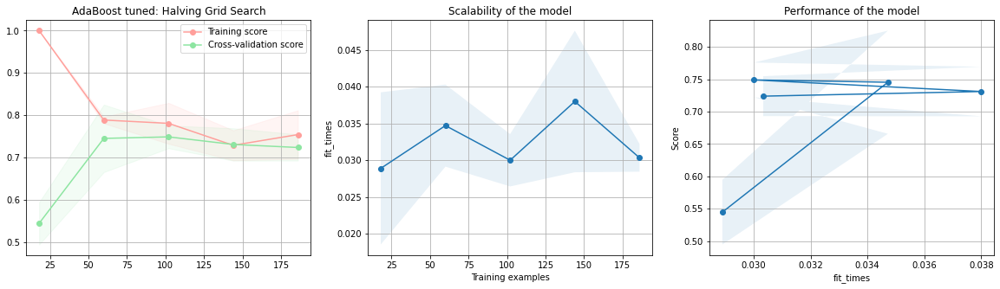

In [447]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

#### Halving Random Search

In [448]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_normal'][0], data_list['poly_normal'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [449]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 40
The optimal value of learning_rate is: 0.01


In [450]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_normal'][0], data_list['poly_normal'][2]) 

AdaBoostClassifier(learning_rate=0.01, n_estimators=40, random_state=42)

AdaBoost tuned: Halving Random Search
Polynomial
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



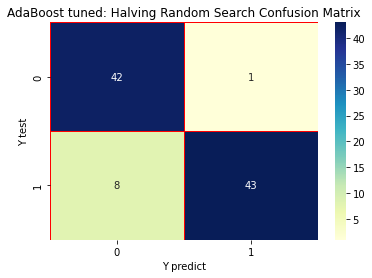

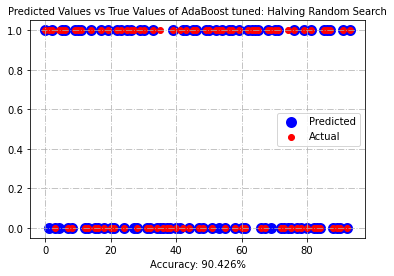

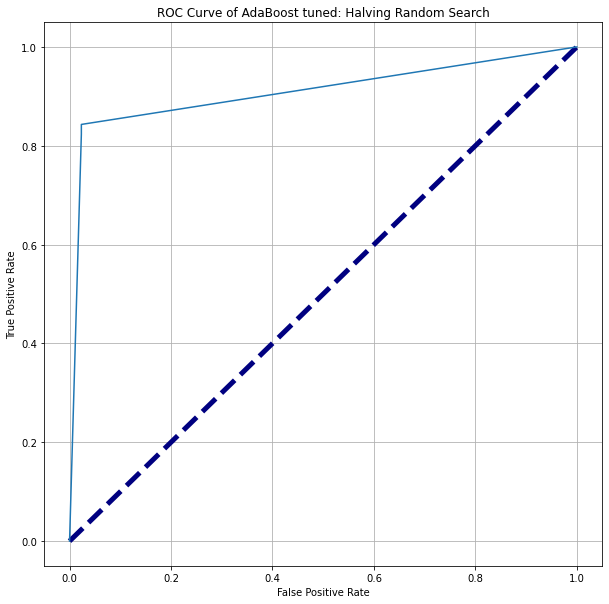

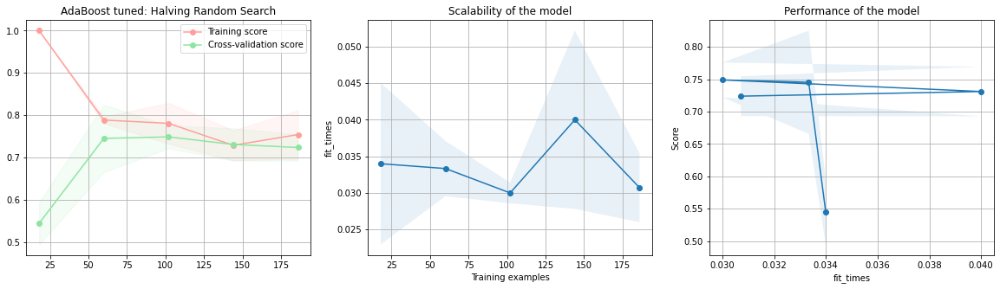

In [451]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['poly_normal'][0], data_list['poly_normal'][1], data_list['poly_normal'][2], data_list['poly_normal'][3], fc = "Polynomial", list_scores = list_scores)

### AdaBoost Classifier with MinMax Polynomial Transformation

Boosting Classifier
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.82      0.93      0.87        43
           1       0.93      0.82      0.87        51

    accuracy                           0.87        94
   macro avg       0.87      0.88      0.87        94
weighted avg       0.88      0.87      0.87        94



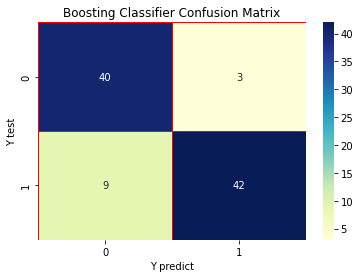

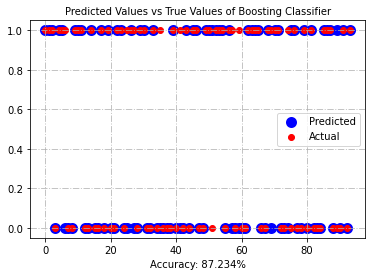

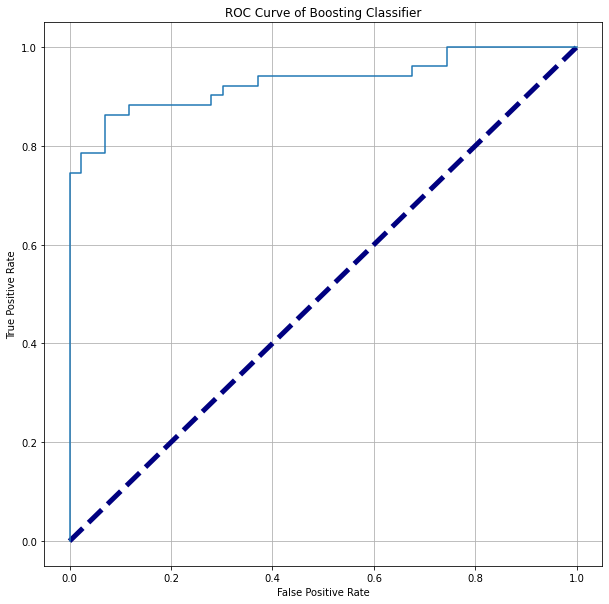

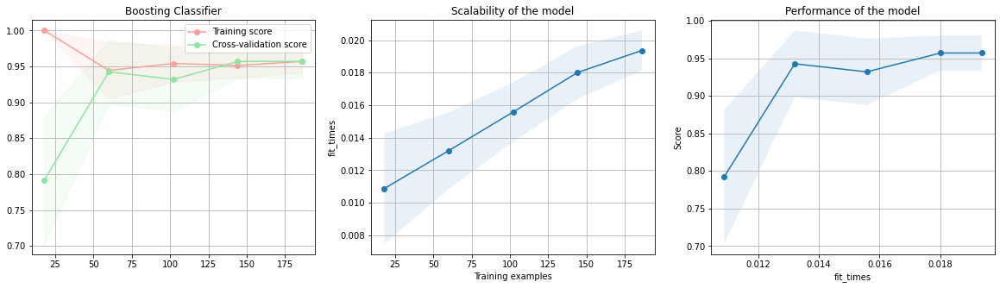

In [452]:
# Base model
boost = AdaBoostClassifier(random_state = rs)
run_model("Boosting Classifier", boost, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [453]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(estimator = boost, param_grid = boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: Gridsearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [454]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [455]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



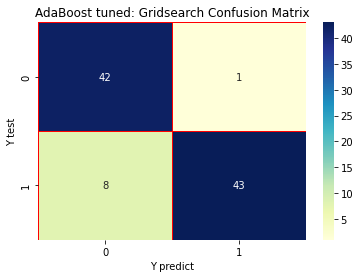

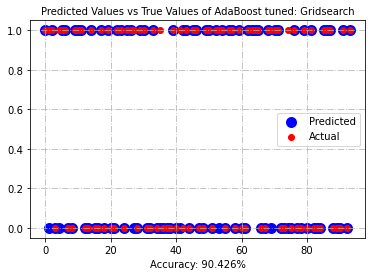

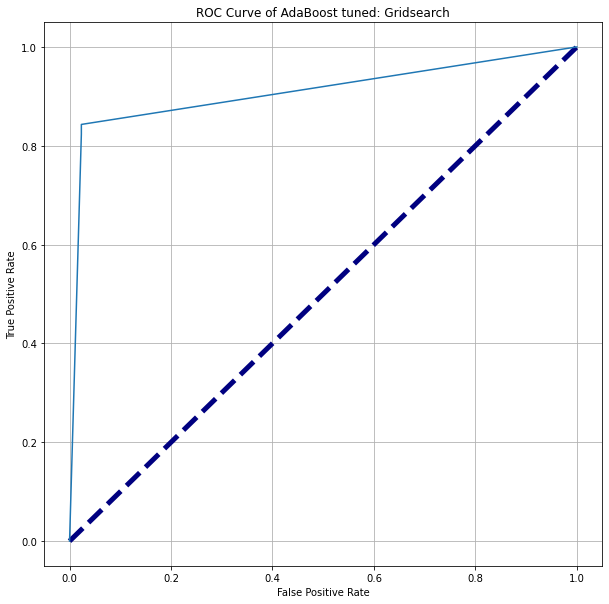

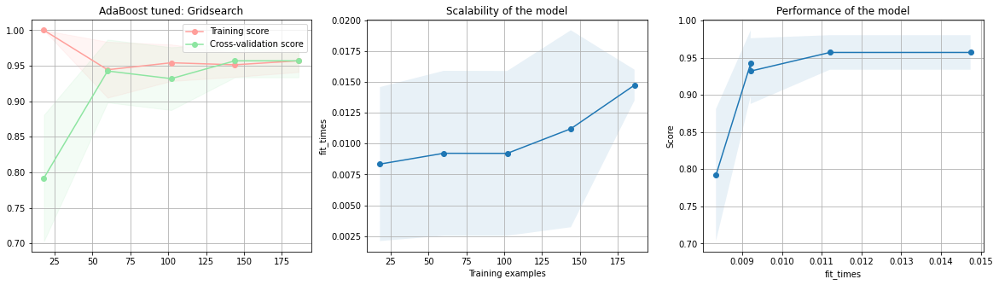

In [456]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

####  Random Search

In [457]:
# Hyper-parameters tuning
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [458]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 100
The optimal value of learning_rate is: 0.01


In [459]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

AdaBoostClassifier(learning_rate=0.01, n_estimators=100, random_state=42)

AdaBoost tuned: RandomizedSearch
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



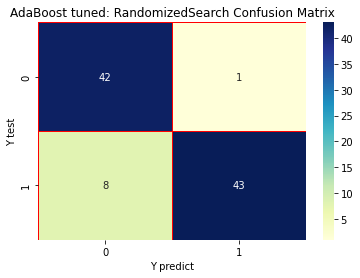

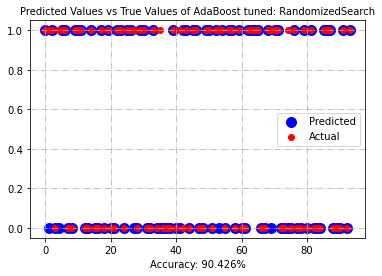

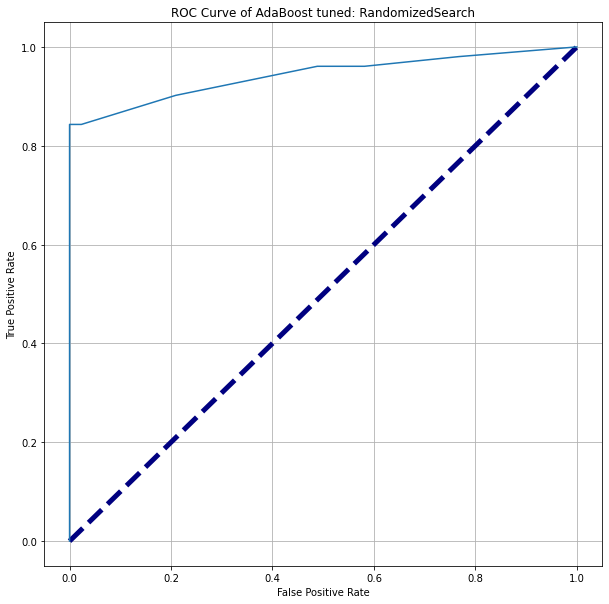

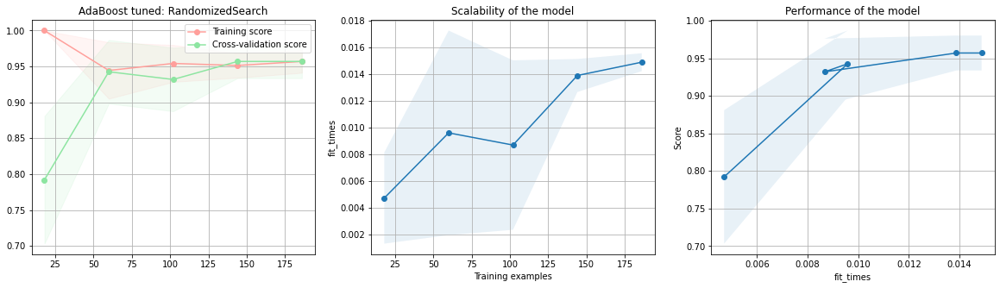

In [460]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Halving Grid Search

In [461]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)


# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [462]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 200
The optimal value of learning_rate is: 0.001


In [463]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=200, random_state=42)

AdaBoost tuned: Halving Grid Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



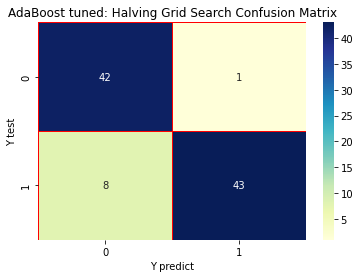

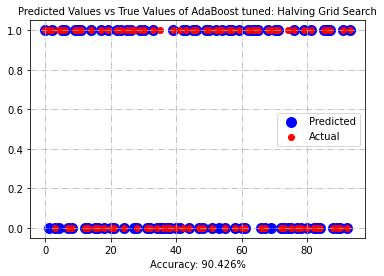

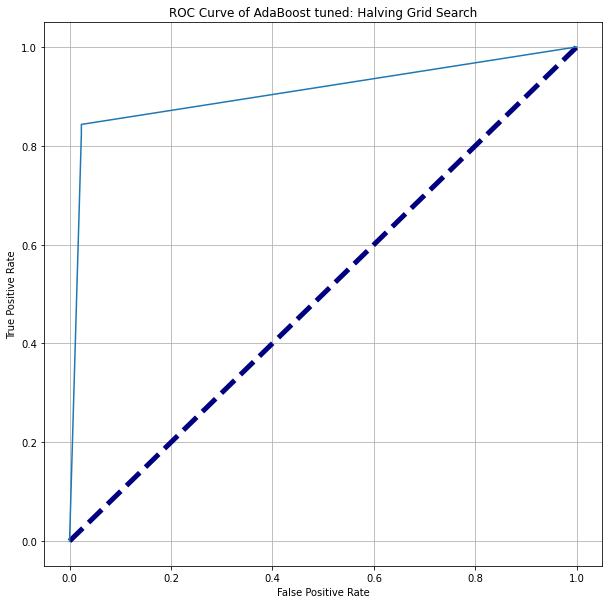

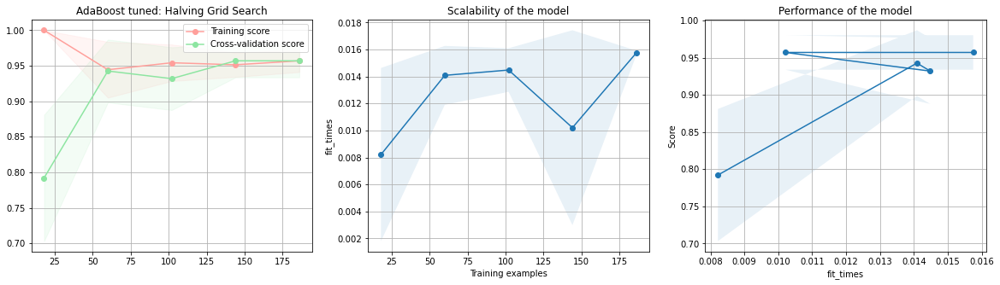

In [464]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best,data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

#### Halving Random Search

In [465]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)


# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial minmax"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [466]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 150
The optimal value of learning_rate is: 0.7


In [467]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_minmax'][0], data_list['poly_minmax'][2]) 

AdaBoostClassifier(learning_rate=0.7, n_estimators=150, random_state=42)

AdaBoost tuned: Halving Random Search
Polynomial Min-Max
              precision    recall  f1-score   support

           0       0.87      0.93      0.90        43
           1       0.94      0.88      0.91        51

    accuracy                           0.90        94
   macro avg       0.90      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



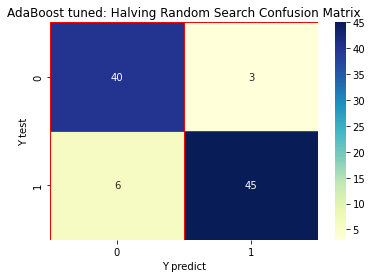

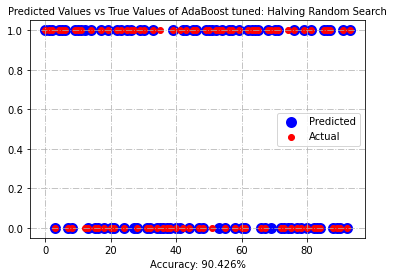

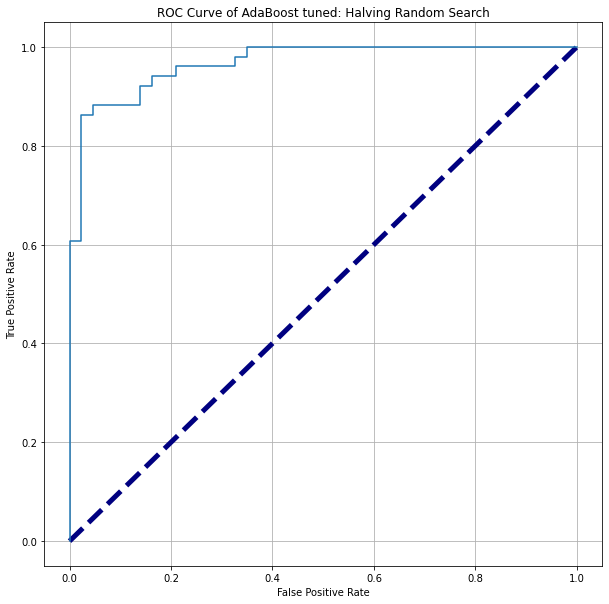

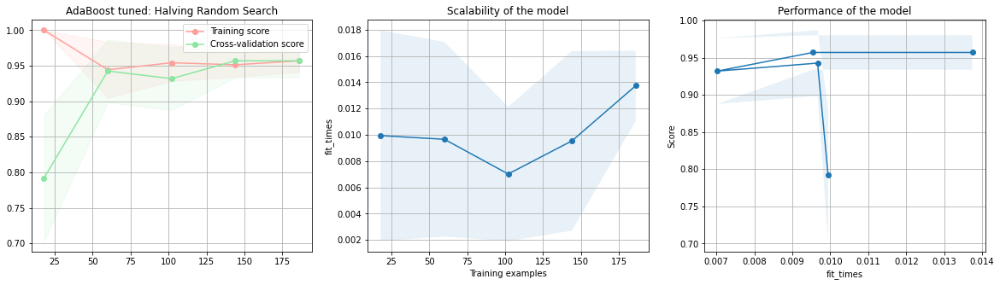

In [468]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['poly_minmax'][0], data_list['poly_minmax'][1], data_list['poly_minmax'][2], data_list['poly_minmax'][3], fc = "Polynomial Min-Max", list_scores = list_scores)

### AdaBoost Classifier with StandardScaler Polynomial Transformation

Boosting Classifier
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



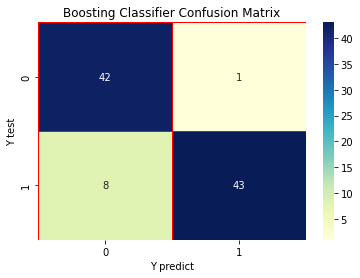

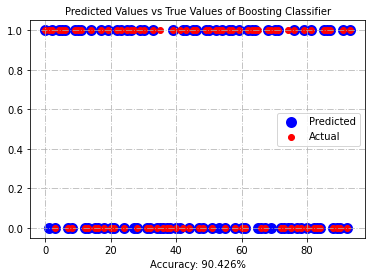

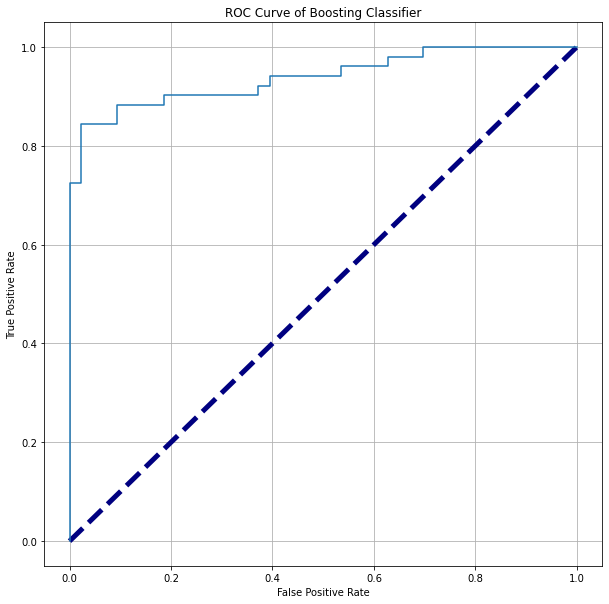

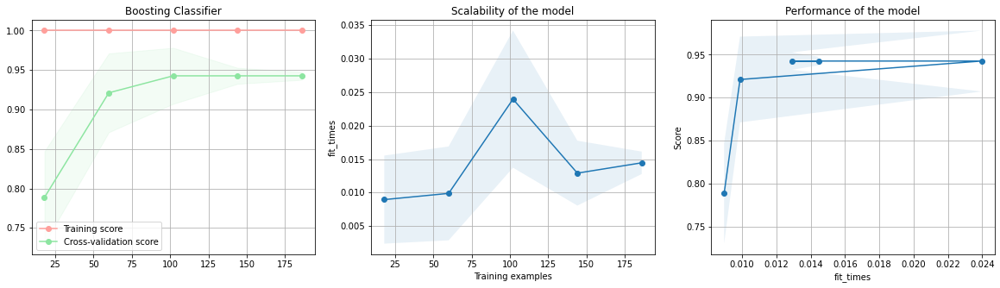

In [469]:
# Base model
boost = AdaBoostClassifier(random_state = rs)

run_model("Boosting Classifier", boost, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Hyperparameter Tuning

#### Grid Search

In [470]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)


# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = GridSearchCV(estimator = boost, param_grid = boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Boostinging: Gridsearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [471]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.001


In [472]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

AdaBoostClassifier(learning_rate=0.001, n_estimators=10, random_state=42)

AdaBoost tuned: Gridsearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



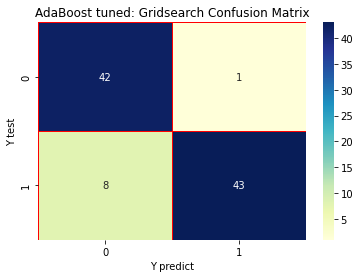

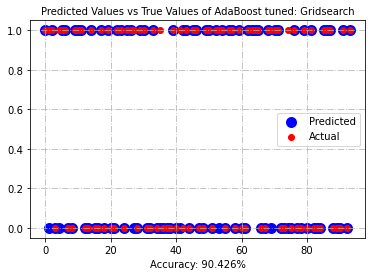

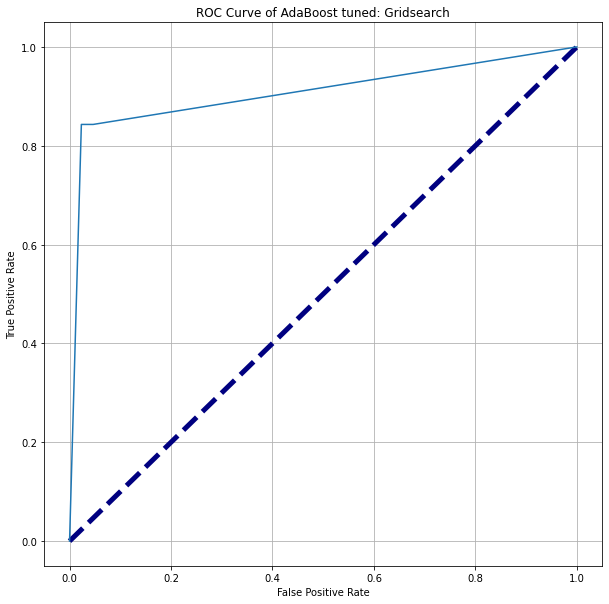

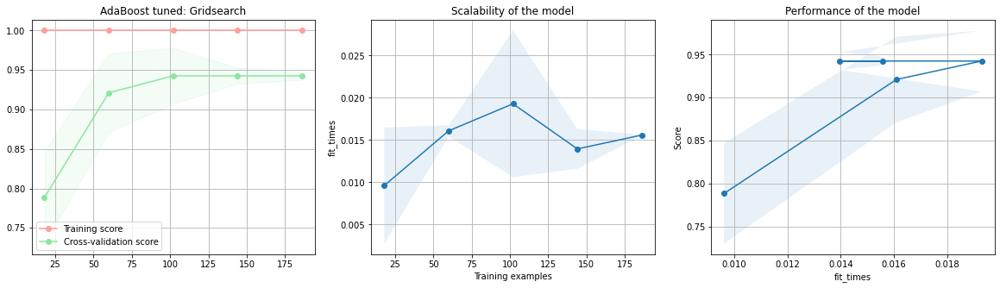

In [473]:
# train and visualize using run_model
run_model("AdaBoost tuned: Gridsearch", boost_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

####  Random Search

In [474]:
# Hyper-parameters tuning
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = RandomizedSearchCV(boost, boost_params, cv = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: RandomizedSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [475]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 10
The optimal value of learning_rate is: 0.005


In [476]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

AdaBoostClassifier(learning_rate=0.005, n_estimators=10, random_state=42)

AdaBoost tuned: RandomizedSearch
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.84      0.98      0.90        43
           1       0.98      0.84      0.91        51

    accuracy                           0.90        94
   macro avg       0.91      0.91      0.90        94
weighted avg       0.91      0.90      0.90        94



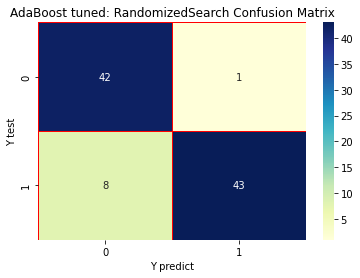

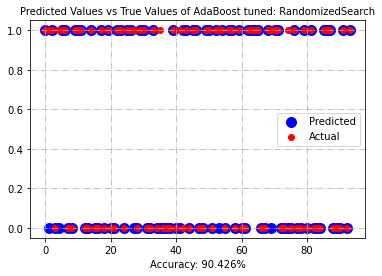

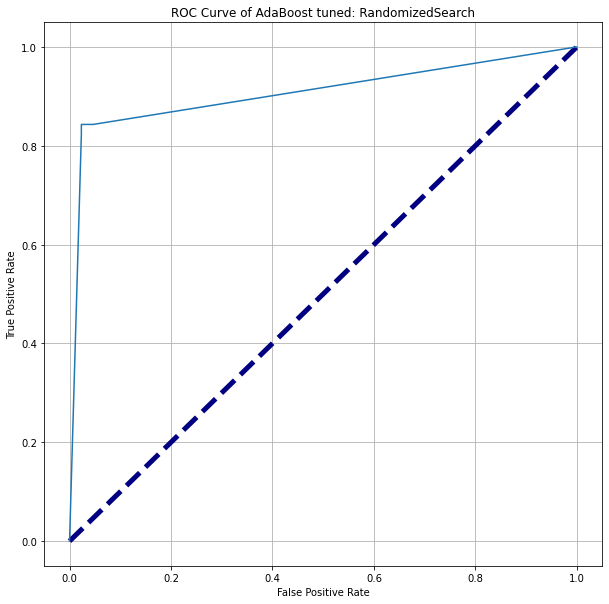

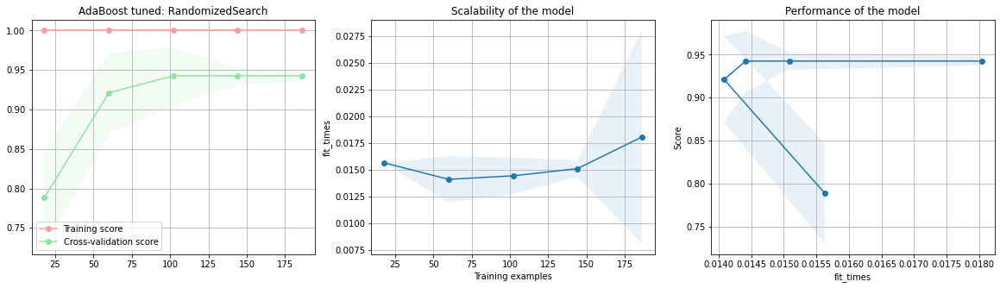

In [477]:
# train and visualize using run_model
run_model("AdaBoost tuned: RandomizedSearch", boost_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Halving Grid Search

In [478]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv = HalvingGridSearchCV(estimator = boost, param_grid = boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingGridSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [479]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 250
The optimal value of learning_rate is: 2


In [480]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])

AdaBoostClassifier(learning_rate=2, n_estimators=250, random_state=42)

AdaBoost tuned: Halving Grid Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.63      0.79      0.70        43
           1       0.78      0.61      0.68        51

    accuracy                           0.69        94
   macro avg       0.70      0.70      0.69        94
weighted avg       0.71      0.69      0.69        94



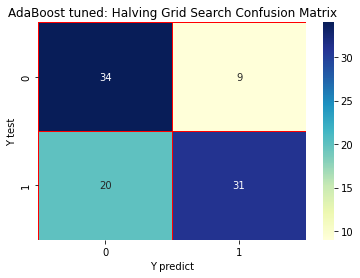

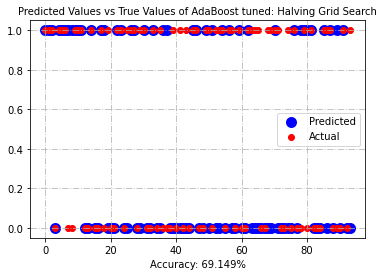

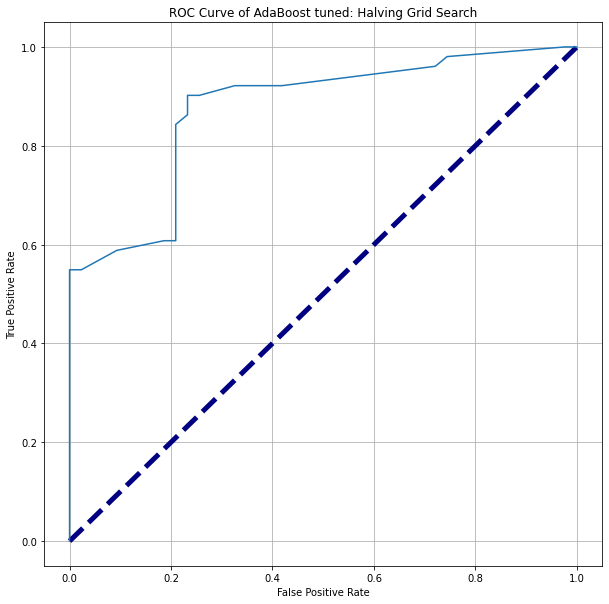

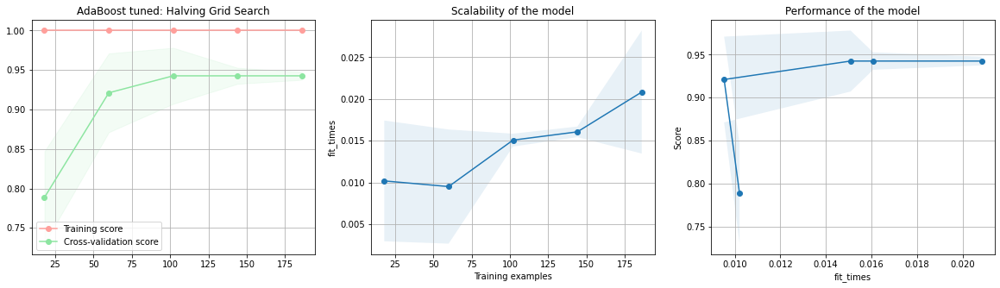

In [481]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Grid Search", boost_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

#### Halving Random Search

In [482]:
# Hyper-parameters tuning 
boost = AdaBoostClassifier(random_state = rs)

# bagging_parameters
boost_params = {'n_estimators' : [10, 20, 30, 40, 50, 100, 150, 200, 250], 'learning_rate' : [0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.9, 1, 1.2, 1.5, 2]}
boostcv =  HalvingRandomSearchCV(boost, boost_params, factor = 3, n_jobs = -1)

# Fit the model
start = time.time()
boostcv.fit(data_list['poly_standard'][0], data_list['poly_standard'][2])
end = time.time() - start

tuning_time["model"] = "Boosting: HalvingRandomSearch CV"
tuning_time["scaling"] = "Polynomial standardscaler"
tuning_time["time"] = end
tune_list.append(tuning_time)

In [483]:
# Print the best parameters
boostcv_best_prm = boostcv.best_params_
print(f'The optimal value of n_estimators is: {boostcv_best_prm["n_estimators"]}')
print(f'The optimal value of learning_rate is: {boostcv_best_prm["learning_rate"]}')

The optimal value of n_estimators is: 250
The optimal value of learning_rate is: 0.1


In [484]:
boost_best = AdaBoostClassifier(n_estimators = boostcv_best_prm["n_estimators"], learning_rate = boostcv_best_prm["learning_rate"],random_state = rs)
boost_best.fit(data_list['poly_standard'][0], data_list['poly_standard'][2]) 

AdaBoostClassifier(learning_rate=0.1, n_estimators=250, random_state=42)

AdaBoost tuned: Halving Random Search
Polynomial StandardScaler
              precision    recall  f1-score   support

           0       0.82      0.98      0.89        43
           1       0.98      0.82      0.89        51

    accuracy                           0.89        94
   macro avg       0.90      0.90      0.89        94
weighted avg       0.91      0.89      0.89        94



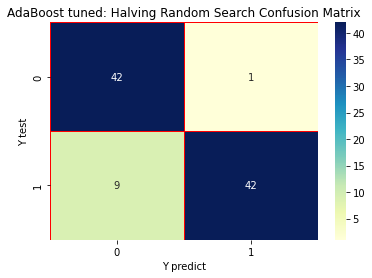

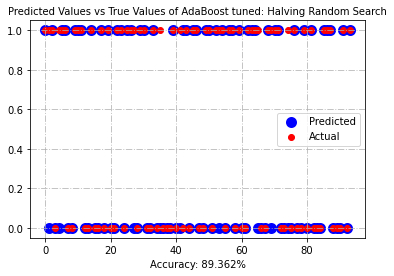

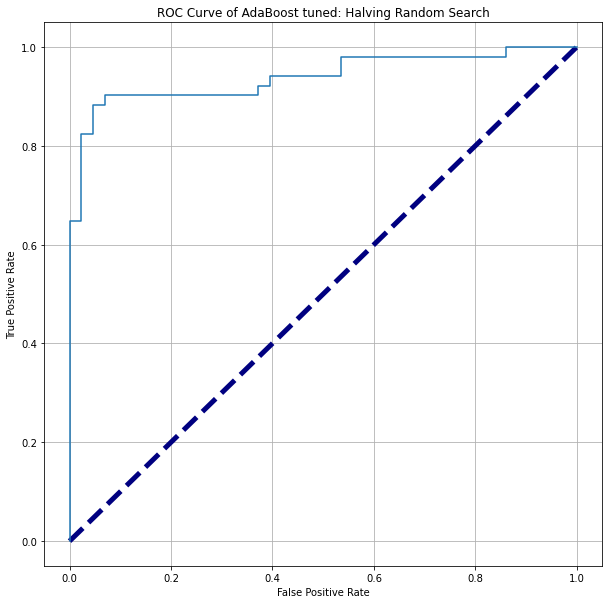

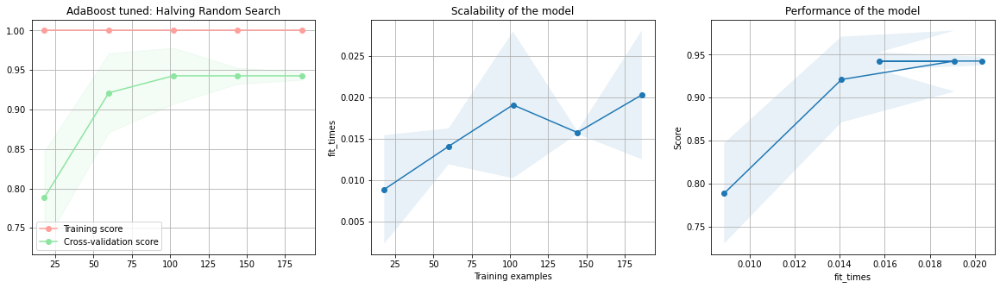

In [485]:
# train and visualize using run_model
run_model("AdaBoost tuned: Halving Random Search", boost_best, data_list['poly_standard'][0], data_list['poly_standard'][1], data_list['poly_standard'][2], data_list['poly_standard'][3], fc = "Polynomial StandardScaler", list_scores = list_scores)

# Model Evaluation

In [486]:
score_df = pd.DataFrame(list_scores)
tuning_df = pd.DataFrame(tune_list)

In [487]:
tuning_df

,model,scaling,time
0,logistic Regression: Gridsearch CV,None,22.344469
1,logistic Regression: RandomizedSearch CV,None,0.242023
2,logistic Regression: HalvingGridSearch CV,None,15.356571
3,logistic Regression: HalvingRandomSearch CV,None,0.863813
4,logistic Regression: Gridsearch CV,Min-Max Scaler,5.260493
...,...,...,...
85,Boosting: HalvingRandomSearch CV,Polynomial standardscaler,6.180614
86,Boosting: HalvingRandomSearch CV,Polynomial standardscaler,6.180614
87,Boosting: HalvingRandomSearch CV,Polynomial standardscaler,6.180614
88,Boosting: HalvingRandomSearch CV,Polynomial standardscaler,6.180614


#### Checking the mest model based on the F score

In [488]:
score_df.loc[score_df['F1'] == score_df['F1'].max()]

,Model Name,Feature Scaling,Accuracy,Recall,Precision,F1,training time (ms)
78,Random Forest Classifier,none,0.925532,0.882353,0.978261,0.927835,203.883886
80,Random Forest Classifier,Min-Max Scaler,0.925532,0.882353,0.978261,0.927835,125.007629
82,Random Forest Classifier,Standard Scaler,0.925532,0.882353,0.978261,0.927835,168.195486
105,Boosting Classifier,Polynomial,0.925532,0.882353,0.978261,0.927835,283.435583


* We can observe that both random forest and Adaboost (with polynomial transformation) have same F1
* Randaom forest takes less time to train compared to adaboost
* Thus random forest is considered the best model

In [489]:
main_dir = os.getcwd()
randomforest_none = pickle.load(open(os.path.join(main_dir, 'models\\Random Forest Classifier none.pkl'), 'rb'))

The features in Blue reduces the Expected value, while the features in Red increases the prediction value from the expected value.

The magnitude with which the features shift the output is the lenght of the arrows reperesenting features.
